<a href="https://colab.research.google.com/github/mparvezrashid/ECE542-project-F/blob/main/GloVe_RF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import os
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
import re
from bs4 import BeautifulSoup
import string
from gensim.models import Word2Vec
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from keras.preprocessing import sequence, text
from keras.models import Sequential
from keras.layers import Dense, Dropout, Embedding, LSTM, Bidirectional, BatchNormalization, Activation
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from keras import metrics
import matplotlib.pyplot as plt
from collections import Counter
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from sklearn.feature_extraction.text import TfidfVectorizer

C:\Users\André Motta\AppData\Roaming\Python\Python37\site-packages\gensim\similarities\__init__.py:15: UserWarning: The gensim.similarities.levenshtein submodule is disabled, because the optional Levenshtein package <https://pypi.org/project/python-Levenshtein/> is unavailable. Install Levenhstein (e.g. `pip install python-Levenshtein`) to suppress this warning.
  warnings.warn(msg)


In [2]:
def plot_history(history):
	  # plot loss
    plt.title('Loss')
    plt.plot(history.history['loss'], color='blue', label='train')
    plt.plot(history.history['val_loss'], color='red', label='test')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'])
    plt.show()

    plt.title('Accuracy')
    plt.plot(history.history['accuracy'], color='blue', label='train')
    plt.plot(history.history['val_accuracy'], color='red', label='test')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'])
    plt.show()

In [3]:
df = pd.read_csv('C3_anonymized.csv', delimiter=',', usecols=['comment_text','constructive_binary'])

In [4]:

def text_clean(review):
    rv_text = BeautifulSoup(review, 'html.parser').get_text()
    rv_text = re.sub('[^a-zA-Z]', ' ', rv_text)
    rv_text = rv_text.strip()
    return rv_text

In [5]:
clean_comments = df.apply(lambda x: text_clean(x['comment_text']),axis=1)

C:\ProgramData\Anaconda3\lib\site-packages\bs4\__init__.py:335: UserWarning: "https://wikileaks.org/podesta-emails/emailid/7452#efmAAAAAv" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup
C:\ProgramData\Anaconda3\lib\site-packages\bs4\__init__.py:335: UserWarning: "https://youtu.be/AlT3NRQqm-4" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  ' that document to Beautiful Soup.' % decoded_markup


In [6]:
tk = text.Tokenizer(num_words=20000)
tk.fit_on_texts(clean_comments.tolist())
X = tk.texts_to_sequences(clean_comments)
allX = sequence.pad_sequences(X, maxlen=150)
ally = LabelEncoder().fit_transform(df['constructive_binary'])

Class=1, n=6516 (54.300%)
Class=0, n=5484 (45.700%)


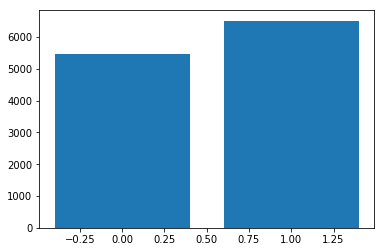

In [7]:

counter = Counter(ally)

for k,v in counter.items():
	per = v / len(ally) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))

plt.bar(counter.keys(), counter.values())
plt.show()

Class=0, n=6000 (50.000%)
Class=1, n=6000 (50.000%)


C:\Users\André Motta\AppData\Roaming\Python\Python37\site-packages\imblearn\utils\_validation.py:591: FutureWarning: Pass sampling_strategy={1: 6000} as keyword args. From version 0.9 passing these as positional arguments will result in an error
  FutureWarning,


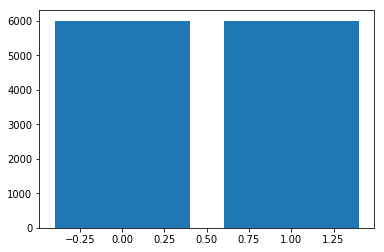

In [8]:
oversample = SMOTE(sampling_strategy={0:6000})
#oversample = SMOTE()
allX, ally = oversample.fit_resample(allX, ally)

under = RandomUnderSampler({1:6000})
allX, ally = under.fit_resample(allX, ally)
# summarize distribution
counter = Counter(ally)
#print(counter)
for k,v in counter.items():
	per = v / len(ally) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))
# plot the distribution
plt.bar(counter.keys(), counter.values())
plt.show()

In [9]:
word_index = tk.word_index
glv_embed_dict = {}
glv = open('../glove.6B/glove.6B.300d.txt',encoding="utf8")
for line in glv:
    v = line.split()
    word = v[0]
    try:
        vector = np.asarray(v[1:], dtype='float32')
    except:
        pass
    glv_embed_dict[word] = vector
glv.close()

In [10]:
word_embd = np.zeros((len(word_index) + 1, 300))
for word, i in word_index.items():
    embed_vector = glv_embed_dict.get(word)
    if embed_vector is not None:
        word_embd[i] = embed_vector

In [11]:
X_train, X_test, y_train, y_test = train_test_split(allX, ally,stratify=ally,test_size=0.25)

y_train = LabelEncoder().fit_transform(y_train)
y_test = LabelEncoder().fit_transform(y_test)

In [12]:
def get_matrix(comments):
  matrix=np.zeros([9000,150,300], dtype="float32")
  for i,cmnt in enumerate(comments):
    for j,wrd in enumerate(cmnt):
      #print(wrd)
      matrix[i][j]=word_embd[wrd]
  return matrix  

In [13]:
X_tr= get_matrix(X_train)


13
7
1066
4
12667
1353
219
257
16716
8
9
6
220
129
233
2
50
41
106
167
23
817
116
466
6
2095
3
314
462
106
646
32
12
186
10
276
54
188
12
709
1599
3165
106
135
167
23
177
7
813
490
3
956
106
416
1
282
2
219
1
903
320
2
401
3
1723
813
879
19
10
1
5579
4
1
197
706
94
1082
2
17
5
490
18
14
197
3
83
6
796
9
2
65
8
12
32
334
13
893
2
50
73
36
24
43
55
68
5
506
340
213
2
2425
2
9741
251
647
3651
1469
697
12326
6308
376
2346
4
78
959
288
38
12
2771
7
907
376
1255
3
237
71
2861
1189
7
267
10
334
34
8488
300
99
8
47
16
217
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
5
1979
4
2031
2072
19
5
7968
7969
11
7296
858
21
1164
2
61
7970
292
250
23
61
18433
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

166
1
3551
561
1
733
4
3551
259
1
92
34
169
597
6
2
271
1612
27
2434
3
792
343
27
453
9815
1849
170
2
1180
20
152
141
2
386
1195
27
2498
502
3160
251
4855
8031
597
73
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
195
16
5
1362
189
7
1638
76
10
343
11
277
22
366
164
74
1496
3301
689
1190
76
32
28
35
1666
3
1114
352
2
143
18
35
9399
2
125
44
578
44
3
82
2
5
378
1716
34
6
5
3261
12333
146
2326
2
1004
1504
1190
939
382
11
318
1015
60
3
1
4718
226
211
1
1190
1435
35
10
161
2371
1435
3
28
35
443
2
3521
295
289
11
606
1
4718
8
146
31
1
1285
7
360
42
1687
289
3
42
352
74
1496
101
15
689
1190
25
1
179
101
689
2
1694
5
100
3210
1125
1190
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
407
4
3965
5523
1771
5
1019
512
0
0
0
0
0
0
0
0
0
0
0
0
0
0

14831
4
1
239
536
1
11566
847
625
16437
20
3760
401
29
1
2650
706
120
1
239
279
23
206
219
1
2724
25
35
33
1
2358
10
562
44
4694
9767
59
15
70
3600
5
766
62
2840
12
2736
1531
10
71
847
625
140
367
69
1158
34
47
200
107
9
35
48
3722
36
9
1571
23
10
1
672
4
44
2626
25
9
59
132
1753
1
248
4359
10
8285
1
3274
190
1
239
12
3977
58
47
28
200
107
9
35
260
1
239
12
512
3
1149
13
473
7
11703
19
28
12
95
182
2
174
10
1
7194
4
31
190
304
82
10475
1
3000
74
1445
6
14
6
787
733
7
10893
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
152
1922
66
23
117
1758
346
64
1
149
1758
3
49
149
13
15
5537
5890
7
157
20
122
603
3
603
1922
117
218
49
1758
3
49
149
796
49
149
190
1758
6
15
1
613
3
55
7425
8
1
2805
4
6
3068
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
469
4433
8
280
12
5033
3241
166
153
12
1872
172
3
1035
1
5033
8
11
17
202
795
1295
2467
1872
172
3
1035
25
16693
48
7420
777
179
84
56
4
1570
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
74
793
2
5
457
5136
22
39
18
1
547
115
42
540
35
5915
2478
32
6
173
7
52
1
688
140
113
15
2043
117
16
625
55
15
3909
24
59
31
16
1477
4
58
28
6
7356
77
1509
235
44
9107
3957
28
3295
4
27
411
1
800
35
5915
11
3848
3499
100
97
25
54
21
11
277
22
125
112
2
68
74
124
456
28
47
17
2
524
1
2169
352
603
9
2
52
9270
147
1
2407
2
183
786
3
950
4
19955
3
2
16
321
378
15
1746
99
24
47
629
16
5
98
284
63
1
834
9271
8
24
13
258
892
19956
801
72
49
7
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
46
46
1291
72
49
33
38
7
376
233
52
923
62
167
23
252
45
1
545
3
134
26
20
13
867
57
9
202
2
1
451
20
17
2140
52
7
1
180
544
3
13
73
214
9
593
1986
32
12
232
74
14974
3049
6
95
175
189
3
56
4
1
98
11
117
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
34
4
37
12
279
3
0
110
259
12
30
8
279
18
47
1134
1034
653
41
51
20
299
42
5423
470
3
5612
74
72
14
545
1859
257
112
310
604
148
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


25
71
136
180
504
334
561
14
2445
26
17
2
2956
5
8260
8709
2884
19
5
441
4
65
26
16
8539
19
5
548
4
31
14
99
1
2536
349
26
5050
3
16
321
72
13243
4
1
954
26
46
517
16
2284
3
693
22
9
26
16
1455
5007
133
1456
3
436
1
1034
4
320
22
5
864
7
865
2
1
105
9
35
7
1
12
561
1579
3105
238
3088
1154
1
4186
1320
154
21
43
22
61
16854
76
851
21
66
23
102
9
430
6
45
2
984
21
54
48
56
4
401
1517
57
9
113
22
1
2717
4
5
100
461
441
4
1559
3441
40
61
98
26
199
54
1
556
4
5
2869
13300
3691
3
21
107
32
21
290
31
1082
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1092
115
3
484
21
10
10932
61
713
41
90
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

2
110
1
345
8
1676
342
2
2062
5
244
49
2
400
1009
3
129
600
63
99
73
816
13
12495
2
27
567
644
1
1160
392
1
777
1723
4
27
956
901
11
535
25
99
20
282
1
1
2690
447
13
549
33
71
75
1744
1489
1045
25
15
6409
590
407
4
312
3
15
312
42
1
118
69
25
149
6
95
784
18
5
961
2
1
2155
525
5195
14
908
93
57
2740
13
182
33
2736
12
42
3930
32
45
2737
71
3842
6091
2
5696
154
17149
27
145
262
13
7
8248
13
24
15
407
4
214
14
1559
2
1315
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2760
40
7
1246
546
2
383
3
7382
1
1246
4
27
1936
7
214
41
20
3782
1
422
37
258
12
1936
535
32
40
1
18853
542
23
427
138
18854
979
6
96
1
9026
8738
13
227
1
422
3333
2
258
12
350
40
3
21
55
8801
9
60
10
65
350
834
40
13
374
31
96
574
476
1424
4
1
2521
1171
2
65
29
374
42
352
317
868
10
5
737
4
1146
4
733
4
40
73
1
5469
34
17
101
387
27
145
105
27
448
209
854
3835
6
139
139
139
17
552
1
422
37
27
145
293
9
135
6
3652
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
103
1230
4
94
304
2
2889
52
1

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
679
4
94
13
15
986
211
2
261
8093
2
3
723
1
127
344
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
3414
88
6488
7283
13
21
2524
3
58
13
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4168
3486
2848
137
3
2283
577
1
581
86
121
16
31
4
91
198
3
9
343
35
269
11
163
1883
183
25
36
1
221
3
1
2809
17
3477
581
266
233
99
20
218
1113
2
16
1
86
21
13
572
10
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
264
64
5
1502
10
3679
12
1969
1
12345
3
59
22
104
7446
7677
5131
14
782
123
15
169
83
41
1350
60
3
261
61
1210
281
2
798
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
250
23
9
2785
57
578
108
2
50
1
186
10
27
293
464
433
59
16
552
307
3
237
7
5096
1464
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
52
273
59
15
16
342
2
2121
40
34
1501
2
16
5256
1
6518
1143
59
16
2215
252
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
17403
236
164
17403
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3399
111
4
1
2252
380
4
1
4225
632
57
16233
631
46
653
702
4
5009
63
1416
723
1
3672
4
7765
1332
3364
22
1
462
560
1955
624
26
426
2
494
1
462
26
4
94
3
33
1211
12086
46
228
34
10974
7
1
16234
2407
4
245
4
462
598
9
511
46
148
63
14
968
10107
11
103
5528
106
43
23
261
2940
1
3282
1952
340
5303
2
188
13
60
234
82
7
1
6675
4
1
1431
4
766
5303
1535
1872
1890
3037
3
1454
1646
218
2631
340
2098
1074
57
20
85
10632
1
144
17
410
156
25
1647
234
20
335
7
645
794
12
3614
2
1
1897
257
188
12
968
466
1212
2
9911
432
372
16117
4401
977
8056
947

2756
270
1
545
563
487
393
3811
10
1
389
1659
519
670
527
4
1
1856
2311
1074
2
1254
4
153
12
10736
618
985
18
2692
1061
1762
4
521
3562
4
1
5732
673
2909
2103
4
255
347
4024
22
775
11
66
23
668
1172
3823
25
80
31
390
2
111
502
93
640
2
237
39
710
56
2
7914
943
20
377
4557
300
4278
87
235
2
1
1294
20
43
46
517
110
5
6259
330
5
178
1037
3
5
1037
20
237
7
27
145
2747
1
850
600
7
348
6
132
8148
2
1
207
120
2104
4219
337
9
35
935
2
7435
178
510
2
1
934
86
534
1308
20
206
279
23
81
9
35
216
1
934
12
17
46
1826
2796
26
42
249
199
10
1460
1
127
6
2128
5
4233
10
1
598
86
1636
24
13
1861
60
22
1
1569
4
9087
7
172
24
117
183
131
3
1
221
542
23
141
2
2762
307
72
816
3474
7220
1
39
19101
4641
82
6284
109
1
9752
258
1
224
887
2762
8088
54
24
31
11654
60
7
14413
1
127
184
6
1873
3
385
10
1169
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

1619
61
514
7
1
2667
3
68
176
662
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
930
1
7475
226
122
57
198
66
23
122
27
105
1749
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
98
258
6
48
5762
4713
311
8598
516
9
12
15
509
53
29
1
75
14
157
3041
22
38
12
2210
350
730
6
79
51
30
67
150
5
921
69
16286
5
658
326
1377
1160
392
456
14
98
167
23
117
1
8503
1
2286
2
88
70
1
1483
4
52
312
5904
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3612
3
1383
31
44
3411
85
216
45
1
126
25
194
3148
65
2
1138
6285
26
16
2167
20
55
454
18
2
161
1555
120
20
43
208
34
167
23
910
27
1196
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
4519
7
6
183
53
47
533
37
480
63
185
1371
319
64
4862
85
95
4561
8
1
2526
10
570
12
7686
101
6808
5444
1
991
126
35
48
19
570
101
9
7
1
3846
1
70
305
95
35
58
224
1
12728
35
206
141
2
16
73
11
103
46
311
25
8
392
4
1866
1618
3
373
33
1
140
1304
1048
1
10876
2285
101
111
10395
2
1
207
8
36
11
767
23
2526
18
500
11
55
225
50
41
19
5
1307
389
2
74
12729
24
3

5
3529
6995
606
111
8
42
5
1934
4
5
2211
4
53
4
1
340
1426
347
1254
3071
51
35
5
1426
923
34
70
6088
29
18
824
57
895
2734
85
1616
255
147
3
231
2
50
22
1
2824
1860
36
312
104
720
136
15
306
2
16
16301
767
23
111
14
746
1
6099
4
1
4768
4
775
8
6
7
38
15
1542
2
4464
32
1426
775
136
775
42
78
2059
155
814
27
1254
36
27
673
6
15
2685
5786
625
11
283
5
11150
1256
3
104
512
6
2450
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1193
54
5
508
45
4699
3993
4
1
4002
6860
2005
2
174
10
5
9836
3
1187
9
47
16
2877
2
174
168
580
6300
1
4312
14377
5
363
664
1106
8
9
173
313
101
342
2
1871
1
363
4
11945
166
1
363
4
6063
10
2374
5480
3
3286
19044
1
3025
970
764
19
1
313
10279
6728
14
3025
35
10280
15
5
6728
1384
1
10279
2570
25
5
534
6728
313
7259
2
1
19045
7
48
1285

6418
8280
3
12277
11360
795
1
127
5712
132
1
1024
4
19
24
247
7936
1400
4
14852
3
4717
10
5583
24
247
406
5519
8555
317
5712
5
506
3734
4
8765
10541
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
17
173
9
192
8
39
6
10134
52
98
36
1
2015
7
44
86
101
72
3416
20
47
10846
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
442
84
319
208
123
14
566
14273
5928
3691
9
30
16651
72
718
972
45
1
1432
1558
1526
4
1353
5
2353
8
235
30
275
994
382
49
2045
63
9
35
138
7
295
289
154
11
50
15
1066
9016
1
7222
2
3758
13
9343
3
32
5
914
8
35
71
3757
6
397
760
74
2196
8766
101
2
1004
49
16640
192
9
35
159
3364
18
1
737
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
691
4924
1
469
43
630
161
505
37
80
281
772
39
2388
5
1293
4
2073
137
1311
215
3623
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
177
317
5005
3796
10
31
637
1600
46
4384
22
1312
926
2
3585
5
3049
1
165
47
1608
706
7
77
974
15
1
341
6914
262
34
134
458
27
145
25
20
13
15
397
2
2891
1
1609
1281
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3804
3804
3804
1239
60
3
4240
1
4113
1050
346
8
1908
4
94
169
8438
3230
12
429
144
190

780
91
8
135
2086
1
1505
4
69
20
85
1268
37
256
14
98
38
9
3333
2
64
3
18
144
3024
2
322
5
1227
822
203
34
6
13480
57
21
17
241
2878
2
2738
31
4345
37
1
17535
12
667
18
1159
1334
190
304
206
210
1
3025
38
6
7
10
5
100
160
3
4346
84
22
14
541
4
2011
3128
3
968
2610
37
241
872
4
31
491
7
32
11381
65
2
108
2
260
7
14
98
8680
1956
3
15
22
1085
38
7167
238
9
2238
13677
19
1
1189
4
1043
78
6
11382
906
50
64
215
5
205
49
449
2693
2
2129
3
210
1
596
26
1016
10
1494
1865
51
26
16
638
2
116
19
5
551
4
130
373
34
3251
650
7801
2
13678
116
106
30
2
1140
2899
4
5728
22
1
3749
8
700
3373
116
41
180
106
30
67
625
8
17805
2
153
13679
1887
2
759
153
13
9857
46
49
13680
4
153
88
6
15
48
3159
9
6
5
87
3230
6
1
4050
732
106
473
13681
37
83
106
30
2
346
32
9
739
2
16
161
3053
29
6115
29
82
624
3749
3036
1759
1049
18
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
302
28
167

3044
1725
599
45
1
3548
7
1
1091
1
2242
24
19
94
367
60
2
1
157
24
117
2
386
1
2320
18
16552
1
148
16625
259
22
52
962
7
52
2747
572
3510
3
1724
9
31
555
307
3740
1608
231
50
11
108
9
2
288
2295
46
25
856
68
599
45
1
3908
3
58
8
26
143
41
24
1723
2751
2
52
285
154
317
1
15801
454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
774
313
6
1
186
967
315
200
101
3
26
17
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
241
477
173
156
216
45
8315
1822
1484
82
36
358
39
3
1
8902
184
411
2422
2
1639
9
109
183
294
21
17
2
470
36
31
13
4820
7
1
945
57
20
43
23
82
210
3
7503
5
633
2129
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
146
1392
84
4
39
24
3875
1315
5
187
283
93
430
26
202
10738
636
211
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
68
5
17208
5
3195
5
17153
3
269
5
205
3
99
159
111
107
32
621
21
108
2
147
9658
2195
1934
1
1801
370
11
163
97
2323
99
21
21
43
147
32
21
54
11
26
201
6571
9
7
74
105
159
111
107
58
21
110
56
146
21
101
1459
2088
42
21
3
1
310
232
2
21
304
27
514
17408
168
37
5
1893
7
1
99
327
64
32
621
21
108
2
147
41
32
35
61
207
203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
904
2
210
235
31
80
281
3
102
58
1
843
3800
195
17
67
7974
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
281
18
14
434
1789
2
4152
1
15015
4
32
1
469
1017
14
124
101
187
2
50
22
1
965
3
387
2
50
22
439
3
1053
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
115
6
1001
802
79
66
23
21
673
5
1555
3
630
45
9
368
4
14508
747
5
1025
4
10363
198
2
1226
5
207
166
71
137
40
8
2430
1156
1880
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
21
13
341
21
17
67
1150
2
177
7
198
8
542
23
312
61
373
6
73
6426
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


5090
5105
5
4603
4
334
1636
99
21
815
1
1586
2123
88
30
16187
1603
2
396
8656
2
2131
27
3094
569
1365
11
696
1249
2
102
161
243
1
1158
24
152
31
3701
1393
1281
2123
2201
159
12
31
50
156
41
8
24
43
1389
1
1380
4
1586
88
171
69
11
4118
250
23
206
5
4367
1669
136
1
4367
4
1
975
24
13
836
10
3
4
268
124
39
138
7
13
21
4138
170
10
53
4
91
661
1242
8
26
650
60
343
1
205
220
4242
13
5197
56
358
39
95
5
255
3783
6
105
170
1
663
4
447
22
44
988
77
4
88
1113
2
5992
37
44
2206
3
3792
8214
3
4
268
44
70
5305
3
224
265
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1639
6
1284
7
292
25
11
43
23
479
72
272
245
1712
33
304
7018
933
5277
120
1
520
1734
6
2
3387
1
3047
4
5
5846
1038
53
18
53
2320
22
1
8050
13286
120
1
326
213
99
122
18
2
327
2647
8568
7
65
7
1
1485
4
8110
21
17
2
124
130
1572
29
1
144
13
141
2
139
307
61
1165
2606
8
12
15797
4
97
4
32
28
113
1211
2511
279
23
7216
503
19
245
4
462
598
3
1411
3527
279
23
1581
503
2
95
358
39
12
8786
66
23
1414
366
1
144
542
23
141
2
556
60
4215
9497
232
1839
2
21
82

713
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1304
137
8531
1
1321
11
1927
723
11
50
15
331
65
206
11
470
36
665
7
8
3620
13
269
31
4378
3
2433
2
210
22
7993
32
164
1017
6
9438
625
241
83
6
216
3
8392
22
44
1077
45
58
4331
931
47
876
1608
387
150
19
57
28
351
178
9
5068
9
9
12
53
4
1
70
583
2
261
9
56
4
1
962
4
52
433
83
12
1077
13
1054
3
2715
24
31
107
8
4607
3
4569
3
2168
13
31
777
3
3550
3
257
24
132
31
107
8
1756
4
2
191
5982
68
27
962
18
1756
4
4607
3
4569
3
2168
79
47
931
16
72
303
707
164
12
1814
3328
8
83
6
44
345
22
1054
1077
6
1217
625
3
257
1
89
15337
1509
876
81
106
6
216
4481
5
217
478
4
3157
3240
761
43
1911
428
104
145
3280
3
15
16
6637
2
33
1
5302
18
379
824
36
8
85
15
41
24
47
436
17
5
2337
31
1
105
109
1
3369
76
8
47
16
49
4446
37

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
7
0
47
0
3
152
141
72
61
114
11
107
318
179
2636
15965
858
26
1522
28
64
5881
26
4
574
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
57
26
31
4
14
934
1997
271
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
154
1
621
155
16
312
1
328
10
338
7
5
1320
92
6
97
49
397
4927
63
9
6
356
9884
142
465
17
67
1511
33
1
2169
595
22
8948
96
5
100
160
69
8
167
23
333
8
1
2169
1002
23
784
5
244
4
149
82
128
97
149
18
48
197
8
760
49
63
55
510
2
3067
3
33
73
276
195
817
8
49
149
3
49
4218
3002
23
141
2
524
170
1
1320
9114
24
247
31
785
16
20
4
3659
465
29
4
9744
9230
4
52
5335
5181
1252
1155
34
186
7117
1
571
3
3232
1
186
10269
46
281
654
18
8
115
756
11
10

850
3723
10
2146
114
2733
12
1149
3
1788
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
534
112
12
79
19
180
19
11
43
327
258
1183
13
1666
37
189
53
82
33
27
15
2
219
1521
583
624
193
1272
3667
2
1608
447
20
13
1666
1436
995
31
7715
710
3773
201
16
626
46
1332
22
1459
2262
381
896
969
815
6
148
63
1875
9530
270
41
8
12
32
21
68
73
1
350
280
4
258
13
5
180
303
13220
37
1
350
280
259
57
11
35
350
11
624
5
1025
4
1882
55
138
37
92
212
3623
20
47
17
6702
3
123
3136
7
5
105
14
350
2349
47
54
682
43
23
17
9
218
583
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
236
164
135
745
1
2523
5501
88
7586
18
10
3250
1776
541
15293
6
1
186
3954
1844
10
191
5982
191
5982
191
5982
854
685
85
1
755
4
116
4656
29
82
295
289
529
106
646
156
45
293
106
12
608
77
382
8
2523
3
75
3892
400
6454
13
1
613
8
155
16
41
36
1
971
1734
6
359
890
4
474
685
25
80
6454
13
1241
5
1844
10
7814
350
293
34
117
309
1060
962
18
1060
3
15
49
69
772
7
913
4
1096

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
208
7
161
457
872
32
43
256
50
726
38
8
9
377
50
2108
5
340
2676
90
20
43
275
3770
61
454
256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
365
136
241
83
30
67
502
4188
986
41
180
34
50
21
108
2
565
61
98
5
986
34
569
172
235
10745
94
53
166
1
75
29
208
37
1
232
927
34
30
747
5
502
5697
1432
1228
3
2151
1
186
4
94
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
48
522
345
76
84
767
23
1383
211
35
180
128
97
120
78
320
6
17033
6607
6
18
2992
1932
5
1593
3
48
3978
1593
7
74
15121
85
1396
33
209
160
2022
2041
34
3243
85
395
3556
8
85
128
1087
5
191
112
5
957
84
51
1
131
10885
614
2996
2
848
150
19
80
47
336
949
222
11
103
15
226
8
241
4145
12
1221
209
1797
6
1
118
181
7419


145
1997
2625
84
4
4680
773
3
993
401
6
420
211
420
318
20
117
2
122
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4691
26
21
16
1423
2
38
36
119
6
321
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
955
354
4
18514
86
316
558
3
1866
1926
1
1387
4
1
98
8
66
23
206
143
10
5
338
6
5
14094
4
1531
382
186
18515
170
1
18516
19
83
2665
3
44
11690
2850
68
556
2
3874
48
266
13832
14095
839
5163
1457
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
21
7

0
0
0
0
0
0
0
1
1358
38
1829
6
8793
4
9907
1358
719
29
825
12
12830
120
123
20
202
60
22
14
5927
1829
51
6
46
2624
4
1358
38
7
14
98
867
299
7
1
1311
4
1
11008
4
14
8538
2
7533
2471
1
5998
6
2281
56
4
1821
3
7
1
216
267
9
26
4562
5
3299
4058
1
464
7205
34
169
14
13
1531
10
8363
453
20
59
409
690
2
716
71
104
1712
510
18
7005
770
368
4
888
1712
3867
38
6
893
2
4153
1
1063
8402
4
52
326
3867
15
1341
5
4161
10979
22
5
5329
7030
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
437
1
3207
52
229
3
44
4862
1154
18662
891
8
2251
1
638
2
124
166
25
1
843
18663
7
1
1091
30
67
3
1212
2
16
1
4053
5206
854
469
915
37
1
2874
30
5
5851
4
44
145
58
43
53
3526
1
954
25
219
9
5187
18664
135
30
46
490
25
2
5022
2
1458
4442
4287
3
636
28
26
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

118
10
31
2634
7
1
683
57
27
519
31
4
3130
8525
20
26
174
738
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
20
279
23
124
1
105
11
744
41
24
59
261
304
1
118
126
369
20
629
14237
60
3
124
1
105
11
108
113
8
5090
60
1
127
12
466
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
867
3993
101
162
492
3278
25
35
8032
33
44
3202
2
4087
172
3
358
39
30
134
5690
72
492
1060
55
5
1598
10
172
3
401
39
3399
111
4
161
1083
34
12
132
4244
22
1
2552
2574
3
34
4450
1
1111
99
2988
7950
29
6790
462
5695
7
44
1170
10
2229
172
9
279
23
288
90
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
70
53
165
51
30
67
46
1845
4696
1405
432
12372
977
157
251
3841
1649
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
211
5
446
0
251
9
39
612
31
2
10567
1806
666
262
269
36
109
348
106
103
4
1071
5
177
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6489
437
11
4240
161
39
656
427
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
13
21
82
5
162
310
34
6
543
21
2
630
14
29
1293
168
18
9
1
62
1657
697
846
29
6
61
512
55
5
913
10
1
697
846
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5233
8699
14953
7
31
7653
7
14
115
167
23
2027
1
157
8
1
17299
1886
712
6
216
30
1383
842
2071
216
220
1189
6
257
161
15
7
9
10
21
11066
2834
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1897
2
16620
16621
12
3531
5662
2068
3700
2
116
8
255
3116
50
5
464
204
4
317
4315
18
69
10542
91
2711
3855
7
255
673
19
1090
2
7084
5833
45
9
17
631
863
432
372
405
5096
3
16622
2589
384
586
13214
5096
3
12865
16622
17
31
1406
506
13215
10
1937
605
22
7519
29
1944
10545
239
182
1089
1708
4221
3
6387
16623
1108
2260
16623
5
933
8179
7
10515
255
1
13214
4
10337
384
586
4099
6
9786
2770
3

70
13
2176
15
94
25
20
3
31
75
94
3625
2
256
15079
6
2020
3
90
117
161
83
5459
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
84
4
119
59
16
211
89
4
44
779
13
330
5016
1698
3
2731
1042
296
994
17
1409
8
5016
17359
42
5161
1042
6
15
5717
9707
3
11215
123
15
2467
1
5149
1137
8
1848
46
518
4
5
1041
4
5016
82
42
1042
60
2
382
1
5161
4846
48
1851
1137
1184
8
5016
1484
46
1327
2
293
185
7207
5245
8
5006
7
1
1201
5016
3
2731
1275
3
1
2201
33
53
4
80
3590
4
10576
8
6073
10
5
1966
330
13433
1011
3
2731
30
15
67
1858
756
9707
3
11215
12
1761
30
67
12972
3
8025
342
33
2
12965
1
129
45
1
1526
4
11214
5
90
1858
129
364
2589
8
30
67
1409
2
16
363
1221
3
1030
19
5
548
1
129
12
7644
364
475
8
4
1
89
1989
40
6
237
7
8248
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1193
54
1
193
103
6
13828
42
1
609
332
68
91
749
138
7
351
1
1781
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
144
17
7692
5
943
62
8
11666
175
3184
3
5
244
4
129
149
2
1341
65
20
3
38
17
202
3990
1
100
118
2251
18
1519
620
8
224
887
9977
4675
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
31
4
14
96
58
5
8424
6
342
59
16
317
5
3682
104
799
19
5
92
213
7298
38
195
1164
2
104
7278
4
95
92
213
34
6
114
711
306
2
1752
21
81
719
6
141
2
1

78
1912
3
42
1
118
69
1849
2440
3
14614
982
1663
4664
40
14
6
5
528
8
43
5472
1153
52
637
1788
19
90
19
1243
7
156
49
63
1324
14
212
2
52
12118
368
4
1667
9
120
9
3333
3415
2
31
34
546
39
7
112
6
61
3167
11
302
52
293
542
23
1
590
8
26
17
2
174
6697
10
61
2647
1220
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
178
6
5
178
6
5
178
362
2069
52
2981
52
16038
3
17385
52
1464
5
178
18
362
88
6
332
3870
2
906
6
15
13440
7
104
1016
9
26
17
187
29
46
1016
18
554
1261
13440
178
47
16
49
5557
2996
2
4607
29
4569
120
104
1016
47
16
679
1142
3
1269
29
5700
2139
172
927
3
104
1007
1804
54
2912
5
554
178
6
1558
337
56
2848
5128
3
26
477
15
1016
255
147
395
8
38
6
332
5
1708
3191
4
710
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
470
3

100
187
664
3
2928
1112
791
4
2912
88
135
13
952
10
1
3880
139
2
1532
291
100
187
724
3
1647
791
4
1006
1609
3
16075
5417
2857
19
97
1011
19
580
15
1065
3
43
110
21
33
11380
61
29
5117
21
109
1006
1186
36
21
17
5
1471
1006
68
61
2084
1993
170
19
1597
19
580
146
5
6060
46
1
2084
1993
6
893
2
122
60
87
146
5
6060
2
68
2084
2
1
2735
1369
3902
61
2084
1993
128
636
26
110
9
504
1
663
555
18
3
18
4
216
868
2915
5358
168
175
189
88
511
1141
18
104
514
5
205
84
983
6328
19
20
136
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
30
1451
11730
503
41
1597
8
1
127
30
654
125
2
10665
18
1
2587
4
348
12
14071
90
11
535
4884
50
2910
3
11
81
36
14
1
345
71
950
4
653
1993
195
4
11852
1
127
2
680
14
5799
1656
2
17
5
326
2794
29
19
22
1
681
60
9281
16214
1982
1
275
5
8202
7
2866
759
36
8
12
1
345
51
6
46
3669
4
1507
248
933
140
2882
11
66
23
108
2
102
53
112
9
12187
61
1207
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
636
19
11
102
3414
3
3522
1113
7
72
4
80
2153
74
1237
2394
168
10
31
11
107
51
225
17
67
183
2416
3
11586
25
11
43
23
10062
61
3799
10063
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
17
134
101
19
187
833
7
1
140
3
7
52
492
19
11
1197
17
3
11
247
67
259
10
5
160
69
84
11
226
19
1638
17
228
1929
7
38
12
492
22
83
1441
7
1380
1
297
13
55
3391
4
1
334
25
52
140
2430
56
51
2
3218
809
3
5800
17
275
215
4
1
165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
240
1
16007
4
38
5074
18
120
21
13
7
1533
1
3460
6
53
4
2751
3
4927
42
1
2572
4
1
285
3
1
5004
4
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
148
305
6
120
6
1252
313
4637
2
322
10
967
59
774
16
631
2433
2
10
53
328
29
161
1343
56
1
15446
457
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2627
1108
119
296
36
24
1903
685
1
117
10
6565
26
122
307
76
1045
26
3350
170
109
5
49
1284
5896
567
59
1253
1045
1489
95
1
1923
1623
6679
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
7436
181
6
14
82
36
74
71
7835
38
12
1984
6
88
1708
4
1512
332
6
691
156
26
17
1064
7
1
92
1
942
6333
3
24
107
34
20
13
26
158
16
3076
1736
15824
437
1394
183
26
17
1064
7
1
92
94
26
16
3770
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

112
11
535
11
59
230
5
15046
2875
18
309
140
22
40
8
246
23
501
74
779
41
11
43
283
2837
3
7345
3549
4
268
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
582
2
665
7
761
854
408
6
787
5
3682
3
338
54
20
13
4764
692
3
1518
464
132
387
112
6
1224
76
4
2981
270
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
55
5
337
52
955
213
30
67
7656
2355
3
13066
3
4115
1
40
12
1292
1523
306
2
876
4171
71
713
37
44
6385
279
23
143
128
90
427
138
4213
13252
447
13
1
4058
225
9
16
580
192
31
1
5249
6
14913
3
10187
5157
13
12895
8
28
225
81
707
45
5
1641
7
1
5249
11
333
32
12
176
10
125
135
2671
427
352
2
9180
5
12305
2509
8963
1050
26
28
629
594
3
17136
307
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1128
624
11
5472
18
1455
2133
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
930
51
1113
2
16
5
244
4
1085
1000
8986
40
7
38
93
2
102
21
848
117
61
145
11057
3
5
7366
3558
2588
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
202
18
40
50
15
124
10
2324
495
45
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
8619
55
1616
273
76
1
6458
47
15
757
170
5
957
4
576
3182


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
9
12
41
1223
21
174
10
1
147
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
14
1314
5
5082
1
144
155
17
2
5100
125
19
213
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
114
711
8478
1007
492
1805
120
38
30
218
12921
48
1139
376
233
3
1166
1174
384
2036
3
3366
1
1585
10
78
301
42
14
15679
6
1
92
6
180
49
1792
7
873
4
8234
1027
3
701
4
1
86
467
17
1
4236
29
607
2
2448
11701
14
4058
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
17
410
120
51
6
224
149
2
16
246
7
1262
11195
16100
9
6
54
1356
1332
15
2
853
7
1
1215
686
36
20
13
11195
3
13
5230
3
108
2
2669
29
17
779
10
131
3728
269
9
250
23
31
220
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
77
474
112
675
1
447
18
464
5231
3
10144
20
59
16
1763
2265
73
159
12
68
138
2
1
4178
474
51
167
23
390
2
16
3760
1171
750
18
58
97
9
567
2
576
5
859
7
38
112
13
71
389
12
905
88
1113
2
1286
70
777
2401
131
1700
11479
3791
14
6
53
49
328
10
10144
2
318
1004
1
3330
2
161
289
2
68
5
4178
474
2
16
208
294
12
165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
258
24
13
3275
33
48
4370
272
245
5153
2
194
29
231
50
15
675
114
39
772
10
14
13

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
81
119
250
23
5
1846
28
6
1
100
2029
4
5
1846
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
21
195
16
1
10125
5138
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
120
13
74
281
2403
1670
319
7
17276
1
94
11
17
2693
108
2
16
385
10
1184
60
20
50
156
25
2118
45
58
329
1
143
6
11
68
1230
4
65
3
230
9
8175
57
11
230
5
11204
8
6
3237
10
304
143
304
173
8
70
4
1
11204
449
818
7
14
1948
4
352
169
7
185
84
20
43
454
18
3
238
20
50
139
78
262


8144
7
175
126
234
1
563
487
393
16434
1
105
10
5413
581
3940
76
19
5
548
4
1
393
20
26
73
401
1
2094
109
72
687
1429
3614
39
6
54
5
15398
5543
22
31
4
1
5543
54
8199
10
4510
28
26
50
231
2
2318
238
82
36
9
357
10984
7
5
3089
154
581
280
3
153
6236
2
622
55
726
1
3089
1839
41
630
168
39
42
61
145
6833
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
269
28
6
7956
5732
54
44
1358
104
5
2706
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1219
545
255
147
2339
35
7
11170
1
827
2339
35
7
1802
7
96
9647
3352
942
181
10
27
285
42
14
1802
2339
5
114
2691
19
1
2952
1
92
24
17
227
9
29
71
150
181
11
43
1595
55
32
35
227
867
1
12718
4
1
827
2339
26
16
1008
14
3079
7
12178
4409
3
1
53
232
191
1219
26
16
7
10750
522
8
4
80
4342
1008
259
17330
13
7
574
15

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
46
15050
10
5528
34
4426
2441
546
10
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
151
322
5
9630
652
3
5464
1417
10
21
114
480
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
574
7
77
6294
474
17
1927
1682
45
1
5607
76
9
8341
27
445
529
11
533
1
127
3
344
26
271
852
45
1
5607
42
71
207
5254
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
277
22
1
469
1
2602
491
85
1
355
3
1
639
2
38
20
509


0
0
0
0
0
9
12
10388
2
107
20
85
132
1
89
1770
19412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1158
83
8069
370
210
80
281
99
21
290
102
8
52
1516
6
8
21
152
7
1
87
3
8
52
131
326
2198
225
206
524
1207
2
52
1467
10
1005
473
3902
2440
18
468
30
67
509
3822
818
1
268
1048
1
1105
40
4
268
20
85
2979
375
665
7
91
1119
3637
380
2177
20
85
1
2053
961
3
85
1508
2
50
634
20
8949
20
1940
1
118
105
45
617
665
138
99
8
85
4049
2
2402
9
12
70
1033
8
24
247
1303
8
12332
24
31
9240
7
1986
1146
4
733
4
84
319
3
1412
6313
1
354
4
1
92
24
17
1
118
3688
19
1
1105
40
3
31
75
40
18
1
912
947
4
7108
3
32
24
123
2
1
1105
3131
15
55
7
38
25
31
795
1
92
35
2792
593
418
1167
418
324
418
31
1986
3
1
324
544
604
3
12323
604
3
1434
3
1
1105
3131
4
131
4727
3
1578
24
2908
2514
2
16
2173
4
89
4
52
308
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
1
151
390
2
81
8
276
25
300
6
566
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
437
955
1
87
415
727
20
13
95
8590
12623
3
33
1
4095
55
139
5
199
42
1
3920
170
1167
3
44
13285
3
671
7164
16822
4056
921
2
70
532
56
1
176
46
274
32
5083
3487
21
260
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
238
159
12
1631
49
1729
41
24
43
3138
49
280
10
543
149
10
304
898
11
535
5
2149
551
34
6
5
8431
246
23
4813
19
3940
11
1445
5
244
4
280
47
54
2
1293
60
132
25
11
535
51
26
16
71
407
4
1736
1449
37
1
4123
19
941
11
163
31
10
4331
8431
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


72
189
11
50
296
283
682
10
91
1084
73
8
348
30
2
104
145
4254
6157
2
136
20
246
23
16
3314
1
541
4
6803
56
37
348
8
20
17
3382
9680
2
0
0
0
0
0
0
0
8
12
1741
2
858
8
24
524
7
40
22
695
2955
3
110
65
396
24
1052
23
16
1324
7
40
22
444
1060
3
400
55
76
71
287
1528
43
23
2204
1580
42
1
2155
288
4
1
889
1821
1
845
6
633
55
174
5
1386
889
10
262
57
21
43
23
230
211
40
820
2
143
196
91
1274
80
7491
1528
59
386
543
27
145
105
3
271
3148
1
354
4
64
688
2
2196
1
519
10
27
220
1202
5542
24
13
1
590
176
2
5700
27
1117
3
1068
399
254
57
80
464
543
262
66
23
680
194
2
110
2463
1335
299
1
1528
59
271
338
644
27
357
3
219
71
4
91
224
2338
2
174
5
1386
889
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
339
86
121
17
322
55
45
194
294
19
27
732
3
246
14
126
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
825
12
607
59
16
5
2321
10
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2487
30
201
67
5
4158
4
1
87
3
1
87
30
201
4403
18
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
817
366
8
395
1
193
103
12
8038
287
1379
1
592
21
365
16
2455
26
16
1430
3605
24
43
23
17
8
41
139
5
12362
114
119
1752
176
7
1
951
21
288
22
123
15
390
420
19
1663
5
1752
7
5
951
43
549
1427
300
1332
22
5
7200
1768
17922
1
951
3
359
56
21
1052
23
458
5
1752
7
1
951
22
1
8737
13764
82
7
1
8738
57
11
3455
60
11
81
89
40
748
23
50
8
6

117
2
139
5
1120
2074
3
135
81
45
1
92
20
108
2
260
7
3
1
364
4
14
912
706
5
53
499
515
1918
240
2
16
1
10108
490
1611
1
1290
3
938
1557
3457
5749
17
8015
57
5402
377
2259
292
7
5
3066
3
5207
2116
1
40
34
260
7
8
98
117
2
2164
81
4
1
9861
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
81
8
9
12
1030
2
136
8
1
5504
11
1940
22
1
14607
5909
356
2530
3
1
1726
2217
35
58
146
5
1194
4
1
221
1273
706
109
5
6382
1174
6075
86
53
1173
42
5
69
1
14607
34
3007
187
2
14
131
221
7355
1
789
3
1726
2531
2
1
913
4
1
392
21
14608
18
5
3354
8
21
123
187
2
1838
741
9
155
16
4017
5
3354
10416
33
104
467
9185
300
37
1
86
12
19499
1316
2714
2
5653
61
2217
5
244
4
61
641
283
342
33
61
672
3
7
74
373
5340
41
8
12
120
1
4104
427
37
25
21
436
43
23
102
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
48
3706
90
6186
3
608
9170
373
434
11
1303
183
37
218
1
469
3
1
281
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
2
3027
131
396
3
27
3721
1990
3
2714
8
13
6864
303
37
1
413
1174
94
117
2
409
300
32
20
177
291
60
1
1709
4
14
98
3
32
6
1733
10
3
759
18
52
334
10
15
1875
18
1
2132
3561
3
2629
4
94
2
2956
438
29
614
8
949
1
253
3
90
95
4
31
396
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
201
199
2
1
144
10
1
186
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
4732
70
555
2
545
5383
1255
88
6
79
38
123
15
122
2
573
7
120
30
1
127
184
411
67
234
3104
5289
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
794
6
15
1
70
53
22
71
3072
2
50
366
47
21
370
50
64
31
4
1
129
600
33
473
2803
57
1
193
103
1596
1
667
18
1
632
6195
3
79
35
1
528
182
2
2454
1
508
1
189
146
1
340
126
708
765
22
9430
1826
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
283
41
5611
11
546
10
1
151
3
39
11
1652
259
3
4712
8
20
47
16
186
2
565
38
11
35
8905
216
73
1865
11
3164
2
230
194
2
124
10
11
43
23
7
93
3565
124
10
39
12
8433
4
462
325
3
6912
83
6
6074
3
575
6
461
12998
15004
45
1435
2123
602
1403
6
51
46
53
8
416
2
565
5
217
394
6
51
46
86
8
416
2
10667
635
1181
3077
223
2311
1
1034
4


7
2280
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
50
24
17
2
237
60
22
80
5188
4208
3935
10
1
232
939
84
627
35
321
7
5
462
560
3
43
16
2066
33
1
118
68
96
9
32
6
4208
141
2
630
45
7
939
84
69
36
241
30
4742
7
11020
38
54
44
1100
123
3
627
30
1114
2900
2
1
559
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
626
115
11
277
79
99
113
5166
83
3525
94
17
46
1294
1377
11
230
14
8281
4592
420
3231
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
682
25
11
66
23
102
79
5
1019
2298
254
2
16


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
55
108
1000
1528
2
16
4530
2
1
118
4164
19
951
1528
3938
8391
9587
3
11
81
36
1
819
2915
283
8
21
13
15
1564
2
3291
5
1000
5684
99
11
81
1
2901
59
16
443
2
61
5236
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
5
222
4
9298
1
162
165
6
8
1317
13
41
444
1214
2
2304
567
8
194
43
1104
2
2910
7193
6
4788
8485
3
3661
861
1600
42
31
567
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
55
1
118
19
7
604
3
719
842
140
401
8
12
221
10
21
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
53
181
2
17
5
887
2810
978
311
22
11799
18
78
623
420
161
2
264
5
244
4
12351
2
150
1610
717
952
19
90
234
116
721
1631
4178
495
7
1
15
41
3210
2869
19
1638
1534
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
941
236
164
1921
1178
25
4251
7426
4
137
462
325
9
47
16
329
2
897
194
1124
3911
5
2056
7
41
180
19
137
462
325
3992
2
251
487
1
1034
4
320
48
1139
5251
5
251
620
251
801
813
253
270
41
36
14
394
6
1989
2
1
5253
4
4452
1611
8
24
8548
2
17
31
80
198
11
103
176
2
470
36
1
791
472
15
41
97
37
1
1432
4
1422
80
198
146
5
10497
1048
4452
25
49
37
1
1

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
437
10
1
93
7405
380
192
2222
57
1992
3
1386
1632
4100
64
10919
121
886
231
20
6935
7
7041
1740
12802
37
260
898
746
2
5186
2
350
5279
293
10
27
569
1633
15798
3
2222
12
585
831
250
23
8
28
4576
71
2056
13488
25
8
28
5592
56
1
10920
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
314
3065
1027
43
70
68
1787
1718
175
204
8
43
16
7020
37
662
5
6928
6
73
95
1591
37
38
2
1434
3
604
14
6
15
55
45
2110
740
24
659
1
5077
51
26
15
16
262
10
526
2941
7
2091
4525
320
270
31
91
1441
8249
43
16
227
180
180
49
11822
726
4
38
24
13
15
2533
1315
82
4861
37
14
194
34
808
10
5
588
6101
43
13145
2
1
460
4
14
5662
11
82
107
461
1676
8
2782
839
1201
29
1823
816
2
68
1441
8249
9934
1412
14
472
352
2
9180
2068
200
1469
1561
1403
76
1046
553
110
143
1804
113
15
110
143
10
89
4
80
3923
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

38
36
24
31
1595
61
184
411
1299
358
39
3
199
32
8
335
64
5
98
8
6
2801
10565
3178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1914
4
5
376
233
6
2
3585
5
556
4
844
43
194
925
2
111
55
32
556
4
844
8
1
83
2696
172
233
10
468
6
2071
2
1963
22
83
51
26
16
46
2970
25
257
51
26
16
1009
3
3889
2
1748
2795
468
14
111
18
53
603
51
6
5588
37
2376
25
18
1
75
603
51
26
16
169
10
2376
9
849
2
16
5
233
8
6
31
2709
3
46
1842
11
377
6733
32
14
233
6
893
2
4167
7
637
1334
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
1
127
3
344
406
61
1706
3
58
20
43
68
9
203
237
48
288
2
80
811
1689
3139
39
767
23
31
8
220
14
1673
6
5
516
8
87
109
1
12
960
706
19
11874
4055
3
2344
11
136
6829
2992
8089
85
477
410
19
95
2992
1
523
6
73
3532
97
49
4206
847
33
1
6830


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2247
769
3
2457
9365
13
1316
5148
46
117
2
210
1
505
2
107
104
2793
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6
14
5
1169
30
1
127
67
11667
33
71
12616
34
30
2403
48
656
10
12617
3254
57
26
24
102
1
162
656
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2905
30
1
1957
2
110
1115
439
1
2067
197
4
1
232
126
26
403
6996
82
491
1172
1746
81
14
541
4
7040
6
3532
15790
113
8
110
111
5
3783
11
66
23
252
46
51

35
427
3
689
7
10161
27
309
3
2235
2082
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
90
11
103
15
304
5
6266
187
69
615
163
11
11
81
1
3689
17
246
3
14
16420
111
41
11
409
32
26
1
3689
902
232
32
26
9
139
2
110
1
127
3
344
498
60
2
65
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6
1
127
184
5863
1773
8
22
3642
3134
11504
18
49
63
1044
3
36
97
4
1
1691
4
413
314
1148
2377
6
8
9
6
14835
33
3
10909
8
299
1
288
548
121
16
228
5567
63
7
1
286
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
110
226
21
612
1
1945
4
14
4644
12
313
3196
1602
10
1238
39
11
103
3188
8
24
43
533
1238
2
12197
18
44
727
8
1353
6
10090
504
63
3185
477
7
8
2249
28
290
17
185
1546
18
1443
18
603
774
3
7893
313
2
169
44
1077
7893
709
944
432
372
2843
405
248
315
127
2094
1
313
308
22
944
1728
115
1322
31
3
774
1
2653
15115
432
372
2843
405
248
315
774
313
6458
115
26
16
2958
5
1491
1196
3
34
646
32
294
22
1238
42
27
843
12728
4719
485
3159
799
3116
10
94
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
11
210
1
844
4565
1
144
246
1242
3
41
123
1
151
41
97
10
2464
73
8
1
221
13
2685
2057
33
1
140
1
1069
26
16
18
1
144
3
27
438
55
704
10
9
26
15
594
9
1338
1
40
26
108
2
102
32
550
6
1
137
789
1
144
17
101
467
234
1
151
530
2
172
404
30
689
57
7115
18
27
438
14
69
6
46
303
626
1258
241
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

4
32
28
2430
2086
10
7
1
126
417
4
301
335
10763
1
354
989
32
24
85
7
10
867
28
12
206
504
63
3271
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
164
121
17
608
183
13067
25
123
15
605
22
3
12
2153
116
721
13
90
787
1
363
4
74
193
103
782
3972
159
12
612
31
1
5212
129
600
1096
685
440
1
2120
258
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
30
6443
617
3737
61
184
411
190
39
1
151
47
16
19
1221
19
5
12
7986
18
48
3548
8
1383
9906
8
4
1
2035
12
1
3088
13
1043
5
406
927
9
6
15
27
1288
1
1288
809
558
223
223
6
1
1355
1844
10
943
3
1824
334
2
5805
301
22
27
145
149
190
14994
528
317
19
5
3655
402
2591
17
1014
27
301

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
6
2630
2
2798
3
3443
990
3244
25
3060
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
25
236
164
279
23
21
107
153
66
23
6743
24
17023
11
1785
259
74
355
16995
88
11
201
17
3926
8860
307
7
1
13469
16299
4
74
1173
10
55
150
6496
420
482
11
4927
42
304
2
1363
17024
1
1765
13344
18
74
7659
756
239
30
257
2
4423
5
471
13344
10
12360
4205
236
164
19
21
858
51
12
201
5
5192
6237
2
74
189
3
11
43
937
45
1
8215
2712
4
1674
17024
76
1
8760
17025
4366
2
74
26
110
387
31
148
484
21
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
81
236
164
121
17
1409
5
187
49
2545
10
1
153
778
59
9
659
56
8
27
1349
677
60
5
8039
2611
10
5
505
8
2535
22
5
100
557
32

0
444
61
156
2151
13
14
1345
7644
103
1103
364
2404
1664
429
220
205
44
18
58
162
595
7
20
19
2518
423
152
403
55
569
22
226
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
91
7
1
1320
3665
26
15
54
14
115
3
26
3998
9
19
671
1
70
845
6
2
426
2
5704
980
4
510
109
1
2747
4
1
413
2936
3
27
728
191
18
191
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
13
15
6526
1
1044
13
15
5518
33
52
5146
3
44
2079
583
94
66
23
159
278
50
52
2703
8413
24
66
23
322
3
2027
759
18
64
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
17
67
5
385
5907
2
1
127
10
45
939
651
76
4
104
77
9

6726
42
1
100
249
5
147
6
492
26
14476
348
292
24
332
17
5
87
415
326
782
122
2
1638
193
103
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
2358
6
2542
9
12
1
5566
34
812
1
7921
1562
7
1
142
267
3
70
1340
2
1239
60
57
1
129
16801
42
1
6878
4
257
49
2350
79
66
23
20
383
2
260
558
27
357
708
21
43
23
68
321
190
2878
1
2271
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
185
621
10
578
34
66
23
54
1
233
352
289
29
463
289
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
13271
202
60
22
2558
1826
2
1792
765
21
333
54
1
1824
298
3
44
302
3
147
5748
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
754
4
1
251
1002
23
67
1
754
4
1
251
10
5
100
160
69
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
13840
22
236
12420
5575
9
12
7565
2
383
3
147
231
10
1
148
3
31
286
1452
17
67
1001
5810
4
268
104
329
2
3506
1
6363
160
499
844
4
2881
610
6312
4
554
1
3460
10
77
651
25
57
1
7192
13
100
295
21
17
2
110
175
1285
2
331
2657
60
61
962
3290
61
1094

4613
257
9
739
651
2
815
56
25
1412
9
26
2572
3493
89
276
605
1
105
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
368
20
26
68
1
13337
3
4562
4
1
2445
8
6
1
1583
86
636
2
826
36
39
3
44
843
1789
798
7395
13
546
109
172
8
26
16
5
244
4
6303
9699
41
13409
2
13025
126
10
1
78
40
41
1
151
9173
2265
2
1
10459
11713
1
118
181
83
6
435
28
26
50
73
36
21
199
42
1708
398
2
2144
8655
21
26
102
9
35
96
7
3
7
80
85
382
4
1112
2144
3
59
17
67
382
4
695
4707
1
413
6922
4
1708
398
2
2144
1733
42
42
104
186
7
84
1
6922
6
1306
19
9
357
36
21
13
1070
1
285
1469
2144
21
59
16
443
2
139
18
49
398
203
14
31
725
412
1
384
823
783
48
1430
921
69
10
276
25
11
47
15
533
1
144
2
1520
1
308
29
1
460
29
231
54
8
2452
26
531
46
274
32
1
430
11
43
327
21
45
9
25
11
43
23
331
9
10
21
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


1117
10
1
5001
25
377
390
2
50
8
10
52
350
40
11
1591
2
10990
120
9
6
73
10888
51
5
461
408
7
10990
6
1098
1490
11
1696
74
408
7
2192
3
73
260
19
5
7
10990
11
594
74
5222
33
41
79
145
25
11
163
1423
18
10
1
875
4
5
7028
352
7
10990
11
43
260
7
5
11480
7
16003
12924
41
79
174
41
97
2
260
196
3046
8446
3
3874
89
4
1
191
7
5
3676
523
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
484
21
127
3
344
93
2
17
5
248
1607
7
38
1136
1
568
284
63
1
86
7
172
10
226
1
540
3
1
4141
3
1
1359
26
383
2
5421
14
508
19
20
136
51
6
46
51
51
15498
6
186
176
2
4199
3
356
2530
58
97
30
28
784
18
356
2530
32
725
2
8
508
437
28
43
50
31
80
198
76
19
1
2115
136
1
151
123
556
1
729
8
44
62
6
800
279
23
1
2115
417
2
147
1
729
3
1
1059
334
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

34
290
68
890
4
4683
3623
229
575
15
39
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
31
11
247
410
41
180
6
4969
15
1
3337
669
4
5
394
7
3546
382
3
2630
2
1
545
113
15
110
14
5
93
62
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
662
43
7
5
27
94
15
662
3
2535
572
3
468
83
155
65
895
123
39
13
17
17
92
4
211
133
58
40
1346
77
147
6
2224
47
16
23
37
1777
4
271
4
240
56
379
1
892
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1329
2
922
189
11813
6111
1
217
242
4
1
2285
10183
2
1248
91
22
1019
4241
68
32
20
108
1280
13
15
1
70
371
42
1
703
4
1
8987
2239
449
474
3
91
7
1
3954
143
611
17
132
275
128
1224
22
596
385
8
13
318
6677
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4
268
95
3394
29
82
19
11
3
74
293
13
6
5
217
1424
25
6
355
1331
19
73
8443
7
78
731
1
186
105
2
2152
8
1734
10
5
303
869
102
355
1331
4416
3
430
5
148
3412
1177
2
4763
33
1533
10860
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6958
1106
3
1
584
35
158
6
2
594
56
1063
579
3
2761
9
22
653
363
3
228
4676
1318
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
77
1689
6
41
77
6684
2803
8
28
12
2778
503
257
203
25
8
12
55
4840
495
215
4
1
165
22
313
6
8
28
167
23
283
759
29
2519
3
28
167
23
252
32
194
294
745
4
44
2498
9
12
206
21
3
111
8
13
2778
11
247
202
2
14616
304
2
327
40
8
11
103
37
315
57
11
1600
73
76
4
1
3014
2286
276
291
22
52
523
0
11
2403
14
562
45
485
892
319
25
299
9
6
406
7
5252
2
110
1
207
4636
51
6
5
3324
330
14853
1992
3
1872
6042
7
1310
54
604
1434
3
75
263
7
1
384
1167
1634
1
7381
4
2205
6
95
1591
2
1
1310
22
1
2155
889
567
3
1
2155
874
3
1061
1449
77
4
1
1089
2081
7
80
465
13
1
548
4
317
2205
10
1698
2126
7
1
92
1163
593
418
3
574
19
90
19
12278
91
2205
795
1
127
11
624
20
13
135
52
1089
1591
2
161
98
41
1675
6
87
1
413
702
4
697
4206
14853
1992
6
836
10
1390
60
4081
1089
3
14
6
79
24
102
1
610
1647
7
1089
7
604
1434
3
2126
5072
1
6554
366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

432
372
405
131
1691
169
10
32
9474
979
170
91
952
2080
12
1162
12
20
66
23
82
9474
1
1556
4
1
8
555
235
9324
1
2938
113
20
4120
110
1
2392
4
48
2501
506
208
22
5
526
909
1490
84
4
607
34
6
836
10
1146
4
1882
3
733
4
510
4
3540
31
2
630
5839
3
4921
42
1
7113
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
9
6
53
4
1
4491
4
1
620
2
261
1
2328
18
14
1163
6674
3184
369
9
6
6755
947
36
1
620
6948
5
137
62
29
15
943
6
19
943
113
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
370
370
457
14
663
57
126
69
10535
259
139
56
48
1247
7
5
326
592
1239
60
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
76
83
123
15
3136
54
1
413
229
6
15
1200
5
220
181
276
55
76
39
3913
2
260
7
1
11451
113
15
333
1
354
17
2
826
3276
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
522
8
1
89
5365
62
7
38
6
1
15431
794
577
62
39
30
201
3374
37
1
324
257
1
577
140
351
1718
156
1306
4
794
3
5574
39
19
1168
217
115
1004
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
112
12
5
337
178
453
3
66
23
110
5
1025
4
4384
8455
3480
8
680
40
2
1389
453
316
2350
3
110
1
9626
1049
4
5056
6757
3
7589
270
342
2
2098
981
3
1389
178
97
49
921
2
812
25
66
23
6347
3043
1023
19
636
19
21
50
91
34
66
23
68
9
26
108
2
2932
9
0
0
0
0
0
0
0
0
0
0

107
32
1014
2
8
16826
3
588
1821
909
7371
7
1
4767
124
4010
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
535
24
31
498
10
1
87
4
3019
153
2
426
946
3
3393
27
4107
4
2904
82
7
5
98
8
1733
166
2904
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
230
1172
15683
8
1
2364
1483
8
14
115
6
2071
2
1170
352
1
207
146
2492
96
3
96
4
1
2374
8
17
3086
14
1687
9
6
921
2
177
8
194
6
5660
8
574
6
2024
5
783
3
8
51
17
67
77
2374
561
293
1184
5
1483
4
5
855
483
240
2
111
2
16
49
45
1692
2160
9
6
15
128
97
2
409
8
5
5276
248
1607
346
71
11007
7
120
150
3180
13
5690
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
582
3
3
33
5
3
14
502
0
816
0
240
33
1
1007
1
13
1
62
3
2097
5328
50
227
651
1843
7
20
3378
860
5
537
636
3587
5
3025
317
5017
10910
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
28
123
15
11384
2
50
231
4
1
54
32
5450
1618
741
1
53
178
594
1856
6
15
5
594
10
674
40
3
596
1
1419
22
53
310
42
352
36
8135
143
10
404
9
113
156
42
31
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
169
1
147
3
420
1828
17
46
197
22
1667
9
2
1
1546
9
26
363
8
97
49
7
178
4170
510
10
1196
1281
11
136
104
69
2
159
122
4
243
583
3
159
5
3628


5
548
1314
5
16809
493
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
940
13
7
1
3781
4
224
5793
20
13
11141
2
2121
1609
22
1443
2
734
1930
8047
3
261
7505
790
1
347
45
58
7046
1526
364
6
7
1
4189
730
76
51
6
46
149
7
10879
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2217
6
5
464
587
2
714
9
43
17
5
6362
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
175
343
7
5
154
71
287
473
3229
8
20
377
297
300
29
16
3003
2
16
36

0
0
0
115
2407
6
128
160
59
210
1498
12
1841
6
5
3650
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
113
719
1405
3
38
17
7
525
4092
2300
3
3887
446
735
39
10
1324
64
41
444
13333
18
83
75
63
2
9522
5
6509
1465
22
298
83
12
417
2190
45
302
3
329
143
36
21
81
8
12
183
2
17288
42
99
11
66
23
108
21
317
824
8
2233
74
209
15940
3
6858
537
17262
2
403
743
6
5321
3
1489
3339
1213
3612
1002
23
1690
58
39
7887
18
1
537
12
3145
7
1
1713
212
42
249
28
123
19
160
19
20
85
2416
57
1
460
4
1
2686
1517
5075
2461
2
109
82
44
601
12
13419
28
2254
1
537
54
5
1941
8473
39
12
312
1884
10
2188
13
8879
7
44
1766
4
91
34
1928
3
85
7443
29
4122
7
1
232
126
11
81
3612
3
39
26
230
56
8
94
13
758
4
27
1767
4
4231
89
4
31
0
0
0
0
0
0
0
0
42
2080
12
5
93
168
4589
5445
86
3803
60
109
5
783
96
1053
2080
1

1
3210
3
7934
8329
5216
33
1
8804
4
1
488
43
473
102
8
28
250
23
1116
72
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
993
37
1
171
205
1565
4342
30
67
2
15
619
3111
2
1
129
18
61
162
1057
19
9
26
143
166
21
7
75
621
16
2300
54
4027
30
67
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
46
53
6
2823
255
9
12
67
141
18
10
5
160
69
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
14
7144
43
336
11
103
31
5797
24
117
2
68
890
4
14
239
1161
229
7
84
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
406
302
7
635
57
38
8301
1
906
4073
4145
12833
3
3127
4
278
59
17
67
4576
84
319
9
6
48
2605
2
27
1076
3
1386
40
1636
8
20
13
1535
1861
3
8704
7
4753
57
91
20
2404
166
13
693
3
27
880
15172
11
17
46
69
10
65
29
1
1364
4
14
1906
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
12
15
183
131
309
30
67
1
639
3836
88
6
73
14986
3
9675
33
1
295
1623
4
491
2
1
207
4
1043
5
4324
3
266
1
799
4
9052
254
2
16
4529
3
17
1
7560
275
9991
7


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
1
193
103
1337
13
21
359
1
993
51
13
73
96
1509
1216
242
4684
61
3596
18
14
53
39
151
21
377
1408
151
154
306
2
1277
39
9824
20
13
53
3
1
118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
46
274
32
24
155
177
302
10
29
459
1
3819
4
4379
6
1129
3
414
201
10
1
148
17019
3
14535
1
3858
3
1074
170
18
3748
1352
159
12
1329
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
17
2
470
36
7
6
39
1002
23
629
631
1
1801
28
201
744
476
18
593
3104
1438
2357
3
719
279
23
135
68
125
180
25
48
1801
88
2668
187
162
791
154
5307
150
6293
6984
73
8
6
48
1801
787
52
229


1
912
6
1
193
103
2982
12397
170
27
1542
7
538
2
3446
1
1051
885
90
164
12
55
1
407
4
807
20
117
2
1603
2
1
924
23
68
235
295
289
1462
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
8140
2816
11
342
2
7520
57
11
917
2355
30
629
202
312
7
39
12
4976
48
9067
48
2187
12855
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
131
137
62
118
243
5808
11
107
250
23
9
217
55
32
89
64
546
10
735
10
7854
64
114
1565
1442
6
2
110
226
8
1
1786
7
267
8
478
22
150
323
13
374
5576
4448
6
53
4
1
585
16309
4
1202
41
32
143
8
28
59
16
214
6
95
237
168
227
1896
29
15
227
42
31
57
44
2143
7201
66
4931
1546

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
33
3
588
9
35
1
349
8
785
1
41
361
9643
729
1343
56
1
3
2174
2692
33
1
4538
9694
10
5
148
6495
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2406
1
326
171
14431
53
4
1
10267
4515
22
1
674
301
18
1
979
154
20
66
23
54
39
20
47
124
130
11
332
546
22
1
118
2201
2881
8
1441
3
575
50
15
17
32
9
739
2
16
1
272
245
4
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
6
5
1163
7687
3756
7
71
1
281
5
441
4
2638
136
8
20
343
989
114
1503
2
16
48
3921
239
3
99
20
122
2
136
58
2167
20
13
33
44
879
7
1
274
4
114
648
32
11
230
1163
7687
6
27
129
3289
4
8488
3
2235
879
4
208
20
343
989
2845
20
50
15
17
1
1957
2
2232
300
2150
36
80
2638
101
696
1
2578
8
20
2177
8
114
1503
342
2
17


21
26
174
1
602
18
65
24
66
23
252
36
21
152
433
1393
21
152
273
68
1616
29
21
152
1023
594
21
26
6562
8944
188
12
399
253
1800
90
227
1162
5657
10
4177
2
680
341
253
2
119
1022
253
1
2415
35
625
7
873
4
399
253
9
12
3277
8
1022
195
119
431
1022
6
15
5
490
431
6
5
490
2415
5657
1783
25
851
399
253
2504
155
177
1700
123
1
87
181
77
94
852
2
111
173
1
399
253
1800
113
15
10123
1486
2951
36
2841
54
14
53
680
341
253
2
119
1022
253
99
1
1800
6
56
4
1245
22
1
325
4
94
897
36
208
12
431
351
4123
2993
3968
6296
3
1538
195
16
5484
19
71
933
4
4049
3
29
16342
4959
4
399
95
47
14
310
68
2
3525
18
3746
4
27
341
1057
7
78
129
1439
8
47
16
2542
748
23
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
40
17
1889
7290
18
14
274
52
462
1274
43
16
4460
3
1
69
30
202
2
139
1
2701
1065
2
1963
1
844
8
26
261
52
962
18
1
19181
15
1
334
29
1
697
172
5629
14
26
16
5
1178
2021
24
4

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
30
366
67
1777
142
106
351
20
246
23
178
3821
211
3
1698
26
12406
99
106
351
15
211
40
2356
9
41
20
246
23
68
211
178
149
37
9
58
45
36
20
55
178
9
42
5
722
8
1915
1
363
4120
1
118
19
9
6
73
403
403
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
526
6
1
13998
4
7284
779
21
43
139
80
779
41
180
8
20
275
48
6215
8
3045
375
6
617
3
5338
6
887
525
353
6
15
893
2
68
7
1
105
57
21
17
5
217
2371
616
13999
35
1
11627
4
77
827
780
8809
36
21
210
235
71
4
44
808
150
19
1
8852
4
1357
18326
18327
21
26
230
1949
7
51
8
44
217
486
2081
8
43
318
16
2838
19
1290
46
117
10
5177
7
44
92
44
779
18
2427
4
1
14000
1
18328
4
5177
85
342
33
1
4232
3
24
107
120
8
2437
19
10
13999
503
28
676
2542
15
160
146
852
8
143
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
1
162
165
6
8
355
2154
13
15
1666
4565
79
1

168
4
74
1621
17810
968
233
144
13
151
34
177
7
4215
931
3
4195
5
244
1
193
103
54
1
1625
7
534
1592
2
261
78
325
17811
17812
11385
3
17813
1195
8
105
133
1456
729
3
9
12
1
140
54
1
193
103
34
511
2
1176
32
133
1456
6
25
1
157
6
36
78
325
13
6601
37
462
1233
2
3887
3253
3831
54
1
193
103
13
420
790
45
8
4
40
54
0
134
23
3
55
13
4
209
0
6
294
8
1
7113
625
457
854
3
28
275
174
1
0
1579
1324
4
185
8
7
87
1639
0
625
49
9
13
710
13
4
95
130
0
7113
1
4
40
7114
12
37
17
64
4
112
598
23
33
6
0
1386
16
0
164
13
28
275
174
1
11
0
1324
1579
25
8
20
3
457
466
87
5
20
3
3
4
40
16
55
1
6
0
2612
73
36
172
0
19
27
385
55
9
449
4
297
8
0
20
3
461
3
149
294
147
5
21
49
268
21
61
25
148
0
496
43
136
27
1
632
16
456
4
40
49
294
0
6
16
55
75
5
317
136
22
294
4808
102
99
641
26
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
80
848
3855

3006
15
734
19
90
7
5
98
22
7148
1936
1147
2460
83
55
182
1
7964
417
454
4
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
161
794
1186
199
10
49
4
14
42
1
340
541
7
84
2
202
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2017
1238
7315
1771
5
11033
1678
25
28
225
50
54
1232
3
139
1
6012
12
105
56
41
208
294
511
44
4035
40
6433
65
4
27
4249
3
516
3
99
2746
65
10
15
359
22
1
6973
9
6
2784
8
1
70
1269
281
13
5865
10
91
40
34
13
820
2
1402
168
27
1063
959
2
68
992
9
1193
54
5
12691
4
922
581
38
1402
168
52
4
52
1063
2895
2
376
846
7
538
2
17
149
7
1
1301
284
63
5856
1
1320
36

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
159
12
1450
51
35
5
289
15
5
320
289
25
55
5
1917
295
289
8
70
654
2972
4
5
895
2847
36
21
542
23
4
1
625
2847
21
43
15
2486
173
289
73
14
289
6
1779
33
129
149
10
91
2241
22
4520
5
463
2961
47
21
132
16
2241
45
5
282
1779
289
8
70
8253
40
4
5
895
2847
14
155
29
155
15
16
5
7267
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
46
2010
2586
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
58
123
80
40
68
8839
7
2

2974
5049
673
2373
42
53
69
51
35
3582
1132
1516
7
169
4
11223
19
51
73
6
22
255
147
384
586
11223
2388
2437
7720
10
733
4
40
159
64
302
8
255
147
384
586
2388
43
16
1927
192
9
555
128
180
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5743
6951
1
708
2789
25
6
1204
4
141
146
72
75
371
106
107
32
47
539
2
116
3
29
116
204
36
106
123
41
6975
161
3716
807
34
4398
116
1149
95
17113
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
161
425
4
1
127
14
507
135
193
103
43
14
507
50
231
216
79
66
23
21
322
5
452
1322
1247
10
125
83
10
229
1
2408
3101
125
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


2
1673
1383
276
26
17
2
1170
5
1385
2139
951
25
36
1397
6
2911
1039
6
2911
2613
24
290
17
2
704
369
2139
1319
13
2804
190
3143
88
20
1412
26
16
57
20
275
2804
2139
1319
26
414
1661
1136
4
131
951
3006
31
190
6701
25
1
188
62
167
23
108
2
1375
14
633
430
3
47
284
12748
129
553
10
104
1759
284
63
214
183
2416
22
8
553
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
645
74
1655
22
14
891
11
17
46
5143
8
1
151
26
16
2243
7
1
232
126
27
186
192
1570
6
427
19
22
31
130
446
99
198
26
68
138
2
1284
3
31
4
811
614
8
14
62
30
1859
26
16
12634
38
26
275
38
203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
682
9
6
11731
1958
3
633
3
1
1994
11
102
7

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
531
435
14
134
7724
1
2031
4
1
674
311
1147
1
14074
3650
43
539
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
5566
28
6
599
45
13
5566
7
512
70
9
6
55
161
345
4
133
7023
46
224
5773
112
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
904
88
114
769
59
1798
1
649
86
12
213
3
3853
705
236
155
106
35
1
70
3853
705
2
124
166
3743
4
78
2970
1919
7
1545
12
2357
883
2
8027
13280
114
575
10
31
44
16080
4
1
185
75
340
349
3
82
1
3852
4639
1166
1
883
8
12
32
223
30
275
52
467
1740
33
445
3
54
3
1234
8503
79
50
42

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
57
14
2384
351
1
119
1557
1339
531
618
3
1014
2
2563
985
106
357
1
176
471
87
11
279
23
102
97
36
72
896
37
119
641
25
49
63
211
985
18
119
641
132
32
12
22
1
375
8509
1997
407
4
3124
2
428
125
5
375
8509
3
169
2006
88
6
1715
617
8509
250
23
9
21
59
132
107
8
1
7776
1166
570
3
11333
2
116
3082
10425
1308
9169
2349
71
1283
21
13
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
26
134
102
14
3973
807
2854
44
1627
168
45
1093
76
28
47
16
7
2791
36
15
4163
2
1638
36
28
41
97
19
6824
2
16679
9655
9
6
5
1293
4
1
933
4
98
24
17
275
57
10370
54
14
13
395
251
6204
2
630
150
2031
5811
2396
5
11134
18
1
244
4
65
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
6
9496
3
2187
4761
8
13
1390
1729
20
26
16
504
63
72
399
15566
1

7
88
28
2682
8
348
12
265
686
26
73
16
755
2
5
7346
33
4099
7058
7295
3
2612
11
102
8
52
272
245
666
113
15
252
9
26
16
522
2
102
58
38
17292
5
8497
2527
686
33
3582
9848
4
149
1422
5972
3
1944
5602
8
6
1
1644
24
390
2
16
338
235
9
6
69
2
5421
61
149
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
1
2096
197
200
6
3095
138
2
1
419
9
748
23
16
1
585
181
7
1
92
32
42
249
419
47
1661
1903
31
5635
0
0
0
0
0
0
0
0
0
0
1133
253
13
49
63
1175
25
238
36
21
13
166
1133
1175
21
152
5
3997
3
21
13
5
3997
4679
37
304
5392
2
2
1133
1175
11
169
9
25
9
12
15
2716
21
365
110
1
2825
5105
8
11
103
166
1133
1175
8
12
76
21
152
1
3997
51
12
46
1091
7
61
1006
2
776
91
34
17
303
489
713
585
4
31
21
953
23
5
2255
32
253
3
1418
13
51
13
46
150
181
19
1133
253
51
13
70
399
253
1
253
4
1071
3
2724
13
1827
805
65
1175
6


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2035
47
12
38
71
2173
134
6
13
91
7
100
1
242
156
306
348
967
37
7
11
63
24
629
60
14
153
18
1751
43
12
91
1151
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
308
7696
23
1015
402
38
1
324
2414
3
1188
2
1341
104
265
686
7
4
268
14
35
10
1
664
4
1
98
23
6
796
1
9047
2414
2
402
38
3
1
4866
4
4791
13
8138
1
2577
4
52
2156
51
135
6
46
5298
29
4866
4
1229
3392
134
30
67
134
26
16
1
481
26
139
71
69
2
16529
25
9
201
30
3
201
26
9
155
139
1
2645
10178
4
1
2477
5298
2
50
41
25
9418
16530
16530
950
4
804
3955
14235
300
33
15
70
2694
83
25
2903
5322
10
2948
629
146
198
335
5
187
128
1941
82
83
503
4572
8
94
279
23
3054
4
1268
476
149
2
110
2740
3
9
3205
652
4
32
44
1100
47
17
1249
4
125
299
208
59
409
83
45
44
8993
1292
1523
154
28
35
7253
4
62
1779
18760
2381
83
3896


57
9247
142
2244
4826
10
7378
28
99
606
2
122
138
2
14029
3
174
5
388
10
12
57
1
142
2273
35
141
2
174
7378
10
4633
1232
101
8498
2
1385
60
7187
3
397
14653
142
465
11905
3
4104
4
1
681
990
4
402
10959
73
5603
7
72
345
7
97
4
1
544
3
475
256
24
290
397
68
257
161
229
37
256
3
24
290
102
58
90
8
808
56
10
1
98
19
5
448
1
151
1525
1
285
90
3
1295
3359
3807
309
233
1
894
20
182
2
1
1766
4
2041
2233
70
1
89
557
5632
18
1
788
20
1862
2
122
2686
1998
8
7
564
268
31
402
263
47
17
2
826
1
118
5831
100
187
8
20
123
10394
37
32
20
173
20
47
50
862
18
695
273
8769
2443
1144
2680
598
439
17390
738
2
1
2894
1654
138
10862
18
1
577
5077
7
309
233
3
4137
5
49
3137
376
233
120
580
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
28
12
141
2
524
65
2
38
0
0
0
0
0
0
0
0
0


392
7
1
2667
14
26
70
426
32
24
679
117
6
5
131
4253
560
8
30
71
69
4
968
3756
778
7
1
528
317
3
58
77
40
112
15478
1
576
1748
47
16
1
142
590
18
1
562
411
4986
1593
57
208
3212
27
391
76
1
3093
576
1748
1571
23
443
2
2109
3160
211
54
32
725
7
544
24
117
90
385
452
69
576
1748
24
55
117
2
81
45
32
90
385
357
3
58
186
2
80
3797
57
20
50
17
71
10283
8
12
55
74
373
11
121
16
216
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
241
21
13
3554
1
2539
4
61
3014
4914
291
21
199
54
5
17418
208
34
290
4226
57
2667
511
3095
7
44
367
17419
7246
5
8513
276
11106
27
2564
18
276
1592
5
3370
16
9
4900
17420
10787
18
29
133
17421
7
29
56
4
1
408
41
50
68
162
3
50
9
1067
8
12
1108
595
96
51
167
23
1082
61
251
1004
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
240
8
4
1
69
1
578
13
4382
10
149
4
1
69
4382
10
738
9
240
5
244
4
40
13
180
128
790
2
383
3
1606
60
96
5
17710
4383
9
30
7760
111
2
102
198
54
5367
8632
2066
509
3
8633
1715
594
170
19
2
15
5636
72
791
134
486
2337
7761
168
4
3733
41
433
43
23
7762
3733
29
359
890
4
31
1
7137
7
6564
3590
25
10
1
69
95
578
390
2
16
790
2
122
146
32
149
3
738
5
17711
43
911
1
528
15
2
7320
1485
2
925
27
717
67
14099
3
13197
65
9
12
201
1
345
57
208
2860
48
6325
207
4
489
8
1
49
20
861
8
489
1
49
91
34
81
54
65
43
102
1
3519
7
616
33
368
7356
3
6018
9
55
291
65
2479
7
27
7007
1
315
1359
55
123
5
508
18
58
350
153
17
3895
557
16725
1189
4
1
4476
1
819
591
4431
20
1156
33
435
51
13
46
471
1526
2
4476
269
20
13
4000
7
441
1398
5256
25
20
50
1156
1
1359
132
123
8910
18
18
16217
693
216
3
75
1349
24
47
17
134
764
45
101
9
15
67
10
1
1359
24
59
368
4
6018
1
6165
143
2
68
49
2311
37
224
5793
3
2019
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
208
34
808
22
940
3
30
10273
819
289
8567
11
337
14
35
5
6266
115
11
81
1
807
35
2985
18
57
106
3269
79
77
40
1478
1361
100
1038
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
682
4267
25
1
996
26
134
102
1
1087
4
189
5312
1373
2221
3
44
1125
11075
3
1105
2228
26
110
226
4
9
3
7
5
98
120
1
2901
246
23
1245
6254
1163
1105
590
21
152
4393
3
241
646
9
41
28
43
199
54
28
12
10
1
285
3
158
1140
5
3089
11166
3560
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
9703
209
5
9703
490
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
554
178
6
5
12058
10
1
384
13070
1755
19
5
647
9628
3442
2133
11058
1361
3
1295
231
25
1
525
1261
178
9
1213
6
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
74
74
2
136
150
314
577
1316
779
154
95
7
1
4
8546
337
1
526
4
315
739
5
244
4
3416
11
163
226
28
26
68
5
329
69
37
44
1264
7988
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
26
134


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
115
3361
387
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
0
127
162
71
759
96
1
44
5
25
2867
71
1642
755
9
478
199
5
27
80
2
83
330
0
15359
175
18
12510
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
6
127
30
1084
22
643
99
2020
22
846
29
14
999
4
6
9
141
127
2
19
7
9
17
305
12477
8062
184
3017
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

28
35
1
1599
412
1
2174
1
221
213
8530
689
2
2858
72
4
1
5441
29
237
1
1599
18
1
3543
1384
72
4
1
2104
2671
809
270
270
28
279
23
110
1
1599
2113
42
31
55
54
575
30
15
693
146
39
10
44
809
3
7308
3
1554
4
52
1439
41
32
725
1
221
101
5
2364
1102
3
1
1574
144
2918
7
172
9
908
54
1
508
6
95
2973
3
39
26
68
307
203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10
343
11
277
22
366
20
13
3311
3
196
751
3
66
23
264
111
8
1553
174
1997
11
290
4602
50
27
204
10
696
27
174
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
484
21
90
173
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
3399
111
4
48
4640
4
11
960
19
5
1752
120
17116
2960
5
8586
18
276
2
611
82
1
6674
1712
1462
2
70
327
1
460
85
17116
70
5
1719
2105
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
12
5
328
79
1
221
356
196
575
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
570
182
226
8
106
101
48
2047
9091
677
18
1
7651
3
1
3594
14
69
259
3
5
244
4
301
55
2918
352
284
63
677
27
5843
3
124
232
7651
4486
59
16
522
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

4
6215
58
194
121
139
61
1689
707
6
644
1071
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
159
12
16
5846
1
171
19281
10354
30
135
626
1258
128
41
79
279
23
28
403
1
961
11
81
9
101
49
2
50
22
325
63
1258
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
1
3794
2705
6
1
131
13045
5
162
1297
73
2
1372
1
1148
4100
54
72
75
647
2670
287
25
261
9
168
1
2276
3
307
37
433
378
5687
309
449
59
16
654
2
16294
2704
264
5
463
5419
2129
2
404
1886
2
911
8048
3
400
29
75
1455
2541
1653
5419
364
3263
10
1609
401
222
2103
6
161
702
4
1145
3
13380
10
40
306
2
2318
33
14234
27
3425
2
1838
5
338
19
50


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
14
559
16251
739
267
9
26
16
48
522
4466
97
54
36
38
1350
170
1
265
1860
16
2351
32
21
763
10
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
3
44
130
4911
71
4
65
7
1
945
13
135
56
7
611
258
3694
33
1
441
4
2581
170
18
5
244
4
1
281
52
178
510
42
143
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
17
751
22
11202
11872
15
7
44
487
1931
3
11
43
136
8
28
6
1
89
3921
38
4100
310
21
26
200
1335
7
157
28
6
387
2511
250
23
11
290
139
11202
12
587
18
14

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
877
2
1376
2355
570
515
30
5
3365
565
7
45
419
88
7
1623
873
6
45
1908
565
96
119
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1045
13
5
303
197
25
1
1351
45
2299
793
4681
1
3811
10
91
34
791
27
391
3
1140
1972
1605
2
828
1
391
4
278
1
4710
33
12492
2307
6
486
10706
49
8
231
1
1351
5174
2299
793
4681
13
15
1187
18
1
1270
4
281
37
193
103
2599
2307
25
13
316
18
329
518
18
1
810
3
4517
5518
33
1
835
24
237
7
2443
391
402
2219
1187
3162
138
2
237
217
835
2
399
209
3
8
6
32
2444
64
1780
37
77
2166
832
92
263
1045
13
5
303
197
50
15
8372
1
143
4
2299
793
449
76
4
5
889
6820
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

643
4
8000
18
540
12
172
292
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
49
94
817
8
39
12
581
6
15
934
25
1
598
86
7
11651
1
2102
9
26
202
2
95
19
8873
726
402
38
19
1
3852
6
726
256
11
195
16
338
7
161
92
5
180
228
3838
53
25
8
36
11
55
677
18
160
211
6394
26
1164
3
31
26
16
90
203
15
381
8369
43
23
124
73
82
146
5
1164
99
32
1
1638
13
20
214
56
51
7
1
1305
3
1
1553
1116
12
12643
4
1874
2583
2583
240
5
1638
4
5
244
4
665
17
4918
406
27
1311
1033
3
13
476
14
1169
4
5
180
128
707
3
10
180
128
160
1239
60
31
21
93
187
1183
3
1626
3
327
14
945
2
984
1
1177
2619
11
333
24
31
17
5
93
353
4
6271
3
31
8
25
666
14
30
2366
128
5645
3
11
103
495
71
4
64
13
52
93
8256
168
3847
122
73
51
12
5
93
15272
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
13
24
359
778
7
161
98
12
126
19
94
24
59
818
56
4
9
3
8
2194
1
127
3
344
9
6359
71
4
8
178
149
37
91
816
2
1823
1977
22
31
4
8
149
1
2169
6
2958
22
2424
3
6
1750
180
49
149
63
6
926
877
2
2976
2
174
10
1046
792
3
309
1023
10
2424
1
2169
123
15
82
1757
7
2976
10
2424
18
1977
25
50
24
720
5
484
21
46
24
70
720
2291
10
49
269
57
229
39
6983
22
1823
2936
7
690
18
2902
28
59
327
1
2936
1
39
62
26
10062
5031
33
2976
26
271
543
49
8
6
926
7
1
2976
3
26
271
543
10
1046
792
3
309
1023
1
2169
123
15
1757
7
2976
10
2424
18
1823
1977
36
1
2424
108
1
2169
2
260
60
2
1
2976
269
1
2169
59
260
60
2
1
2976
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10
1
1969
4
265
686
3
996
262

0
0
0
3
99
51
6
7981
10074
34
416
2
16
627
12
827
1415
9
167
23
68
72
148
9
511
504
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
703
3413
4
384
586
1112
12470
1937
734
49
1168
1305
1191
228
12470
1937
6835
1994
1168
1305
1191
46
147
7
12470
8365
1937
46
147
7
441
4
1168
1305
1191
178
1647
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
28
676
18
2
136
28
279
23
107
120
1
3668
6817
35
427
37
29
79
194
47
12199
45
9
101
28
337
138
2
1
126
28
47
17
2923
79
8
12
57
28
3644
44
1933
1570
126
320
14
6
32
7474
111
28
4374
5
1933
126
1570
320
19
53
4
44
142
454
7
424
19
229
99
9012
3960
9
2478
24
953
23
101
5
1816
7335
126
257
1383
84
146
24
335
5
1933
126
320
3
257
28
167
23
107
120
14
6817
6
427
37
9
12
427
37
328
3
525
353
21
3057
9
2478
3
2284
9
1180
382
42
61
4946
2
1445
18
21
800
9
1
832
69
47
16
2715
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
258
12
151
542
23
135
130
42
31
55
135
333
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
119
12
417
6
796
44
641
32
20
108
430
1279
2351
34
21
169
418
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
305
2
91
2790
34
13
1192
10
1
87
2
124
50
21
174
78
453
273
36
15
1470
21
2
124
47
264
21
31
1
253
190
72
4
1
2888
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
1505
10
1
127
184
1080
11
163
5
5111
3
163
926
2
946
5
7
129
42


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
159
12
16
1038
3
4887
1
512
358
39
10
1
945
3
32
113
1
87
3921
1238
17
2
136
29
6
28
158
7
1
2813
1588
6973
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
738
451
8319
1155
30
2682
61
1000
2346
7002
2
16
5
1429
1
548
4
6005
3
3635
14
59
16
1
2256
587
18
14
197
76
8319
646
31
45
1429
6005
3
3635
19
28
30
2055
2
3876
94
31
45
79
1399
1093
3
1
2049
4
1
481
6
15
5
920
8452
125
437
8825
451
8452
125
3
21
26
2318
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
30
49
2
459
63
80
185
1199
28
12
95
3095
56
4
424
7
5
191
302
28
12
374
18
44
4983
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
6
46
517
5
501
18
255
147
58
3342
4
1
4

756
1
133
1625
6
132
1902
3
9
6
943
570
1
6222
3
1
354
4
1
1625
108
2
1028
1
10878
10
27
145
664
119
3
44
2228
331
8
51
6
15
97
69
2
828
1
408
11
1966
73
418
90
11
3352
526
51
3
17
784
752
51
175
191
10
77
84
418
134
351
307
37
1585
308
746
20
6539
921
7430
514
18
850
212
2835
2835
3904
12732
14
126
6
5
171
643
1321
2
5720
1
408
3
20
107
9
20
26
1328
119
18
4437
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
93
775
50
93
347
75
775
619
2
1
620
45
32
347
59
16
227
18300
201
1
118
3
200
146
26
16
10319
19847
10319
39
3
1
945
432
372
1139
710
771
3656
562
690
2854
2417
19848
789
30
1141
38
109
5
1515
3
3677
222
1649
1
10108
98
7
1
92
6
46
517
5
1030
267
3
77
94
26
16
1192
258
450
14
6
76
1
130
272
245
358
39
2315
38
109
3942
1
64
1014
212
7
1
324
544
25
73
28
6
2590
65
138
2
1
324
544
94
17


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
195
17
67
307
18
5069
57
14
35
1407
304
1591
37
761
2
315
414
939
84
319
358
13058
12
1465
4
1482
3
8276
4
315
13
89
12818
1163
3881
2
111
1384
4337
861
1056
3
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
64
116
35
148
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
46
1169
2480
1878
6
5
87
415
3300
1204
4
1
1035
4
4759
18
222
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
72
4882
59
199
22
217
14191
42
1
39
446
519
670
1
53
8
155
16
4865
2
75
2547
63
1257
31
1538
13
7643
2
275
396
4
597
1021
121
100
16
1200
19
3396
396
3
21
107
32
8
357
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
58
14439
113
164
81
24
13
58
43
21
1151
1871
6044
4
2864
3
496
19152
795
574
3
825
476
53
442
4
65
146
187
29
46
3865
2
38
476
11989
1492
496
132
79
113
164
15
853
8
4
1
2864
2178
60
33
1
6844
297
1
242
4
65
85
593
3141
3536
37
19153
3
13616
15
1492
496
11
177
8
20
17
53
1492
71
4
1
848
2178
60
85
7
825
509
5549
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
188
26
636
16
3942
3791
7
4129
0
0
0
0
0

2387
515
12
1080
1
515
2038
6
5
149
7873
3773
8
30
1596
96
442
510
37
2484
1950
445
419
3
161
442
37
1233
154
2387
35
2817
4
282
106
6
1873
3
385
10
33
2842
41
20
679
108
116
19
493
627
119
36
321
26
2241
27
7737
1517
8
20
17
5433
41
97
943
149
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
47
16
915
2264
7
38
258
36
24
101
9477
54
125
830
64
58
198
2514
2
16
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
94
59
16
304
4127
18
175
506
233
36
20
108
2
1402
5
129
4764
881
20
108
2
1370
5
178
881
4522
3
647
881
3513
24
59
17
5
1595
9199
42
175
541
4
62
11377
7
1
1205
937
45
142
286
1
457
29
2636
5869
29
82
661
598
14
6
32
26
68
94
312
4492
3
401
1
9024
17
14
1844
3
11
163
5
610
1939
4
9
223
421
3
1758
26
70
666
1156
57
40
43
401
1
824
8
2233
65
284
63
5966
18
8602
7526
22
1735
500
20
43
46
517


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10
343
11
277
22
164
119
155
90
403
1
857
3594
25
32
26
8
333
22
1
2327
7
150
5
7155
3
7890
282
11
66
23
102
58
28
43
2505
515
34
26
414
477
403
1
3265
3594
645
2253
2368
658
1184
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
5
1
941
843
9340
11
1894
8
2445
9714
18
1128
1128
2382
435
28
4217
3821
343
25
279
23
12390
1749
9349
4
268
21
279
23
206
15051
45
243
8104
15
2
4034
2356
231
42
603
380
99
15052
359
14252
22
48
827
4
9017
25
11
103
226
28
55
2178
8
60
1371
146
1422
1
126
99
15052
28
5290
1263
91
2828
315
349
470
36
313
35
3203
1
221
17
67
18
14
10
651
154
1
278
123
15053
41
49
172
2
1266
18
14
53
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6
14
1
142
69
7
52
308
120
1
311
3
92
140
13
871
1
272
245
4
38
5
6012
11
81
9
6
2185
39
1052
23
283
2
220
10
2791
146
31
1461
11596
7
44
8260
57
1
141
335
1178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
5
1025
4
176
415
16890
4503
17
24
1690
8
114
39
5965
38
235
1
89
4037
1431
7
5
927
8
6
158
141
18
7
574
17
24
1690
8
28
30
565
64
235
5
100
16891
69
7
873
4
628
7
3421
4
1
77
2251
4
80
382
28
30
1535
38
948
29
42
1
703
4
72
663
4
1269
3944
11
1134
49
5745
175
189
8
24
17
5
986
4051
3
3004
2710
213
34
5562
60
10
38
11
26
714
4362
96
7306
72
189
3
11
26
477
124
10
358
39
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
52
446
101
872
94
50
21
108
3316
92
491
3319
38
4484
94
47
17
2336
1
429
1
165
6
8
94
85
134
872
14
3

2
114
17315
12
8269
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
35
1724
10
208
2
1678
39
25
28
12
5
1414
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
6
46
117
10
14
3363
1492
1499
712
1
151
96
1
191
35
3
121
16
227
42
444
363
3
227
87
42
388
3363
3
8426
14
137
1757
6
811
3
291
111
81
82
228
4
83
3
44
6888
1228
22
27
1959
3845
1470
46
421
4
829
25
2
826
5
3613
789
3845
3
20
3434
39
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
35
69
10
39
2
122
25
82
41
5
2008
1242
3
5273
455
1276
4
1
1235
124
1769
21
1
151
542
23
141
1549
8
26
275
82
49
699
57
1
144
383
2
7582
27
417
1864
2

12
6858
5319
4
94
1024
3
44
2297
11985
11295
71
2052
3
228
63
12215
94
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
11246
741
31
14
356
11247
582
4
1662
19
36
83
2665
85
5
11248
7
5
5630
7
117
4
2533
9
12
1250
7
345
194
30
1690
83
6
692
239
37
5
3441
2534
34
416
2
16
1
272
245
150
5
310
1052
23
16
3208
4
5
187
1691
3
44
641
1052
23
16
41
5631
2946
3
2948
45
91
333
3689
34
66
23
513
187
83
2665
370
1134
60
3
828
61
1336
45
1662
10
1
4773
1076
6025
14
2666
2
5
310
37
150
5
3441
3
2045
378
291
5
7077
4
1
587
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
41
753
2
210
41
77
1558
1282
3264
2
14
508
1
171
181
1
469
6
214
6
5728
5
671
429
8
59
16
699
25
932
9
12
15
31
106
12
435
6
8
2993
17
101
2
1972
14632
3
10427
27
2361
7
1
367
4
10428
1053
57
375
297
1437
34
2852
3
982
617
280
999
280
25
71
153
128
13
134
5383
33
1
320
1
993
6
520
1
282
6
2533
1
1437
3
617
391
932
50
15
274
14
6
1
1296
4
617
1480
3
4927
3
14
6
79
20
117
2
1972
3251
617
39

7
71
1827
583
8
1653
1399
779
3
1399
438
69
26
327
9
6
5
12720
50
24
9860
18
1
471
4
652
499
1333
16180
8
155
16
1589
64
2
160
499
1297
29
9860
18
1
471
4
1399
894
8
155
16
1
70
105
2
963
5
3176
399
422
11
210
116
1259
25
11
17
210
994
4
116
1055
1199
3522
1675
6
90
1889
5
93
807
3
30
658
7007
88
291
97
4
116
143
5
93
210
25
142
3
9266
106
6
48
8038
2064
4
1
176
3
106
2151
1
92
12
447
3
1460
10
91
447
235
14
7273
19
150
96
69
106
1634
1193
9872
3
3060
106
6
5
888
37
1
176
7
1
118
35
19
1808
26
6
5
888
37
1
87
7
1
288
1
92
12
447
26
15
16
3812
33
2867
37
339
471
25
33
91
1837
4
2111
1
324
810
4
2889
3
3746
7
1
3538
1
3928
4
1
176
19
10703
33
3522
1675
155
1402
1199
25
9
3740
524
1
92
72
2102
2
2111
1460
2
921
765
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4877
11
337
21
85
141
2
582
45
1
1016
4
710
18
4649
1286
795
1
127
12


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
471
0
68
6
602
97
74
221
18
35
264
55
24
152
33
3696
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
303
578
155
17
303
640
25
53
328
6
41
8
433
806
58
2
619
355
74
1415
676
2
355
1331
3
6
3394
9
30
2055
116
6529
3
57
24
1600
2355
122
2
574
3
136
21
152
37
38
3
414
1661
1
310
26
136
437
41
21
619
355
9
12
5
326
759
8
94
66
23
619
355
3
48
2519
2355
355
7
52
639
2814
731
6
2785
41
355
1331
6
1
70
267
2
122
164
58
21
200
335
14
204
190
72
1207
6
644
111
11
763
1
193
103
47
1732
71
1386
2263
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1735
281
17
1081
2
136
45
1
571
208
416
39
138
7608
769
7608
0
0
0
0
0
0
0
0
0
0
0
0
0

713
13
90
552
296
299
32
24
117
6
48
2517
109
79
51
6
896
166
1159
153
32
1023
43
24
2738
2
1497
1
1327
3
32
15690
1023
43
24
4002
3
2956
1
4853
30
2
202
37
2612
19
90
19
153
12
618
1298
527
4
400
527
4
840
3
1151
527
4
7367
558
378
7622
13
1
272
1484
58
59
14
16
2898
32
3883
3
2888
47
1
1569
492
1450
2
1978
1274
120
6
1
1758
10
4893
80
1274
318
6401
257
161
2517
190
2718
31
4
80
323
47
16
5
900
4
69
3
149
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
756
31
1
309
1117
1
523
2485
6
10
8077
156
10
374
40
150
19
2916
474
12614
270
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10
3120
2
143
9
47
16
1065
2
16206
1
614
4
5913
6564
3
8863
19
90
1

2
1
129
1384
859
1764
889
2291
6
1095
1697
395
137
308
7
1728
22
1
768
474
6956
14
1447
3811
10
52
263
1714
320
52
1205
3
7
9
12
3843
11294
4
568
774
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
924
23
539
2
5
49
4222
310
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
47
199
54
48
56
3
56
3783
28
30
67
156
25
5
3783
37
1
189
28
2755
7
690
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


379
596
33
404
86
128
220
36
21
152
532
1
2047
1766
3141
451
482
1466
37
278
15
70
37
375
40
3
15
70
37
1
4212
179
25
851
9
12
679
312
8
51
6
1053
7
38
11
47
305
450
2006
38
30
5
658
345
29
450
1
8620
4
27
789
6
1679
57
20
261
5966
18
2345
3
1805
4
32
964
7
1
559
74
3576
6
15
2
815
170
1
2429
4
617
391
274
11
47
318
54
2
102
1
127
3
344
2270
48
115
8
7586
49
18
1
78
430
644
366
164
12
115
18
32
2006
315
123
412
1
2435
3287
269
9
6
76
1
541
4
1053
7
38
6
15
1383
19
220
19
9
6
7
1
559
8
77
94
50
15
102
231
216
1143
29
671
7
435
31
391
274
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1988
58
50
24
1920
1
11470
4
685
22
52
145
149
2
124
10
1
144
58
50
24
1920
1
301
34
1253
10
1441
12
2294
3
66
23
107
1
323
51
6
5
2722
53
832
4
301
34
68
9
25
1
165
6
1
354
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
290
124
10
626
96
333
3
1559
72
189
4
1
660
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
1209
6
557
45
2337
900
14
6
441
18
8
663
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
128
220
8
1
15697
767
23
4716
170
15219
33
2881
128
146
274
1
413
2202
5
12744
235
88
2798
3
10866
43
426
2
3323
27
11751
42
1
2271
3
12582
1
2587
4
1
105
24
342
2
50
198
72
2004
310
43
102
8
31
391
274
6
5
10040
2071
2
15698
5
2320
4
268
31
391
59
274
25
1
518
1853
8
71
13
49
6661
63
278
3
222
254
5
4796
8
617
391
274
128
9
12
15
3126
5628
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1092
184
128
220
9
767
23
608
1995
2
1519
827
634
11535
21
2
630
1
53
21
123
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
37
350
1183
22
8333
29
2224
1459
2
1183
3
1626
22
162
1459
135
5829
3
75
433
135
855
43
21
336
64
331
8
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
774
313
6
758
3
59
16
176
772
2
5754
89
40
331
8
25
36
1
127
6
4
5
303
4236
3
6
572
10
208
2
2395
3
12544
99
1478
18
75
40
34
13
758
54
40
22
1909
8814
29
40
22
7598
51
6
19
97
3077
7
2757
18
91
40
19
51
6
7
2757
18
313
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

178
594
10
1
692
3
697
20
279
23
54
3
99
136
20
13
1
590
2
1608
968
323
235
212
906
3
3917
20
812
1935
10
64
3
99
327
21
58
1
1801
254
2
16
5681
3
15913
20
9273
1
996
197
2
5
326
3696
783
19
186
19
20
43
3
99
327
21
144
13
5596
5596
220
1565
119
4641
899
313
15129
6218
7928
265
10387
122
307
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
131
779
1636
294
118
243
100
243
127
184
5853
1
40
4
188
17
1889
3
679
1
127
6
509
2433
2
720
65
29
81
45
1
993
77
4
21
17
2236
36
20
13
15
3716
211
2
817
8
4622
300
19
8072
11165
529
6
120
20
6036
60
3
8
19
529
20
1136
1
526
11
163
707
987
45
27
3596
1060
36
20
195
17
150
5313
5277
122
3
50
9
190
4622
2799
19
529
4
8072
11165
77
4
64
7
1356
1023
17
160
1951
8
24
55
377
122
56
7
1
92
3
6191
14
5919
154
11502
1315
19
529
4
72
289
29
2670
9
5
187
183
361
2018
3
20
59
6

6922
1855
286
308
7
825
24
17
1
10451
19
48
425
7
9514
1
7
878
1
7
1832
1
15729
1769
64
8
89
4
65
47
16
7
1
9550
505
5
3110
2
1
329
374
2527
3949
4
1
488
3
1
328
10
14
1053
527
4
1229
840
5319
33
1
1105
488
46
1
328
6
2
16
631
7
5
14909
1090
556
4
325
8
2449
509
2056
1
4236
3
2884
4
2908
5952
809
1
1822
549
4
27
1186
7
574
15
7
2430
6895
1680
33
1
3557
1233
488
24
17
332
2025
14
7054
192
159
64
15
110
1
118
1220
203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3440
87
60
51
22
5
366
164
505
211
30
67
608
45
1
3991
332
2
16
443
2
680
72
469
2
122
90
644
32
35
608
112
2229
900
4
1485
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


1682
15396
25
132
17
65
471
33
471
1962
1
360
154
3929
317
520
10781
330
1
4944
3
1
3116
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
6
1
127
344
41
2538
1366
2
199
54
570
6
18329
814
41
21
13
306
2
2233
311
301
135
193
103
9
12
15
54
24
66
23
17
211
4
52
145
447
112
7
38
8
21
283
21
17
2
8853
798
7
1
311
126
21
13
1366
2
1073
19
1250
3
1531
19
4859
8
157
8
21
81
570
6
5814
1812
6
2319
106
6
180
49
952
63
119
43
200
16
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
2384
4
14
434
108
64
2
122
138
2
1
286
57
1
92
30
9806
1064
1
118
2384
26
630
2405
9020
18
438
10
2443
52
457
424
57
97
4
32
9
113
30
275
5997
20
436
121
630
5
865
434
45
58
24
59
828
1
2312
3
686
76
9
1567
93
262
10
71
3
46
2917
29
265
6064
339
46
53
30
842
204
628
867
62
2504
11
66
23
833
62
2
1608
80
447
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


65
7
2900
20
59
16
2173
4
300
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
90
53
181
3113
43
23
1289
80
18803
637
3252
18804
6
1
18805
2
78
439
781
856
68
256
3
1
3282
2
1520
58
77
4
65
3
27
880
200
122
352
146
338
112
178
251
10
84
11
163
226
27
356
602
26
1248
20
261
6816
112
275
5
78
3
6
820
2
9650
52
583
28
59
16
1511
18
1229
3727
3
9
47
16
3244
2
6517
166
150
5
310
10
640
4
27
1057
29
1
267
4
2950
29
5688
25
9
6
1
956
4
8
310
2
275
5
78
7
31
2977
4
209
156
294
25
5
78
51
43
16
46
3677
4415
112
72
239
34
351
8
28
6
5
78
25
2422
2
2597
44
3015
3
4797
839
64
6
15
5
78
24
17
1091
10
70
53
1912
1
78
1912
51
6
1091
10
70
185
3430
112
639
3
355
3
24
17
1091
10
4288
25
70
53
4288
2
1
78
40
24
246
23
776
194
11
103
435
194
34
26
383
2
2597
44
431
29
44
3015
18
64
17194
5770
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


2
1073
54
21
13
9945
1
137
86
392
41
47
21
132
15
12976
1
5766
4
94
8
176
2
622
10
1044
94
13
31
1477
4
32
12
141
18
259
1
92
3
20
498
662
5
213
8
1467
5
3433
5
3433
3
6
476
1
2383
707
4
27
3078
27
974
27
293
85
95
10565
8354
3044
79
449
7
1
2927
1368
4
593
544
878
1
754
4
12
13
2009
500
10
4262
4539
67
2278
2
33
1
9313
3
3
1
354
4
1
781
1747
3
20
13
435
46
735
11209
2590
5
993
8
27
743
3
7517
3498
16
552
10
3373
3
9
240
1252
2368
158
6053
68
6487
141
18
77
5276
3
1364
40
54
4632
709
3640
2817
4444
17
67
852
45
14
4810
2102
2
352
3522
1675
477
46
13386
4
119
29
4262
4539
29
1053
29
1
87
415
6
435
8
1
462
86
492
7
1
559
828
2253
2368
6998
10
1870
2100
3
1953
665
34
410
27
4436
11516
154
2144
3
2338
1075
13
435
24
3740
139
9
1338
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1092
505
11
163
19

2
2431
61
209
1186
2
776
65
19
729
3270
1647
1
2465
4
317
798
464
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
159
12
110
12048
10
1
1183
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
12
245
59
2085
44
1237
192
3885
44
1627
57
28
1921
9
12
19
272
245
4
38
15
19
5
483
15858
7855
48
5295
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
113
194
135
252
32
224
2574
30
2
136
9
12
90
764
28
12
6324
10
48
1289
4
5
224


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
34
3
17
108
22
294
617
351
1170
1285
144
914
18
288
4937
174
49
28
867
501
34
10
585
2640
102
1211
12178
730
94
117
590
34
42
155
519
670
8
1
874
7401
4
33
180
1
89
4
52
31
4
38
12
6418
3
8280
6
95
3018
56
14
4550
1
1436
4
31
1011
5248
1952
2976
13
15
1854
38
12
1922
13
7
5
504
571
63
77
1159
1547
1962
1
92
11
163
3604
132
42
1
9338
281
800
1
115
34
13
1946
8
5
626
375
15144
30
237
1
1922
7
27
267
11
624
2651
11
163
5
4
375
12439
94
25
11
163
4514
42
32
14
62
6
214
2
38
114
480
199
42
519
670
102
1
1153
9
26
50
22
1
1594
4
5
836
1283
135
159
798
102
32
1
1554
4
52
5698
3
1
2466
4
52
587
2
5
40
24
17
332
4803
4398
135
357
73
3
7
1
422
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
30
1591
96
69
37
5
2010
2

130
62
30
55
15573
104
2407
19
1
89
5276
394
7
1
92
877
2
1
1788
2585
12
2439
667
38
2137
42
1
703
4
5
394
663
10
3246
833
4648
3
494
316
18
5
3320
4
40
259
1
92
38
2407
19
89
5276
394
7
1
92
645
39
6448
6938
823
457
3371
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
93
2
102
1
193
103
6639
27
1220
7
1
115
18
1
197
4
4546
758
380
10
340
1096
11
107
27
13
75
5357
618
7
766
3
3157
3071
120
1
3353
7121
988
1996
1
807
6
87
7
8
18
104
145
14
664
113
15
110
353
32
11
103
2385
6
120
51
6
5
454
2
139
14
307
26
1
685
2109
22
183
54
199
7
1
2273
7715
24
2265
2
8
664
7
267
4
48
3042
734
96
1
232
84
4
1
2273
41
339
174
56
1
17896
758
380
73
29
9889
1
138
174
18
32
8
734
47
17
67
11
103
15
435
14
43
23
16
6640
25
9
477
121
6537
0
0
0
0
0
0
0
0
1239
60
665
1
2708
6
215
4
1
942
843
1049
7
1
912
119
6
5
5513
154
40
13
599
45
14
20
13
15
599
45
4293
88
6
215
4
1
2256
3
3606
4
326
2412
33
1
2231
326
1123
24
13
3237
2
1
1803
457
1
131
1700
382
69
4312
3
75
217
6684
854
6095
17
3352
52
3930
3
2127
27
1864
4
11007
10
4

1190
6
3
377
16
3915
2
1226
5
207
87
15
135
10
425
4261
1616
9
12
3006
178
37
2
1
105
1
62
1769
9
20
1112
1
178
33
5
12516
53
1623
207
3
13
141
2
50
31
2303
4
93
198
22
1
149
25
704
2
5
1036
1
3006
178
30
1112
33
3677
33
382
36
11
85
5604
5
1370
11
107
88
6952
908
5
244
148
2
111
255
3116
6850
15490
12592
3
534
3473
605
1
118
1617
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
158
2464
42
43
1088
7662
8
60
161
713
548
161
4776
1943
2284
33
49
7535
3
12296
4
3648
37
1
2452
18
80
5033
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
160
19
114
8284
6
1605
2
169
114
3
31
1
75
256
5615
7
1
232
6784
15146
3985
7
256
3
2779
1
118
7
188
159
31
1
5615
854
1482
4735
3
8501
53

35
537
4628
4
1
311
657
4
5
10327
825
35
2501
838
4
1080
35
4394
836
10
1
1185
1452
2
4224
5
4594
7619
1925
2
169
1
9002
4
1545
3
99
35
1
142
6704
4
1
2302
836
10
104
9002
2387
515
12
642
4
1152
240
502
5910
33
1465
1
613
2
74
3885
305
6
33
669
5
2164
1812
732
300
11
163
15
1773
804
16351
112
29
8
2387
515
3226
2
814
296
71
1288
195
1265
22
1
462
86
706
3
104
86
34
85
41
9609
10845
8
20
689
2
230
3
1631
5
1575
2003
4
1032
561
153
2
923
451
22
5
3
228
1812
732
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1108
2130
6
148
63
5
2294
2965
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
545
6
5
943
1607
8
30
1

5
794
656
1
681
749
190
39
656
270
14
592
342
2
16
5
244
148
63
1
315
1051
73
11
264
1
1051
1
6879
234
20
42
249
17
71
2168
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
77
2488
2004
40
1872
2
1410
1225
18
1
3727
4
251
801
337
8345
501
495
726
1
3468
270
11
68
9
25
7
1451
12
345
682
386
1
169
371
190
111
11
103
141
2
16
1891
12103
1
29
183
327
125
11
173
6652
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
484
21
4877
21
13
588
7
61
3764
4
52
923
8464
78
11821
1344
52
5620
7678
26
288
22
1
232
340
126
25
406
84
1490
49
2
6310
700
336
64
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


2036
59
16
87
60
18
44
663
4
4517
32
121
16
1103
63
393
19
5
10765
4
212
5638
3
1882
2
1410
1
217
834
3641
3
16
5
98
4
4995
3
461
4735
7
8
1421
637
2036
55
66
23
1564
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
1
314
821
2
6056
6931
3446
261
2806
3
9292
3
1222
2
48
2309
969
8
12
32
816
199
10
42
1
703
204
55
5
205
4
1
3278
4
5
93
213
114
39
6
1
314
2736
44
569
3278
13
1
100
9810
8
72
93
1020
47
108
19
5
213
46
3675
514
11897
47
122
948
14
239
41
79
47
24
108
125
138
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
86
676
605
22
125
9
12
19
220
19
28
6
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
90
14
6260
4
281
477
746
34
2930
1
193
103
932
21
247
31
5865
61
5839
18
1
142
4258
2
912
595
7
188
73
8
1
137
124
7
1
221
3620
6
1366
2
202
352
1
144
13
17910
60
1
11449
124
7
256
3
1
151
13
31
25
855
7
2914
38
39
121
102
44
86
1630
2
104
1294
601
7
348
22
71
17911
169
7
7
3763
3
768
7
5
353
8
47
16
93
10
1
98
3
10
348
1
934
12
13
17912
87
73
19
20
43
23
219
1
690
1619
2
261
27
4862
7
392
3
1
2828
4419
6
558
3764
4
17913
1
160
4064
4
1
934
9896
39
6
1043
5
3723
82
7
348
3
11450
5411
3
241
83
55
225
275
131
186
17914
11
365
82
668
500
2828
4419
7
348
3
137
4599
36
9
17915
1
133
4058
74
1984
2
1
394
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


183
907
7
3194
209
7
129
209
296
341
421
739
5
13839
2
399
253
24
43
23
17
442
7486
4
1
320
316
18
1
469
2491
2
3764
18
1
1133
1175
501
6
14
9
6
15
54
5477
1177
4956
9
6
5
242
371
3581
450
5
736
371
43
68
1
118
62
253
20
50
7
14
345
1
821
2
5996
1
2330
4
27
490
57
21
13
215
4
1
736
7
14
571
1
501
6
15
45
7006
11059
9
6
45
61
5266
19
5
310
61
1181
2613
1
4625
25
856
367
9
1
469
6
5
90
2
50
1584
375
239
3
28
30
134
101
2
478
22
8
5266
305
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
241
26
68
2
14
28
30
44
4517
87
1195
3180
4
1
2080
3
41
3911
6
32
12
141
2
110
38
38
203
15
16876
162
323
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
100
12995
1260
440
40
34
86

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
206
9
12
15
97
10
1
310
22
1
89
379
204
7
52
98
4
442
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
90
36
24
135
17
2
50
183
3
636
11
81
1550
212
90
15
82
212
55
5156
588
3131
8
43
16
16021
9
2535
22
1
323
19
90
19
586
1994
40
3
1550
1869
904
181
7
382
4
1
8399
57
710
35
653
63
73
1
975
35
22
180
49
209
63
9
6
73
58
113
8
143
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1947
3
1280
59
16
1900
5357
4530
2
5
455
1276
174
7371
3
2682
3017
792
20
13
4884
42
1
4059
54
334
25
1669
1
2252
43
134
9
240
16
546
56
29
1763
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

16
6202
1094
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
1249
49
37
1
127
3
344
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
75
2352
3591
4270
1047
472
2
38
12
326
782
51
13
583
2
2259
80
323
9065
190
1
4405
3
381
5207
2388
4601
7
14
115
13456
12
17270
18
140
956
14
660
18
540
12
42
197
5666
13
787
1710
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
35
978
7
878
11
17
15
917
51
10
84
25
11
43
158
124
7
534
487
1088
878
30
318
556
60
687
10519
10
355
2790
7
1007
1387
4
1
92
756
38
29
42
249
48
379
736
7
38
6
1043
49
15527
45
623
368
4
5515
31
1
40
34
108
2
4750
7
1
209
4

49
7
1671
22
48
1278
3566
11
624
3459
713
3
12901
713
3
4
1
4736
556
56
995
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
5
557
305
6
9
135
41
220
2
9263
1739
6950
2
496
10
5
69
990
4
159
12
136
185
84
8
105
24
66
23
3459
13883
1400
3
496
68
2
260
7
38
307
37
1
3832
8
1150
65
2
458
27
1464
250
23
8
5
93
105
4
4448
439
3
24
121
299
336
49
40
7
5
1269
2527
403
403
105
327
111
36
11
103
95
671
29
2518
11
163
650
2
5119
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
935
159
12
102
13
1
89
2911
371
564
2
1
363
4
1177
1046
2917
6498
7559
2549
401
270
718
36
9
85
15
10
129
3
2959
2981
71
4
1
2549
91
100
1224
2497
47
16
4337
6
5306
7
3354
76
9
6
1210
4994
2010
2767
10
4465
228
63
5058
30
4000
5610
4164
6
1760
3
1632
57
11
35
1070
60
1
70
40
34
85
464
3
121
15
1104
5
951
73
9
6
414
5
781
2648
7
2821
2
31
4
104
75
1490
713
198
147
1072
10
1
148
284
63
594
168
5
4
4337
4913
59
2470
9
69
2
68
138
18
1
2989
0
0
0


14
19
40
37
5
1368
15
5
431
10
3335
8
6
79
20
694
7
10559
999
445
3
4098
999
445
7
1
286
191
42
1
69
91
7
1
89
1553
37
1272
85
7
573
15
655
25
1158
1
176
167
23
108
1
568
2
5339
56
3
4562
5
93
773
417
473
106
2275
8
1332
292
22
14
197
3457
31
294
132
1
176
9095
1
803
4
1671
14
508
141
25
9
6
70
1
176
599
3
852
45
9
561
1
176
415
140
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
6
699
8
1
39
62
30
1081
4
14834
3
28
6
100
7908
94
13
339
141
2
124
10
241
83
29
4459
2
68
890
4
376
449
3710
78
262
3
7666
64
4
52
2019
3
38
1165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
118
40
34
81
39
6
48
2305
13
1
118
590
34
81
1108
2130
6
5
93
5341
121
23


25
51
47
16
49
149
10
446
6
14
93
309
233
46
15
397
25
51
47
16
49
149
10
446
32
45
1
391
4
280
3
153
34
714
2
143
19
4761
1
149
26
3368
9
9
12
227
87
753
250
23
9
13
2073
18
1
1897
7
38
101
5
376
978
488
4
45
40
20
2800
4
1
842
488
1
1714
3448
805
1
193
263
8055
2
114
2595
11
47
136
11
103
682
25
9
12
15
31
45
21
21
539
2
3625
2
5
371
4
396
45
1251
5
345
43
16
182
19
5
371
7
534
8
20
155
15
17
2
260
22
1
548
4
1
126
7
19
5
105
19
3200
396
9
6
5
2343
793
99
2
1723
500
2
2601
32
11
230
4808
45
114
2595
12
650
2552
6
15
8
24
866
18
14
274
32
11
201
230
4808
6
57
53
813
29
371
3590
706
60
19
1
312
38
707
91
13
44
621
210
1
115
96
166
75
94
27
1635
6820
22
125
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1351
4003
314
1476
3388
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
46
7028
5372
1211
83
9259
9
31
6683
45
5
4662
11172
44
2987
19
77
50
7
52
754
28
35
48
4909
10
38
3
44
1762
3
6117
10
1
35
666
17388
8
114
39
121
17
44
5613
4
1
715
2
11101
3
6748
4806
3
116
2228
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4532
1
3474
2070
14482
2
64
6614
18
1
427
1529
16415
26
28
11
163
226
9
26
16
5
14738
582
25
11
81
9
26
55
16
161
53
4
44
1587
4
1115
773
11
10
53
17
837
211
4
91
10
74
3272
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
257
53
49
328
2
742
8
5
1071
7
700
6
3994
2
304
5
569
804
3955
58
43
194
199
42
300
7
1
2695
146
500
10
5
239
34
30

455
191
296
146
1
920
4
896
7
27
352
263
24
59
1277
65
138
740
269
20
43
1226
20
43
169
300
3
27
880
3420
1635
453
24
13
15
6696
82
196
1
545
1499
2721
2745
33
38
2
50
863
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
678
914
6
1
288
548
4
1
2028
10
1
1587
4
1115
1554
5
2192
88
39
744
2
1731
41
1980
8
28
694
56
770
7
506
64
2373
2
3564
44
145
1426
3
3251
503
19
915
10
94
57
28
35
1
213
4
1
638
2
5
242
1426
73
39
6
7
401
3
745
51
26
16
5
303
548
79
3
58
39
30
182
691
46
345
10
212
8251
4
593
418
256
188
8645
14750
6405
85
1868
8251
3
20
3547
1868
369
146
1
212
4
1
593
481
1020
88
1740
89
4
1
3390
4
834
593
418
3547
1090
2
439
76
104
1069
35
1
9234
647
3
8187
85
410
19
5
920
2
1
9234
647
5
244
4
131
9235
109
1
834
8251
1187
2
454
2
1
559
76
4
1
5416
1305
15
76
4
1
6059
438
4
1
6829
1831
114
1155
59
15
117
2
16
3476
8
9
35
1
6829
1831
88
565
1
314
3179
1012
4
1
862
827
780
369
1
842
10487
4
3179
7

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
132
2543
44
793
2
1
2097
5063
305
45
32
28
19
229
47
50
146
5
64
1148
440
76
9
35
54
21
107
135
303
37
32
21
107
39
47
17
173
1490
54
21
107
39
35
54
162
21
107
333
3
21
107
5
2395
14
660
54
21
107
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
37
1
1833
4
14
184
24
1445
8
1
193
103
26
16
31
96
5
251
647
1428
22
604
8
5573
52
4878
1575
677
138
76
4
253
3376
677
138
76
4
874
1655
677
138
76
4
4550
18
1117
8771
9
6
31
45
15
1522
7
1
105
4
1
251
3
8693
3368
4
40
3
1930
50
50
294
47
16
3878
24
199
928
2
184
8400
4
1
2414
57
3154
1340
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5404
5754
12075
0
0


2
5
4054
489
4
1
364
4
1
394
63
266
11735
1
184
746
5
5210
527
4
1099
4
1
301
1251
1
592
8934
2
3774
36
11
85
1
3378
4
1
592
11
47
576
276
778
7
3076
14
3244
2519
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10
5
140
8
35
41
8338
42
5
160
126
417
20
226
1763
60
6583
7405
5467
417
2180
1067
908
54
3704
30
101
14
505
1674
7
44
14134
232
2
44
17399
10
420
5
154
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
18
423
337
269
14
563
487
393
225
659
56
2
16
1
2645
845
2
52
4092
62
571
196
5
39
2586
27
47
46
517
16
72
638
7
1
408
3
39
121
97
49
3
8995
4
31
91
75
1610
6985
8
24
85
6873
109
3358
182
64
3721
3
1019
7
1
92
437
1161
55
81
4
32
6
257
2
202
57
76
1
2115
3
221
377
230
525
810
2
1678
14
1976
1
5473
1641
60
1
324
3
4888
1
204
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
22
1
1024
4
93
543
5357
262
5
224
3645
4
7610
559
3
188
694
5
610
984
257
6667
158
680
5
961
2
1
1160
179
8
4993
5
205
3
2566
1
5038
488
1696
19
1
311
1320
8
21
128
43
16
493
36
21
143
329
120
51
6
6206
7
1
92
51
6
5
527
4
302
459
3
531
66
23
1608
11863
3
46
1165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
38
89
4
1
1115
2854
2182
17
67
4475
56
33
91
41
361
320
6188
396
34
3281
145
576
1874
8
6
5
157
425
9486
1893
7
9032
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
437
1394
3
5
1231
60
2
8
149
26
16
1195
962
112
110
226
1
453

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
3506
5
929
1768
7
1
2978
45
73
163
14562
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
395
8
6008
13
5
341
736
79
59
27
1655
16
5
506
1744
7
72
126
11
17
46
49
602
7
9202
63
2921
320
682
11171
431
6
5
463
274
3
1
698
419
6
1423
1
105
4
38
3
402
574
7
8
119
12
2302
22
6008
26
10536
8
2658
19
1
1085
119
110
2580
4
300
2694
125
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
43
23
16
33
8226
4
32
286
446
123
2
509
303
40
91
446
85
216
25
8
308
30
156
2
50
22
14
14
6
46
17346
591
25
71
4
1
7648
40
7
1
92
1
17346
591
6
78
396
34
763
2
26

5
3190
2149
2
5
7590
747
3649
7
3
81
198
13
55
901
99
24
17
161
378
34
43
23
886
5
204
3
194
8
30
5
204
6
1891
1110
1
62
12
1
2162
30
134
67
1657
2847
9
60
31
21
108
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
43
276
8586
2230
87
4
94
264
31
94
27
2230
87
2
124
168
74
5594
3
260
8506
25
19
1
469
1693
1
398
3
69
1974
110
9
1493
2
68
56
5376
1361
59
21
230
798
7096
8
9
250
23
10
21
11
103
15
220
42
74
204
33
72
357
7
157
74
7139
30
31
67
8
11
103
420
93
42
9
11
54
89
4
74
3168
11
201
383
2
16
2010
3
25
1
1793
204
30
176
111
1362
304
3678
14
2670
10
216
640
29
999
55
190
135
495
9
235
11
103
420
56
3
47
513
50
183
294
25
283
7868
10
194
495
45
1361
21
135
17
2
513
4078
252
3
16
935
22
61
1149
95
295
3459
295
398
160
892
3
1295
476
60
1
242
4
61
251
69
107
32
21
152
6

35
1
2427
4
1
5297
521
3
352
1034
3
475
1
126
4
1
242
5297
326
86
62
5
205
84
319
11
132
81
1
6878
4
3240
146
232
191
12
881
6
5
2045
1744
7
317
40
81
45
32
407
4
222
1703
59
16
1281
11
102
5
244
4
12270
7
258
12
1703
36
11
279
23
17
485
6561
433
112
7
38
11
47
436
454
138
2
260
7
16755
25
238
9
240
54
1658
6
1423
7
5
228
1269
2013
74
942
459
6
8
7661
124
2
1140
7
1
771
3
99
639
301
124
1
771
56
4
1
1233
632
8
47
16
5
1297
10
1703
7
74
373
1713
38
406
96
391
18992
14358
7324
6332
3895
259
18993
3
784
42
249
388
3
877
2
69
14359
8
212
363
1
64
330
3
18994
4508
18
450
11930
2114
13
1746
3
9
12
15
96
257
2209
146
757
2
84
634
3062
225
16
2438
13
1095
8124
3
9
908
1634
54
634
1005
1911
11931
26
16
1
548
4
5
5711
172
2958
1428
5
466
1
221
694
7
1
4664
906
3
13897
6201
51
1714
234
9
12
921
2
897
32
5
3223
1490
1037
1974
7
1
6700
285
3
850
1439
225
17
1114
2
8
98
58
8
225
17
246
3091
3
1311
18
1
810
3
99
573
73
1840
3
733
4
496
5099
109
574
69
10
8125
5
205
100
1120
18995
3
5
4221
4
1231
0
0


312
1505
4
5
217
394
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1072
61
6541
135
511
7
1
105
4
61
495
821
1
242
4
1
301
7
1
771
17
3063
2
31
1
19861
8
35
67
95
19862
10
1
171
77
752
3
20
1187
166
32
21
81
35
1
70
3508
1453
58
2344
20
342
27
145
779
4
32
6
2
65
4055
356
602
1
165
6
8
223
6
5
8273
3074
3
55
76
61
4944
4
32
6
1
87
490
17
67
5725
2336
6
46
328
2
264
60
18
9
6541
6
32
1
834
40
2336
260
22
9
1956
11
533
148
37
21
14
184
6
100
2808
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
269
24
43
963
5
1179
259
3
261
44
1741
1415
3
2183
7
51
128
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
6
206
5
777
197
1616
33
1
314
5005
1534
578
377
9606

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
750
30
67
259
10
5
160
69
9
6
15
131
11
479
53
69
45
5273
84
319
1
1629
1751
111
2
102
5
12913
3
18
1425
116
1
12913
1015
111
5
696
1388
4698
18
1
3571
4
2455
1614
11
5285
56
4
51
2032
16394
3
495
2
1172
8
11
101
1690
49
45
7046
63
14
551
989
25
4
268
106
35
1
53
317
1
224
4271
4904
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
942
147
26
16
575
1195
38
12
781
2
48
3285
1448
4
878
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
26
7910
1877
16
5
131
8384
59
1
1050
677
11
163
226
8
2796
12
1716
3
7360
1451
575
26
3903
911
5
663
4
77
160
1522
2123
4237
3558
86
684
37
768
3
188
1522
33
2
2204
348
1447
23
1580
19
7147
1267
838
2504

8375
1
305
79
1
674
1201
813
47
15
17
1
87
2
1799
19
97
554
4074
19
1
674
311
29
78
46
860
18
255
147
59
1028
3360
568
150
19
263
3622
2
384
710
1089
79
113
236
164
1028
1
3360
157
8
559
3
78
455
3419
1089
13
757
2
485
382
91
4
604
6
8
557
1047
2
7310
236
164
12
2201
106
3
870
4
116
407
59
50
300
3
64
1
3910
4
1070
60
3
911
27
885
22
31
2495
568
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
89
379
328
10
1
130
1024
35
1
1942
3
5201
401
4453
272
245
1
1111
19
5
448
279
23
264
5
337
2
2
1
581
438
9
744
14
1559
239
2066
9
694
1
864
2
1248
8
28
35
693
33
476
743
37
1
221
2
1248
5
242
8
47
3428
1
581
56
1
423
3386
15
2688
7
14
115
35
1
581
2509
88
123
15
498
60
2
1
229
3
1
945
401
1
581
684
85
5487
7
1
1625
4
5
179
8
2215
1
799
4
521
7
52
223
11
302
8
1
581
32
20
123
36
15
11
302
20
1140
56
4
172
10
5
160
69
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
115
33
2247
769
6
161
425
4
1
140
86
1639
2182
2
3496
72

2308
789
6
2
9606
64
4
52
149
52
1418
3
52
2412
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
542
23
72
4
1
315
1625
5728
72
717
18
774
313
250
23
9
5
187
2716
20
13
41
45
2653
1777
29
269
9
12
15
2716
11
66
23
107
1281
159
12
720
9
140
32
50
5561
3993
4699
2531
2943
4611
3
9057
31
81
4
52
967
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
102
14
168
4
157
171
14
795
0
741
12
8
3
132
2
23
36
4
819
206
7
110
2569
47
276
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

128
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
19
394
2
0
3
51
1
28
395
0
1
2
89
0
54
304
86
1
0
33
9
14
4
1
445
57
0
83
0
51
3
15
7
5
116
26
434
1
5555
35
13
3519
123
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
164
21
13
5
341
6914
5
3
48
243
1401
15877
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
122
6
188
2484
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
55
1622
10
5
3507
3167
3594
194
26
50
2
16
2250
7
1
232
205
1371
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6
14
32
9
739
2
68
4266
2
139
5
1502
37
44
2478
5188
773
3935
166
1
130
86
18418
4267
428
1
18419
647
7
61
951
3
271
95
150
5
14039
19
48
1287
14
1429
33
3144
6
46
1514
199
60
104
308
3
104
5118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
566
566
566
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
120
35
14
239
12
804
1885
57
1225
35
1192
10
1
1593
4
6208
6778
21
43
23
17
9
218
583
5443
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
159
12
302
119
113
403
1
481
254
658
492
73
49
63
200
934
3850
1115
832
92
439
944
516
973
2372
1
663
555
18
17211
18
3
257
46
1083
26
82
1340
2
2259
1
3112
159
772
393
18
65
1
69
10
208
54
119
30
202
3
15
5
2503
128
1018
7
74
373
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
6
3137
3
1495
8
597
30
5
87
2
1156
3
8
46
462
394
59
1540
65
2
1
445
3391
73
80
118
16167
3
3559
13
306
2
4464
2
38
32
52
376
438
1

0
0
0
0
0
0
0
0
0
0
0
0
0
0
2609
570
6
1
118
19
2609
7103
7718
1
13
4652
726
4
8
106
2732
1506
5
1584
613
3
30
134
7423
231
7
116
209
24
117
228
4
91
40
24
17
53
7
188
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
6
5
633
328
10
4174
11421
809
5800
4984
133
773
1001
3
842
10186
10
31
198
1316
31
198
309
635
31
198
255
147
314
1510
314
4196
314
2942
6127
3133
1247
10907
7
652
21
4729
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
58
202
1
9850
201
260
87
3369
19
757
2
1
1058
4
239
12
2180
3
19
180
307
37
936
19
20
43
68
76
9
12
15
45
1
788
270
9
12
45
27
13941
3
145
353
4
804
5165
8
12
31
568
3
596
2
1794
16
6202
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


9
240
8
77
81
38
59
8515
1
92
2
260
112
14
137
495
17110
2
650
1961
120
40
43
17171
1
92
3
260
3868
20
370
14
6
217
10
1
439
686
3
11
1697
71
4
65
2062
2
5033
150
19
14
42
1
722
1
3131
4
832
92
263
13
1070
3
1423
259
24
26
636
16
322
96
3
52
959
26
26
16
19
20
13
7
91
263
1
1938
181
6
8
40
34
13
41
987
22
384
586
134
853
488
884
19
5
165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3802
769
9
908
54
21
152
100
4870
45
32
225
539
7
1
1253
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1536
30
67
18384
33
48
14022
2302
330
8866
1510
5689
0
0
0


0
0
540
30
5
205
7
104
8740
25
1
354
1163
32
20
428
248
6
128
482
15
248
25
22
5
3243
3
2647
2135
11550
104
54
1710
1
176
415
1745
4
1507
248
3
9
12
6758
1163
57
21
409
64
2
174
10
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
10388
181
6
10
91
4
64
22
2862
1311
7
3421
4
1
1634
1531
2103
33
1
941
1735
696
10825
1
354
4
1
92
446
4
1007
6098
17
202
2
776
1
699
518
4
384
586
3
13
629
2326
2
478
22
9
148
1018
63
134
39
12
38
6
5
2924
2519
1088
4654
3
7
72
345
636
2
16
10130
33
1191
41
1
265
686
5272
3
243
688
3
12953
37
56
481
17
406
1
616
3
13
176
22
156
49
2
50
63
1619
56
27
42
3066
2361
19
20
50
112
3
42
870
54
3704
480
34
261
1324
65
1
248
20
43
23
2030
2
720
1143
3
1942
237
170
4
1
1105
40
4
38
17
21
5151
308
42
31
123
9
4156
2
21
8
689
62
438
3
534
2551
1926
1
1105
1547
96
1
171
2008
84
30
3007
2
1
209
4
8674
21
3183
2
2
3876
798
5
609
18
58
5
692
98
54
38
59
17
3
121
17
1511
52
1105
488
11
858
21
1343
56
58
1
10238
263
2772
7
1003
30
5394
22
27
3557
488
1
7
1
593
19
10
1423
1
2087

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
4
7
0
0
352
2
5
88
84
1
14
14
11
431
1
3
0
156
0
15
1
17
1
149
561
205
11646
28
296
148
114
4227
11125
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
247
210
1225
12
1967
14
163
3
11
103
158
2269
306
2
1122
56
79
1
1555
4
1
6923
4
4922
483
2168
3099
109
1
1823
393
4
50
89
11277
3313
482
288
60
2718
1
6923
4
4922
483
2168
82
36
1
1555
6
18
198
54
129
2659
7
1
3467
11
535
41
36
1
2419
6
5
130
0
10220
627
3
484
21
10
915
60
11
103
53
4
91
2790
2760
2
12023
19797
318
10
1
1305
34
158
1965
4320
78
273
175
191
3
30
31
4
52
4106
7
38
257
24
406
52
124
52
880
3
728
13
31
51
3
24
2814
540
248
1135
58
1570
1
188
997
497
858
8
1422
52
124
30
46
2844
3655
10
27
145
1135
391
20
7327
500
1637
7
1246
1578
19798
25
3926
12220
1
19799
854
5680
396
124
7
12221
3
878
120
2790
15
70
17
1
12

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
484
21
236
61
373
6
82
49
2495
7
80
380
57
350
40
542
23
6084
37
898
72
49
20
43
102
2456
17382
24
302
3
3180
4
18
1
2050
36
20
108
2
230
56
32
20
13
190
1685
1567
33
2016
14
1916
2832
1
601
4
32
20
81
3
283
45
898
41
261
915
56
77
2723
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
562
18
2134
62
12160
111
14
167
23
199
54
2134
62
2
372
405
38
62
553
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
81
9
59
16
2643
509
1
3943
6
935
25
1
547
6
15
76
21
3498
102
34
6
662
1
5180
9
121
16
5
239
29
5
303
551
99
1
53
34
6
893
2
16
51
11
81
9
59
16
2643
31
747
11
81
52
98
6
2513
2
77
198
4160
31
7
1
512
4
421
4
431
370
57
11
35
350
11
35
443
2
327
208
5931
5900
11
3498
82
50
8
1338
11
17
2
136
790

11
163
37
348
3
463
731
4
31
2303
4
1466
129
149
455
1125
1
118
19
36
1
483
35
141
2
5
129
289
1
70
724
4
268
6
8
70
1419
578
43
1104
1
2051
2401
25
80
293
13
2911
33
129
149
14
6
1
162
165
19
10
1236
400
29
72
75
400
726
1
129
179
31
567
59
16
33
1
6945
19
10
1236
400
11
676
2
1236
289
7
1
12
3
12
3
35
3751
2569
11090
15
654
2
219
74
162
512
12865
9
101
2
16
639
13310
3
15
654
2
219
74
145
715
7134
22
74
728
7
1
7286
1081
4
1632
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
57
61
408
29
287
6
18
576
3
21
102
550
32
3447
13
820
3
443
2
50
21
26
817
8
20
13
787
32
20
13
385
2
31
1
40
2946
45
14
95
5
9725
204
11
47
409
8
21
622
5
576
82
343
7
61
209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


242
4
94
3
21
26
139
161
84
2
275
5
452
69
797
9
12
180
128
708
2
237
675
18
278
199
42
798
7
5
2695
142
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
437
437
21
247
1396
1
16160
4367
4
2708
16568
1
1161
470
113
28
82
107
8
1
7648
3949
4
78
222
1572
13
332
654
2
453
2306
28
59
1757
2
139
8
307
2
56
4
3077
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
774
313
6
5
16575
4
922
130
11037
2
5
2197
601
6191
12
56
1073
8
43
23
16
1166
33
568
3
6818
1
137
140
10
44
356
4332
7059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


7
32
11
210
163
11
654
2
13747
5877
1
178
614
7
1
118
105
1080
4
272
245
12
3906
1
4628
7
1442
155
7216
5
8208
29
12792
3
150
75
1096
19
1
4628
7
1442
7417
1065
10
1
1202
4
1
272
245
12
3906
3
155
1920
27
722
4
10903
3
1274
4
1455
5768
1131
5955
1096
1
8208
29
12792
155
37
69
2
69
22
1
2781
4
1
272
245
2085
5955
1096
2
4072
1
1917
1080
2436
196
5768
1131
10367
1
272
245
12
10367
155
16
1567
22
16186
190
1380
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
281
1556
6
5
180
49
6162
3
5
148
210
63
14
115
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
10
53
1329
74
131
1345
12729
11
163
226
20
26
2121
6980


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
7943
4
53
22
46
6830
2
1414
45
46
1071
176
7
5
462
179
1837
4
598
1958
4231
2
1
288
2
122
138
2
27
1464
3
1
209
8
20
107
186
24
101
1
7221
7
2892
348
5
205
84
319
81
4
58
77
40
7
8
571
158
744
2
1164
2
27
5687
645
27
408
95
5
1001
630
168
3
73
5374
27
6
7
5
3256
3841
3
1
4328
791
4
338
51
7
1
422
40
13
2163
22
32
20
107
186
40
108
2
818
757
58
77
4
1
348
3256
1076
47
139
1
1289
2
16
2
188
2
386
5
131
209
6
9
76
188
748
23
16
5515
46
9
12
8
40
108
2
122
138
2
27
1055
391
82
36
1
2465
13
461
11
81
9
12
19
633
19
8
3
40
59
16
4264
4
1
1430
921
571
8
1
1492
40
13
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
302
119
113
403
11
107
28
6
15
5
212
18448
54
1
354
4
1
1218
1
559
254
5
224
3323
60
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


72
75
556
4
713
425
16058
2
16060
5989
6
25
363
37
16057
1517
2909
2
3886
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
1
490
24
17
6
330
1
413
1025
3
5
191
243
241
83
700
336
64
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
522
8
21
1450
5
320
5156
5973
1044
6
48
440
18
61
40
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
7673
39
10
1479
1
2174
726
4
5
176
415
2794
19
14
26
336
1532
1
176
37
7674
1
2174
2
383
2
110
39
199
220
741
24
290
629
17
71
563
2174
83
6
5
6012
3
1
70
53
34
12
2795
14
19
28
12
5021
45
1422
176
415
1588
412
1
2174
36
1
2

4021
2427
4
1
857
86
564
2
104
12217
2287
4624
4
328
3
2018
96
1
171
205
651
8606
6
5
548
4
1
1656
3
2235
12397
170
4
418
19
5
448
1
7999
4785
516
4
1351
3
531
8
30
67
7
418
10
651
30
5444
2
54
5
15070
15071
450
29
15
119
1
15069
4021
6
2243
7
5
205
380
1
4405
804
1582
28
1819
26
426
2
943
311
292
3
850
222
1
6414
3
731
7
1
389
12
17
2267
689
2
1799
1354
3
2235
396
3
8
343
217
394
26
16
217
46
49
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
10
1
2938
1059
19
941
196
1
144
6
1
538
4
1
189
90
36
1
2938
828
3293
37
1
15828
8336
4
2883
1209
3
44
151
20
290
17
227
5
93
181
297
13
51
2
1789
3
949
1
129
25
34
989
20
17
2
16
356
1755
3
2533
27
145
16714
596
2
50
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
203
48
184
7
169
4
114
2739
146
723
9
11
230
8
1
184
411
4
193
103
30
187
1099
4
1
197
42
6
1733
7
1
340
62
758
3

4181
10142
3
184
555
5
160
105
2
4987
8
21
136
20
13
1610
3
333
25
20
13
141
2
143
76
20
202
37
5
267
4
460
41
32
21
13
5855
6
8
1
130
12
17
227
550
32
20
101
2071
2
50
984
5
3979
5204
3
5264
1
1256
56
4
5166
12
16439
3
79
1052
23
20
5166
6
8905
4790
8
44
145
86
2005
2
264
125
48
379
5225
1228
457
200
470
79
1
130
12
66
23
17
1
540
7549
7493
1359
14
1388
30
1670
3
9690
13321
2
50
27
984
2528
10
65
20
17
2
68
27
145
962
2035
3
93
18
65
210
1411
10152
7
9459
12
45
14
1555
28
3377
1
3517
87
18
1
514
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
355
13
1875
19
36
20
17
275
2542
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
299
9
6
39
12
1291
7
19
5
350
705
28
4017
166
5
1322
822
519
8
2735
17648
114
2419
11
47
1381
8
1
755
274
4
1
519
6
41
4566
8
5
532
124
18


7023
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
366
164
6
1
127
12
100
186
152
4
1596
1870
843
3561
741
1
4
116
17102
30
67
764
2
2152
1042
4
948
14033
479
21
7716
9
720
203
142
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10
32
9
12
787
11
1743
277
22
164
12
115
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
31
1
144
8942
300
18
1
138
3
12260
38
6
138
234
9
6
2980
8
1
38
21
3183
2
6
39
12
38
8
70
2202
1
38
4
1
171
137
62
36
21
1595
8
62
35
7088
3
1
151
4794
22
414
550
1
118
724
7
1235
124
19
7
1
171
126
144
992
33
151
992
33
41
1
38
21
390
2
479
35
53
2336
33
30

77
6634
27
10
14
6468
1602
58
43
21
136
14
35
5
900
4
69
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
53
4
1
162
514
17677
4
14
126
6
58
733
4
3355
451
4
1
695
8552
266
17678
876
2232
22
5
692
3441
5341
34
17679
3
11282
27
100
2375
19
36
20
876
177
119
47
1978
27
244
7
209
851
8
118
371
4
451
17
5
160
308
4
500
166
27
145
846
535
8
12
32
5
527
4
400
1306
495
1060
113
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
524
138
365
1899
3
19
16332
76
9
12
5
1054
1465
3706
9
30
67
10899
2219
8
17
7239
1
1500
1932
88
59
1514
46
53
19
150
2219
17
1103
3149
172
46
41
361
6901
516
30
29
82
121
1785
56
183
54
1
5607
10
425
14
155
1073
54
13091
1258
2606

7093
422
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
112
6
48
429
19
5
1366
207
2
3753
14
165
271
306
2
2597
402
325
18
263
8
473
3617
65
52
2182
2
2597
223
18
2219
8
13
15
257
1086
2
776
52
325
17
67
7148
3307
76
80
2182
17
9262
1
2332
3
374
309
538
32
20
50
2108
27
1961
6
27
287
55
19
32
24
50
2108
3395
6
52
287
80
2182
17
10
1
89
215
67
2520
19
5
105
2
4229
1
959
4
80
263
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
74
1221
363
10
1318
7
2576
188
35
455
9559
22
3762
2547
2755
7
768
18
5415
1219
120
9
6
134
427
138
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
3
32
48
2281
1644
9
30
67
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
70
330
1
1135
346
3
1507
9481
42
1507
248
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
28
59
16
49
54
298
99
1
5461
140
26
1028
387
82
1
1018
1102
9481
26
2234
56
71
191
243
4691
9695
1169
192
5861
27
7
1
375
408
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


2331
3
1
1045
8
13
893
2
122
60
57
20
377
230
1096
5363
32
50
21
81
45
1
681
8411
7
1
822
8
47
680
10
5
1301
2
5991
8312
109
2895
7
1
1602
4
65
1902
13
21
141
2
1363
51
3
1410
14
196
1
12503
4
2694
1992
111
745
21
17
1690
32
1992
6
893
2
16
102
27
821
2
1723
14
920
4089
37
27
962
258
52
1099
4
1
1821
4
1
2672
6243
33
255
147
6
97
148
1867
3
1166
33
707
5781
3
4935
1951
518
1
1530
667
3026
18
5400
1360
8
586
4
1
255
179
6
9801
3
234
1
12
77
4
1
4149
894
13
5413
96
651
2
11234
1
667
6
132
520
8
9
6
1430
397
8
399
1035
30
67
1
6636
549
4
1
4149
586
234
1
2484
827
780
154
446
117
2
386
476
829
73
2
237
64
18
5
12959
2
1963
1180
1708
3397
1089
4935
7
1
423
696
4
14
780
52
6064
18
1702
2069
849
2
16
4957
2817
534
12839
2925
1519
432
372
4957
1717
45
2817
534
1
255
1585
6924
1180
1089
8303
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
334
139
12

7
5
12059
96
1
19350
790
8
1
660
4
4621
4648
330
83
298
3
1
140
6
96
138
2
1
6246
4
430
306
2
2483
5
5264
56
8898
2
114
83
862
18
1
118
181
5822
35
1724
2
50
387
581
30
227
234
114
83
35
182
137
213
30
67
3986
1048
114
83
387
20
17
46
69
10
1574
3
36
20
123
716
49
69
1574
20
47
50
41
82
49
1980
159
12
31
498
60
54
280
3
153
3
776
1
844
19
20
13
73
11
333
1
844
4
14
7128
17
20
9103
114
83
29
15
159
12
139
1
844
53
105
29
161
54
280
3
153
3
6236
10
422
6239
9191
11
81
581
684
26
524
109
1
408
2
383
2
12079
56
114
83
12
1820
57
28
1921
11
163
420
557
25
36
20
43
23
524
91
6999
11
6297
11
302
114
83
1506
65
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1246
6
5
457
4370
222
22
1
13219
77
37
1
243
3641
108
2
122
51
3
89
2182
96
1
84
2
401
1
3368
318
8515
4410
4
1053
4935
3
4104
37
1
375
1
834
62
59
318
650
1
439
1
3618
266
165
26
1412
1608
706
19
439
1314
228
4133
9
12
5
2210
461
98
1
1881


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
655
6
6
12
7670
32
5
1979
4
1997
655
6
5
1898
394
322
33
5
4989
321
1898
213
1251
24
247
67
306
2
5549
1341
10
84
9
6
89
1481
15
6
12
7670
18
1
1897
42
249
327
1
460
9
47
16
5
4672
147
2
31
1
10835
773
19
10
1
638
20
123
1
87
181
20
1090
14
2542
212
18
655
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
366
70
1921
2
15996
1580
25
153
47
436
16
148
5669
63
280
2
95
2970
6076
16946
2571
27
5392
3111
10932
27
717
235
1
251
620
33
2929
1
2076
4
1
445
591
30
67
16947
1184
339
5
527
4
804
4406
29
5
459
4
8003
37
3792
3495
558
27
591
29
218
634
1
549
14
2076
1643
14614
2
1
5294
4
95
48
15906
36
15
33
991
3743
63
33
527
4
638
7
1
1792
3
11325
92
4
224
523
209
120
77
1881
618
6461
471
33
471
3
143
747
31
195
6091
2
1963
5
3


0
0
0
36
114
83
472
235
18
44
2148
2
2611
3417
487
1
130
1768
155
426
25
51
26
16
46
49
329
87
5866
446
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
93
6
3427
1243
57
12573
13
95
7416
33
5
2084
906
3172
8
416
2
9390
194
3
276
8
1733
7
27
105
36
21
409
1
153
293
3880
758
4
8
1368
196
2301
32
20
108
9
47
1481
15
16
49
12573
427
2
27
1243
575
6
6189
44
11198
3
83
6
8499
1388
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
71
525
353
132
2646
11
917
7
5
378
8
6661
6492
96
8477
3496
96
2931
3
24
13
158
112
24
85
132
17172
293
22
12360
3
5
1760
10236
4
7085
19
48
2330
104
948
1493
2
16
8
2959
41
238
11
17
4897
1672
37
1
10921
11
35
25
9
15
3922
25
11
675
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11890
226
3
2
1251
47
125

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1122
2014
2780
596
16848
2363
3
5286
10444
204
628
470
79
188
6
141
2442
55
409
5
859
5
2599
5
3190
29
5
364
252
1886
782
37
5
189
29
41
1851
32
1506
5
9767
5
1598
2
1069
738
18
1
1917
17636
434
14
53
29
2
1248
51
47
16
46
1563
18
1
9766
115
88
11
337
35
49
63
5
609
5348
7
104
1651
34
13
24
2
1395
1
5663
4
278
154
114
4563
12
991
1739
5349
2
44
142
465
2683
155
15
16
19
658
19
10
278
54
114
9766
11
1601
177
10
5
17637
8
114
4563
17638
17
142
465
516
7
44
2683
3
82
36
28
123
15
9
6053
139
307
44
2806
19
5
807
88
6
316
18
5350
2806
22
621
3
5062
3
2677
22
97
673
2823
114
13554
2806
3
1
1056
4
44
808
6
333
2462
55
19
6
13555
1
808
4
3046
17639
3
278
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
247
332
227
1559
120
1
1574
1268
13
1416
12032
11
43
102
1516
19
48
1367
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
66
23
81
1
469
4
1
115
1773
8
358
39
717
38
19
5
407
4
9660
35
8392
42
31
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
8310
4
843
31
174
109
3431
82
1
22
9028
262
3
892
228
63
696
76
4
1
652
892
43
50
4372
36
1
14177
204
6
406
1
38
829
584
62
3
201
1
7545
141
928
0
0
0
0
0
0
0
0
0
0
0


1797
22
5
3529
3
16926
1
11071
4
2221
6
5446
1143
2107
4512
18
1557
10438
1885
3
4341
96
182
60
868
154
2221
2832
1196
316
18
568
3
991
1106
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
35
24
4384
382
961
343
28
17143
1
3594
80
286
752
17
67
5
10347
10
125
28
511
2
50
3
136
32
28
416
3
1
6447
13
201
18
125
11
17
1427
3358
28
206
416
2
16
493
29
284
11
17
1427
3358
28
206
416
2
50
1
143
4
5
493
162
143
162
3459
15
430
1279
802
11
81
28
3678
1
961
55
2
1226
8
28
121
403
25
11
1697
28
26
1849
56
192
1
991
126
76
1120
170
28
646
28
43
23
403
3
167
23
108
1
204
28
26
99
16
443
2
136
10
1
354
4
44
209
8
28
121
17
67
493
25
1862
15
2
8
12
1
70
2201
8
291
5
6105
4
353
3
10
1
1969
4
1
92
11
302
11
103
87
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


4749
2
122
605
22
1
53
191
8952
4
1
521
2998
2854
100
17094
83
746
5
244
4
494
3
7312
18
61
215
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1433
193
103
96
1
703
440
18
83
128
220
1
592
767
23
19
987
22
39
12
77
2182
2
3564
1
1827
1439
4
52
223
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
805
74
40
51
6
48
4609
435
1
460
4507
14
115
473
5323
58
3945
1
3561
4
74
10288
34
9178
37
71
461
8408
795
1
224
1011
666
6
9
12
5
759
3
15416
17
41
97
7729
7
162
92
4489
4
15327
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


400
3
2851
41
32
47
539
2
91
1149
3182
36
1
1764
35
228
47
20
1156
51
6
5
3235
10
3947
3182
22
452
69
576
1748
10
895
488
6863
32
47
539
99
36
51
35
5
506
19060
19061
3
31
1
8085
85
42
27
189
262
51
691
59
16
71
4402
10
576
1748
2
275
29
818
576
1748
3
3585
1
1679
400
926
2
50
27
262
132
234
11
247
67
2020
1
576
1448
30
67
7
1380
4
1
10284
4
209
34
35
9
192
21
858
8
9
767
23
201
1
576
1448
132
764
19
3181
3
4353
56
481
8
4701
1
10284
4
209
25
7
1
288
11
2138
198
225
16
303
56
544
5
267
11
247
134
26
134
260
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
4340
59
68
48
5
19
48
10447
541
2156
3
48
1307
10
104
3324
2
430
1
469
12160
137
223
22
2100
3
2566
1
2252
12
454
96
1
171
957
4
651
42
249
2
2597
104
145
702
4
14682
18
1
488
7
31
4
104
10448
2920
45
1835
3
1
126
4
119
19
12161
4
1
288
4
223
6
1250
479
57
14683
7
1
12
85
4845
8
1211
83
35
5
12162
2756
3
47
288
487
7
38
139
5
93
199
7
1
2695
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
6
329
10
111
42
249
2
16
557
45
4657
2168
7
4440
25
36
775
3525
9
59
15
16
5
1068
268
54
25
5
457
7650
16017
10
1546
7
9731
29
1361
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
77
66
23
271
3
668
8
2560
95
5
1362
98
38
6
5
100
1224
98
7
88
2
3350
10
91
34
7
89
1537
13
397
2
11873
2
1
1923
1482
24
247
5733
1315
56
4
1
737
41
2
619
3
24
50
187
10
52
145
464
304
4068
109
1
1160
832
4
4957
263
57
309
712
553
6
6713
19
5
1623
4
2144
718
1455
628
3
1588
7
38
6
948
1
1160
4
4957
14306
3816
367
444
4436
1455
5860
295
338
567
3
220
1305
167
23
1073
54
5
7316
8
26
1603
2
77
94
1642
2
18880
14
98
278
13
180
228
397
2
50
41
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6
14
15
3318
13
31
1584
350
280
5
628
920
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
113
2175
5262
107
9
35
1
206
1
144
8
322
3020
1227
2680
3
385
168
96
388
4
398
3
8
633
1238
2141
3020
1562
3
1985
1383
388
2
1
398
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
648
1506
131
209
2
1
243
960
45
334
19419
60
2
1
4059
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
5
1795
337
2
1380
40
33
1
4121

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1441
55
26
134
16
1086
990
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
20
13
141
2
2669
10
1117
3
364
252
3
474
3
75
129
2205
3
792
8
13
1072
7
652
1791
1
118
181
121
16
173
10
1
293
978
2
94
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
81
8
2
27
1435
8
1
5493
321
62
6
1790
6011
32
89
4
38
135
744
7
1
142
267
1
1111
35
54
5
3668
1622
2
4505
1
9612
894
24
13
1425
13
15
41
97
3618
37
7653
2244
33
1
131
492
19
95
12711
33
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
69
2
1164
38
2
9
12
1521
799
159
12
68
138
2
95
1
98
8
2682
212
18
825
7
1968
4
4409
3
1
98
8
530
100
757
2
5925
212
18
719
7
1968
4
12053
1253
7
1
4959
4
198
21
55
66
23
50
11
66
23
102
58
21
121
110
2799
199
2134
49
6556
29
49
4049
63
14
2712
234
1
1509
13
1383
9289
104
1223
2
4655
8
5
588
3949
4
94
195
81
605
80
1617
1
193
103
43
322
31
1
721
9
43
45
32
38
30
2
50
2
16
5
213
29
79
38
59
16
5
213
29
79
38
250
23
5
213
7
5
1003
1948
25
9
12
1
40
300
8
13
1
165
9
12
15
4807
8
30
21
1692
2824
3733
3
10227
861
2
1
92
9
12
61
1651
22
1509
31
7
1428
51
12
46
302
10
38
2
16
231
49
63
5
11669
4
1063
959
36
9
3969
399
21
953
23
335
5
643
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
113
153

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1895
4
2216
3
1675
6
644
16897
257
3716
14
6
58
2
1402
1199
3
7
38
1675
2216
1
1726
2217
3860
760
1149
454
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
43
55
897
11
260
7
1
593
4
188
24
174
10
1
2981
4
1
1318
54
276
24
174
10
1
2239
53
398
8
6
1741
3
73
24
13
2138
2
2328
52
1464
22
1318
7
1
593
7
1
1869
8
6
17415
105
105
2
1224
1318
7
188
6
105
2
1224
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
161
140
11046
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2370
2370
53
1472
4
1896
669
4143
62
43
23
50
231
1816
735
366
11
134
121
17
1867
150
5
1792
3
90
337
5917
70
5
2156
4
1
7711
927
34
3455
60
7
1
651
4
295
273
251
400
270
121
3982
150
5
7226
1323
74
129
400
35
1092
1
6156
201
2918
18
3
11
134
8827
10
74
628
14
6
31
735
2
90
322
3
2862
62
3
11
2723
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
34
550
6
11081
2
139
7
49
4098
15
111
29
194
11
107
10
8
274
38
30
211
2568
323
3
5
610
976
856
478
22
91
142
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
115
1212
2
1581
1
3010
8
89
1572
7
38
13
90
168
3
29
9520
89
1572
25

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
954
6
48
2212
3025
1
70
507
34
121
3
34
123
1145
396
87
35
3097
503
8
28
6
693
3
8
12293
4
44
11071
202
343
7
5
205
3162
24
1241
117
5
954
88
70
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
554
3951
22
78
242
879
9
195
17
183
2
50
22
2080
3
98
8509
3
11783
1057
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
2
0
7
54
72
7238
573
36
5892
18
56
11
3844
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
28
6
855
1956
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
7923
1
6650
2
1
12001
4
768
412
92
212
3623
24
132
2005
3109
2
1
1538
5263
574
73
51
6
5
2
50
1
118
22
1
589
24
17
15
1303
5
181
8
1
38
544
996
47
16
5
93
429
8595
1
3076
1400
7
348
3
3763
22
13324
7
256
131
5478
3
269
4868
128
2997
6559
265
37
381
462
263
6
93
3
9
47
1978
52
1144
4
2604
11
135
66
23
331
79
1802
334
13
41
1090
2
6589
3241
5134
4
265
57
1
996
47
812
2742
262
7
544
288
1802
3
2999
481
250
23
9
1970
58
1067
142
465
1336
10
1
754
5013
19
636
19
20
68
8040
29
1413
37
506
1804
8
13
4263
2
16
1182
558
1406
2008
6378
4
120
48
4609
12274
155
17
12895
5
205
2008
84
319
1
1823
287
6
2020
3
90
7

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
1238
1848
93
3596
33
6657
4947
5822
3
159
12
3
937
648
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3981
155
17
693
196
564
2
5
3742
4
6923
3
2610
25
761
6
141
2
122
196
564
2
5
3742
4
2031
3
2610
53
461
425
297
13
654
2
139
69
412
27
143
189
2
3821
27
13431
7
1
297
591
5456
25
13
15
654
2
219
1
1000
2003
42
72
69
88
6
1535
4716
17
46
49
2174
45
450
29
15
39
30
5
2017
789
28
113
3
9
6
15
41
2017
1338
741
9
35
134
2017
9
12
55
8
28
35
49
4549
3
7
58
28
676
45
4586
9
73
22
1
563
487
393
1
151
13
56
7
1
650
1
312
936
4
58
1399
20
13
6
699
2
276
203
14
30
67
3107
10
5
160
69
11
1694
3
1137
78
376
233
3
37
189
53
9
35
699
8
1
6708
35
1463
33
1121
431
3
1
302
10
2282
133
1203
33
4497
2
1007
1881
3
341
500
7
376
233
25
82
7
2282
233
9
35
141
146
104
2135
1738
37
1
1778
73
9
30
1187
2
271
2791
32
9
6
1344
211
94
13
543
738
2


0
0
0
0
0
0
0
624
11
7
1310
54
1128
624
11
3
75
1387
4
1
5768
1387
4
38
6
342
19
453
8489
3
47
17
2
16
1892
33
1474
29
71
75
702
4
1254
42
249
2
4907
10
624
11
40
13
926
2
1863
143
57
9
6
1171
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
301
26
636
806
28
6
5
217
25
51
6
46
162
829
1
976
26
1144
706
58
2625
131
2400
4838
64
733
190
82
1192
94
36
24
108
1
661
12664
582
25
46
2703
8413
6
32
28
113
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5137
1
8310
4
2523
5137
1
5137
91
34
108
27
145
16203
2
110
149
25
5137
97
49
91
34
108
27
145
16203
2
110
133
16204
162
400
6
707
3601
7
53
4
5
9519
441
4
1310
176
22
93
129
1898
400
557
7918
1275
346
14
93
129
400
73
6
60
166
6694
11039
33
133
9560
3
3
27
385
32
17
24
275
14
1
2724
18
16165
12
367
7
44
171
380
19
1599
1
142
21
68
61
145
289
99
21
634

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
1601
107
79
276
6
41
987
45
5
256
2279
146
31
1
965
6
182
60
4
77
3659
465
20
17
5
525
3224
5
525
1814
1301
251
1012
795
1961
1061
7639
49
2568
251
647
63
38
30
73
57
53
965
394
511
109
1427
1
2479
590
54
825
5704
980
2
6803
65
56
41
156
97
26
147
856
15
68
31
3965
60
45
14
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
159
12
15
68
52
12025
7
5
8188
146
31
1
2698
6
158
5
350
375
966
22
46
607
25
1
87
171
512
10353
3
5880
6
158
100
658
7
14
98
475
10
1
577
176
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
197
6
1
1374
34
2278
45
1
149
34
13099
705
12
2
1265
34
13099
1721
12
2
1265
35
1
229
2
31
1
1374
123
28
3054
4
9
24
107
8
1
229
12
5053
6029
12341
1
584
3
1

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
156
29
0
75
563
33
60
1
169
13
213
1970
447
587
8
4565
472
2
486
57
89
4
27
467
3
10756
1028
29
3617
384
586
10
651
339
76
20
13
128
1924
2
331
1
347
29
284
76
20
66
23
108
231
2
68
7
1
105
4
27
1160
1617
90
32
294
25
1762
113
53
283
10
40
34
43
23
102
718
63
1
2820
18
27
367
11
3506
8
36
1
1218
403
1
232
126
9
26
16
1
171
5943
7
418
12
961
2
1
1160
3
9
26
3929
275
504
10
276
2108
29
726
4
8
98
99
82
1762
26
16
128
9175
5
587
2
2661
1
1576
1208
3683
12
137
1762
35
9436
1810
33
150
1218
298
3
1
6222
225
17
182
2539
25
701
85
76
4
2031
8551
18
3928
19
1090
2
10093
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
8642
892
319
52
687
179
155
17
1928
64
90
19
160
19
24
101
70
185
349
19
8
6
32
9
35
1887
2
50
370
207
56
5
69
4599
85
51
85
70
185
133
349
13834
1
124
5792
1
613
6
134
0
0
0
0
0


17
1
2050
41
1
2160
43
16
361
18
91
809
112
12
5
609
4
248
46
53
1592
2
16
2278
2
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
313
1939
601
26
82
49
146
14
1259
5544
55
1
3497
3988
684
4
313
394
19
8319
1360
21
43
23
1694
4288
312
805
313
12
1939
601
20
390
2
16
7
77
583
2446
518
4
2647
809
82
1
1085
313
592
1
1051
6138
14
388
1037
727
11
163
15
5
822
507
339
74
1415
12828
8
25
11
107
211
45
2895
3
8312
7705
3
1413
2
331
8
14
388
1037
727
167
23
1157
60
72
105
21
4772
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4
6
40
81
21
4
270
121
148
13
0
399
376
3
1769
81
529
9
5384
2744
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
2117
30
629
395
300
4860
2
622
468
159
65
122
7
3
1385
31
14
60
5817
131
9210
3641
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2707
6320
2
27
165
19282
71
905
3
302
46
53
294
2449
11
535
20
5
6235
10
133
7744
261
9
60
2490
21
26
122
180
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
550
58
26
554
178
1497
710
1089
10
1419
40
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
6
3325
2
111
8
701
4
1
140
6
4668
1
699
46

0
0
0
0
0
0
0
0
0
0
0
19
278
17
2088
56
42
71
207
31
857
12705
17
67
4239
2
19
1461
29
1846
7
71
2830
33
27
1738
7
1
41
361
577
176
1
9666
2973
219
4
80
4775
33
1
176
13725
1
4848
948
3198
25
57
53
2182
2
8173
32
1
4994
357
53
2660
8
80
4775
13
318
5
1800
29
10
183
29
208
24
230
15
7393
19
9676
2088
56
71
84
319
73
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
31
1
89
43
1071
240
319
73
79
1085
112
131
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
134
337
11
47
200
277
22
114
480
18
231
11
50
18
14
296
5
100
93
4848
4
32
12
216
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2867
2329
464
2402
7
1
771
43
70
1789
2
1327
1
1657
591
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
28
14296
12183
1
11014
19
53
237
60
33
5
497
2845
28
173
5
162
497
5973
5
130
9468
18
7311
14
1472
1411
13346
7649
33
10724
96
126
417
3371
827
78
5
131
3265
998
4
521
30
67
7649
33
38
12
17482
10724
96
7311
182
412
1
171
126
417
1411
13346
35
7649
33
1
78
2083
3475
3
17482
3023
19
215
4
32
9
1467
5
1575
13078
2094
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
12
1
906
4
3248
1
1

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
175
2163
7619
22
5
5034
385
10
37
5
1614
62
1764
416
2
16
215
4
1
7716
4
4121
15761
800
298
2
12533
10747
11601
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
17261
87
190
17262
479
1955
899
4970
31
1
5473
7
573
19
10
114
298
12
1841
42
1560
9
26
16
8159
19
1
1918
8
335
1
92
56
4
1
217
1431
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
749
54
111
108
1
86
2
16
322
33
1
321
2727
284
63
33
1
138
1091
11642
7
652
4468
1
3499
12
80
350
8929
390
2
322
259
54
4862
3
3998
91
779
4
91
7
1
86
34
206
2141
7
1
487
3
246
973
28

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
80
568
50
15
390
1954
4
72
738
5
1954
972
47
16
32
2
50
22
1
661
3932
8
51
13
5
441
4
129
1439
8
121
16
6755
10
14
53
3242
8
7
52
186
602
2
6345
436
1985
835
7
84
286
25
7
258
12
1815
6
15
2881
835
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
81
340
2087
2151
506
447
18
1
9890
19
455
1
115
258
7
193
103
106
30
4572
8
13751
1180
602
722
219
4
17897
2
3759
7838
5405
30
689
106
6
1773
48
909
3482
7
233
6
45
2
539
3
4629
30
55
258
2250
2
1
92
8
9
6
13752
8
13
1
162
165
382
504
63
710
3
8
1
1937
1075
26
73
16
696
4
32
24
17
67
606
19
5
548
4
359
890
4
13752
51
13
5
244
4
280
3038
2
16
818
42
352
7839
51
13
1446
5
588
441
4
153
34
108
1
2251
4
95
7
1
4157
19
11
102
9
420
5
189
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
156
131
358
39
970
229
76
4
1
129
12
1480
96
1
144
3
1
11275
3023
1454
1646
970
1599
76
4
1
1480
96
1890
3037
7
218
1537
1
129
123
15
2470
1
438
4
1536
20
85
128
1891
17586
56
1
1055
62
7
298
4358
37
1
129
12
1480
42
1808
1955
3
7
1
3848
10
358
39
35
8580
89
487
13
45
3038
1
249
4
1
3571
3
1185
467
2960
3
9748
27
1738
19
49
1290
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4335
43
1497
1
919
4
1095
8147
143
2
1
2728
1
204
737
6
452
4
262
8592
8147
143
4335
1497
1
919
4
1171
262
1171
296
4335
50
15
2043
1157
2
4510
14
357
8
5
394
22
5
244
4
4335
113
15
2043
17
72
4510
5945
32
4335
43
50
6
110
1
92
110
8445
5997
2997
1
117
10
2089
1046
6087
110
1119
7075
2
5
1657
1346
4
40
3
110
446
49
2113
3
2928
1497
52
8674
18
381
2633
959
25
7
1
962
4
1
13398
4335
70
812
7
1676
6235
2
122
2442
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


5427
1170
18
4437
19
1
39
378
14542
2
454
138
2
1533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1817
372
2161
405
612
2040
193
5203
5170
260
163
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1611
51
13
595
589
3178
3332
195
16
338
7
5
6805
282
4
459
1
1141
2
17401
17401
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1094
12
335
4
1
124
146
84
7
424
146
84
4
178
3
716
83
7

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
442
3
331
191
1
32
1457
8
5751
58
43
336
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
1
1638
6
1252
1155
1777
1
1829
8
265
6
397
2
1673
2
1180
835
7
44
29
52
3272
6
3755
82
36
9
85
1
362
2392
4
9994
2
2675
47
16
55
19
217
19
8
10
265
316
2434
7
873
4
4429
4
13430
3
2110
926
10
14691
10
9673
19
90
19
1512
4
3
9258
2434
926
10
1256
3
1944
2675
4077
1
9673
305
4
588
1821
2139
172
30
15
257
67
3812
3
155
139
77
84
2
202
77
77
2251
1021
1140
192
43
16
7843
19
5
1296
4
362
450
10
2981
4285
29
4221
5
187
8004
87
73
1
807
419
11
107
74
308
90
932
21
50
15
11
81
11
247
210
550
19
77
248
1349
6507
1776
1130
3088
338
7
27
578
9818
34
108
2
110
49
63
1560
889
47
8
16
1975
245
519
14104
19
11
247
210
1349
14105
2545
1

0
0
0
0
0
0
0
0
0
0
623
59
70
16
3373
2
91
34
13
5781
79
13
350
40
395
623
3
58
50
20
1004
1
6941
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
8
442
472
22
5
244
4
6425
6275
343
203
49
39
12610
24
264
1
3047
4
214
183
25
43
50
156
740
31
4
1
5576
1525
873
3
1274
13
2469
369
8
69
456
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
457
140
571
6
53
4
464
824
42
1
703
1042
4
1202
9
12
312
8
2454
140
6
13322
1048
104
6198
4396
25
12875
6
318
1124
1
3517
7
1
17266
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
240
8
94
17
629
2752
8
1
803
50
15
1913
27
325
11837
5
1483
4
38
8
6
15
2687
39
1857
54
5
493
190
1
195

111
1
1638
772
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
48
1092
505
88
4247
13216
56
1
2675
106
2491
2
853
8
1
7665
4315
4
1
4139
1530
7314
17
67
918
216
41
180
7
27
4315
13388
2386
541
710
1526
41
79
47
5
3838
310
426
2
174
72
738
2
27
4483
187
4315
36
5
1844
2491
2
277
22
162
92
518
1
1844
6
216
15
1
92
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10
253
20
0
175
17
36
336
781
16
246
18
28
5988
36
57
27
18
14
6
126
345
88
25
16
23
252
0
0
0
0
0
0
0
2458
12269
1
6177
19970
88
4444
19971
1
3916
133
3529
3992
2
19
1
266
14838
4
1
171
84
10
374
360
2402
3041
22
1070
309
5873
1
309
10157
6416
7
1
1024
4
262
3
1117
3
6
1
1302
2571
662
1
7531
110
418
217
203
89
778
7
1
823
1

808
10
48
637
15915
463
289
7
3161
1167
3104
637
1682
6
73
116
1149
2147
3
851
106
101
1249
2
143
7
38
839
8339
116
584
595
30
1141
56
2
16
48
1970
840
10
1600
3
1356
884
188
30
406
5
7968
9101
3516
350
859
76
4
527
4
8129
18
1
215
4
1
188
3315
4
400
2059
3
8121
4
400
24
17
689
3
196
4357
52
131
350
474
32
5
759
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10902
11
59
252
45
1
437
41
679
1866
2689
37
5
82
49
699
137
4233
76
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
74
459
6
8
71
445
9125
12
13598
7
1
4286
225
3251
8
31
623
2390
476
7
38
6
14518
740
12051
33
5
445
8678
3
7
5
445
715
19
455
1
12052

33
73
9
12
699
8
21
43
833
39
12
803
2
1028
4135
128
25
21
3
11
218
107
20
246
23
68
1
118
251
1004
1
137
1085
9678
68
24
31
107
1
140
6
15
141
2
2121
1
349
1686
18
14
197
1
448
197
1616
33
83
6
55
5
556
60
10
1
118
243
3613
789
1265
39
101
2
622
329
2
2277
94
28
121
16
3003
18
2096
14
2021
6
161
425
8
28
43
16
3003
2
1
1393
329
1085
9678
7
44
86
83
6
1
6964
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
14960
3
137
1029
13
1463
3322
33
1
10520
8
5
998
4
1
4890
360
26
16
321
493
6384
9
12
15
52
287
3
42
249
1
64
493
195
68
4
1
124
88
6
5
180
3515
37
1
7246
8
14961
109
52
229
424
22
228
8
4
301
210
19
11614
1441
159
12
367
9
146
298
10
84
5
2489
12340
47
199
14962
4532
90
24
31
989
14
1297
35
427
52
105
3
8
336
767
23
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
51
6
5
165
99
524
18
11606
11
103
1230
4
40
34
43
261
27
2328
3
861
7171
42
634
20
54
1390
3
17259
1636
29
16700
2218
7
3369
315
33
1
4596
7434
91
34

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
127
3
344
201
5101
8693
439
2
261
64
6614
3
7
52
267
20
748
23
108
2
1631
1
695
2154
37
1192
338
1045
57
697
38
43
426
317
2338
162
1045
17
15
1591
10
84
645
610
7337
7
4836
183
30
2
264
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1131
7
1
6520
286
1599
12
160
6761
28
7008
2
853
1
929
363
2
1
683
22
1
7844
12
5924
4
388
7
653
362
567
3
1
4001
1024
4
262
217
204
3403
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
74
5
120
8
0
10
15
12
4
0
12
0
3
17
3

438
88
13
999
15664
9
30
2
122
76
4
104
2116
4
1574
333
3
6910
888
3
569
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1976
39
5884
1132
673
3
9624
773
97
19
75
3559
150
19
9104
931
3
123
7
1
286
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
101
134
7444
5196
828
1
64
44
16656
192
28
970
229
46
470
28
30
150
5
13669
3
5144
3
2825
489
4
1
92
51
59
16
5
320
3786
229
12
2
17
784
42
249
191
726
4
38
192
95
654
2
322
10
424
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
132
17
2
1744
7
1
364
252
567
16697
33
31
688
4
1
1189
4
1351
55
54
1
4476
501
51
13
71
824
8
13
182
10
1
1103
93
3
21
17
2
383
2
2213
58
21
13
141
2
776
91
824
19
5
1270
10
338
7
5
9358
222
154
3947
61
569
1126
36
21
117
2
2234
61
433
56
4
289
25
494
1
824
4
1
242
34
714
2
869
898
7
5
303
2830
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
12
366
164
67
2524
236
2523
2275
54
5
423
360
797
106
6
473
95
1511
54
53
756
14
6
15
131
36
21
85
112
10
1
861
1434
883
7
29
57
8
5228
744
2
275
5
21
47
17
410
550
1
118
407
4
802
36
21
85
6650
7
1
12
4980
7
1
12
1236
7
188
7
1
827
780
29
1159
42
502
97
72
69
42
31
7
14
98
21
128
47
283
54
5
423
360
3
2859
41
76
8
12
1
105
24
1511
65
71
40
456
13
9251
2
308
3
650
2
2388
118


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
48
1092
1563
11
81
32
106
2023
6
8
24
13
18
1
8184
4
32
12
226
2
16
1
89
943
1447
23
7
78
308
395
1
553
1
144
13
45
2
386
3
27
353
4
1991
20
17
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
212
3172
8
6
1093
30
46
1270
7
922
222
9
30
1985
156
25
9510
7
402
222
3
201
26
236
164
195
16
41
1300
2
17
5736
14
407
4
562
22
116
115
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
113
1
127
3
344
426
22
14
3031
46
30
361
387
216
3
30
46
2255
45
58
2
110
116
98
217
203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

701
18
23
2040
70
1
326
457
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
47
17
2543
1
115
49
36
9
101
67
608
33
1
709
705
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1625
2119
1
2629
4
5710
1179
979
3
27
641
73
20
13
543
1
875
25
31
6
15
406
298
335
156
227
76
28
113
15
68
1
3937
4
1
661
3
1925
3615
119
26
68
156
227
19
1
661
3
1925
218
1218
3
1376
26
622
125
6484
3
3517
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


13
3038
6
2
401
27
391
150
35
15
1
345
82
84
319
57
1
490
35
1382
2
5996
29
2
1140
42
352
11
81
5
506
1744
7
1
734
4
905
4
40
338
772
6
1
11769
2
647
183
502
93
10
183
504
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
297
1280
7359
474
270
17
509
15344
1
179
7808
33
27
1
632
322
1498
794
137
62
1
144
17
1525
2
2014
3
8993
596
3
2363
37
1284
1791
3
902
7
72
75
1948
2014
3404
18
5
1144
4
204
5976
3
1580
15
7
80
62
262
120
51
6
5
610
9444
4
5976
1724
2
403
1
154
1
354
4
1
488
1
688
6993
1
3110
4
543
10
1
421
4480
12
423
4022
352
7
4523
3
7
1164
1
144
13
321
203
3
203
3
203
9
12
5
943
314
462
179
9
12
58
1
144
50
198
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3020
3556
155
16
1679
7
12557
1537
2823
1
2706
4
5018
235
404
3020
1964
499
42
1
69
4
10885
6
15
1679
10695
10
5018
59
16
4061
42
1
1778
4
404
3020
499
7
74
373
2919
4145
12
1606
689
7
44
2082
2
3631
181

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
161
7113
508
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
105
2
122
193
103
21
1299
2768
39
3
44
749
171
69
3
24
31
107
58
8
1141
56
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
83
12
126
6
1
548
4
5
588
441
4
444
750
301
34
10983
3486
11145
492
37
39
318
316
18
1759
3
140
3463
20
85
54
12305
293
20
26
17
2
260
22
1
1220
10
5
927
196
5
695
1244
4
338
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

689
5
244
4
40
34
1166
125
7
1
286
561
1172
11
1166
114
313
19
11
2177
8
28
121
6429
147
3
110
14
523
49
2767
7
74
373
28
1002
23
227
8
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
761
6
352
2
77
78
4429
816
71
4
88
17
1095
2991
3638
7
873
4
399
253
7
3316
92
263
1
157
5
588
523
35
200
1182
18
1
768
2620
6
161
2991
528
269
761
59
16
3163
2
936
1872
408
1317
54
7
761
6
5
506
549
4
384
586
1
2051
981
3
266
1999
3327
33
8076
295
408
1317
43
16
10058
33
1026
3
2266
2
3834
257
49
266
1999
49
266
1999
357
49
362
88
357
49
710
1089
238
20
13
338
7
5
2815
36
20
81
20
17
5
87
2
4110
326
1046
54
1325
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
31
4
1
3950
144
202
56
2
3343
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

306
2
16916
39
62
332
18
1818
22
1
497
4
129
373
3
1774
1
1068
223
2048
1034
4
320
7
1
497
22
1
3967
729
1574
661
1117
1577
9
6
15
70
130
2400
25
137
1721
13
15192
19
90
55
54
1
1055
345
306
2
7477
1
10234
126
1429
19
1
11061
4
581
1
1198
4
780
10524
3
8033
2437
60
5
461
16917
18
1
810
7
1
288
114
769
6
216
203
7
44
13313
19
941
7
1
367
4
44
145
133
4341
7
873
4
1
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
6
41
97
8699
7
14
115
11
66
23
82
107
120
2
1340
4
268
133
1456
1996
25
9
6
95
227
33
1
87
415
199
42
1
15719
5138
5086
199
42
15720
2185
199
42
31
1
40
3018
7
3175
76
20
3434
1808
899
12
2028
4
573
7
157
91
34
219
1
499
133
1456
13
306
2
2076
27
1738
847
4565
1
127
7008
8
94
13
2859
1300
4
52
399
253
5343
3
1
540
8
6
79
52
272
245
6
41
1235
7
604
87
73
250
23
8
1312
211
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


56
4
1245
22
1908
4
1
301
34
279
23
124
130
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1639
3
5
2060
23
1414
28
43
23
403
270
14
184
1819
79
1
140
7
157
2062
2
52
133
4029
1546
3340
3
2352
10
251
4871
25
1
119
4810
47
15
1156
190
5
2722
601
4
1147
16509
140
1069
18
1
2155
525
5195
4829
72
1142
1542
644
625
8140
3
11138
3
370
5563
64
1
1662
42
14
207
5
284
3483
5216
3000
1774
1
699
857
292
30
7
157
67
48
8192
1186
2
1570
3
119
6
1508
2
4930
60
1
133
269
1397
26
1239
60
3
4745
6096
1128
12
11
81
1
448
345
6
1416
5
753
3578
839
1
282
4
1147
1351
3
5
1186
4
1
140
2
10128
2861
501
3
1542
644
16747
1
1007
599
1231
14
184
1416
5
345
4
847
625
5131
146
1
157
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


8
9
6
921
2
556
60
5
563
560
6
15
5
328
2
426
2
1389
2556
60
150
5
560
258
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
70
2
14
115
6
8
1
1216
242
4
334
34
17
13086
22
129
657
685
13
1376
15
1669
1
11181
8
555
18
7
188
330
1
144
3
129
657
685
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
277
8
183
59
16
227
25
395
1
638
1524
14651
821
2
50
14
8875
2
27
145
40
834
3
64
7555
13
4565
1479
27
467
138
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


2931
1587
58
113
1
127
159
14
3124
1866
10095
426
2
2270
721
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6
9
41
1513
10
48
705
2
498
60
3
282
44
638
2
2096
343
5
191
11
66
23
1876
2096
25
14
6
5
223
41
79
1544
14
705
2
17
44
12986
42
1
6291
87
6
633
1238
5
12162
1846
49
54
5
213
4
1
8758
843
16153
2
111
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
49
37
1
6442
4
13202
46
3452
112
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
15
9
12
19
708
19
5438
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
763
18405
18406
109
2674
22
5775
46
53
5471
14033
276
6
158
100
11650
4
1
1102
3
189
4063
1214
2
1
1055
988
238
1
804
295
810
3
95
4264
2099
5
244
9
18407
1
3518
41
40
524
27
186
368
4
27
585
203
1
160
5767
1212
564
2
48
869
120
1078
1109
49
63
55
4035
1
75
507
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5380
513
44
1365
818
3
68
7569
29
6211
962
4
1
914
28
12
182
4
38
3
17136
3
307
29
9765
7
145
3102
3010


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
6
74
562
15
2403
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
843
163
18
4417
5438
14560
36
575
43
2505
3499
11
365
2249
8
19
5
4063
96
1
413
571
43
21
136
1
118
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
25
9
6
921
2
897
72
3466
7
88
71
537
357
26
15
16
926
11
1249
148
37
21
1326
50
61
11010
4837
1919
37
5
883
417
8
1718
175
537
2855
30
2685
5
286
3
422
1186
154
1469
38
12
1009
4
786
1882
605
22
3427
1243
6
15
70
15
9608
170
9
12
1
186
1347
10
31
19
5
471
1131
496
17
3317
7
418
234
15
5
532
393
4
1257
2329
65
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
663
4
263
88
1197
17
2017
297
792
16830
282
628
3104
282
628
282
628
340
628
600
655
133
628
282
2211
4
326
3315
10
326
1814
1551
14125
432
2836
3768
1717
3907
663
4
2017
297
2036
2
88
21
43
73
1157
38
78
628
1551
600
3642
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
915
4
8
1883
388
34
35
7
172
7
203
437
8
12
87
1613
711
3
99
1411
769
146
8
1613
711
6
5
507
34
43
110
733
4634
28
30
5
2764
642
10
8
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19341
121
16
14526
3
207
56
8
118
375
40
7
8196
10375
3
8727
34
546
10
5
617
239
2478
132
546
10
1
627
25
9
12
49
1632
6507
21
3
19342
7
61
1648
19343
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
15
5
1514
42
45
710
5118
4
5317
37
5
1609
88
291
9
921
2
1375
2598
36
21
210
60
18
9
51
6
5
244
45
58
367
3169
6
3017
10
40
12
90
95
3
309
4753
40
34
2975
37
14
1609
6936
5
2003
4
364
323
1
17
180
3636
1041
25
13
132
1293
1509
10
1
117
10
48
650
75
621
2219
8
17
3011
5
534
353
4
90
95
13
2163
4545
14
11268
6
5
864
19
8
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
26
343
203
16
1
2447
1330
4
1
92
82
1
1492
496
66
23
108
2
202
112
25
83
10368
9
41
20
26
202
1281
38
279
23
1305
75
137
11426
120
24
2679
56
4
52
3
24
246
23
1305
14
53
2311
4300
3
2208
3
9
30
156
2
50
22
88
86
6
669
1
346
9
12
45
1
40
3
83
1737
962
170
1
213
1819
5
2013
3
1
26
2
102
198
13
10489
2
1248
104
2147
9
12
79
24
1732
129
1722
20
4778
27
4482
2
4167
8
88
1
62
19758
83
26
50
55
901
36
28
8253
65
2
50
27
262
19
1090
2
39
34
5576
8017
387
3
14755

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
13
94
8
566
8
20
177
14
2122
479
39
35
1086
2
139
64
109
573
123
8
346
492
29
4710
2031
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
941
164
12
87
415
3935
2060
1
207
83
6
9139
38
12
267
7
1
92
3
28
89
477
113
17
5
3287
432
372
2843
405
248
248
1262
1262
4442
3354
1042
426
2
7458
805
94
115
432
372
6241
405
10355
7151
38
3101
241
83
14496
39
12
406
1194
83
6
5
14497
4
1
312
2984
4
95
78
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
107
7
1
1594
4
71
42
249
5
1223
345
121
16
182
10
1
87
2
124
95
2215
2
194
34
123
15
124
10
1
130
86
7
1
171
126
146


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
137
0
134
0
3
0
0
1
0
261
50
0
0
2
0
8279
7
3
124
336
386
401
756
672
83
9
184
2561
201
15450
23
201
1180
178
1277
6
1
4169
25
4646
131
6879
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
470
32
1
2397
26
136
57
24
17
5
1271
933
440
7
315
1802
29
761
14908
1044
30
101
228
4874
844
7
1
286
63
883
9958
985
269
1266
26
1751
96
841
4
2635
5661
57
28
7485
1
1919
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
10572
30
67
6996
4357
33
1529
301
51
13
382
19
77
589
19
1538
7
38
3
39
6245
414
46
743
37
1
11157
445
591
44


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
299
36
885
989
8
1
137
127
6359
404
3
175
562
2
41
8
43
2776
9
3
8713
9
20
47
267
14
184
120
9
3333
7
1
3330
43
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
8342
8
106
646
13
3990
728
1193
54
1
933
8
134
12652
5
532
2
5
4093
86
3
1915
8342
42
48
1874
5755
100
2872
741
25
72
2149
310
43
16
532
96
1102
3
1
9261
1973
342
2
230
5
2413
77
651
319
13
56
4
1570
7
1
232
1491
4
532
5953
1458
532
5953
9
6
15
208
2090
2
818
96
1102
22
46
6425
2
5137
4
9
6
208
146
61
1165
5
97
609
4
10718
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
402
467
66
23
252
42
31
45
1
3917
8
6
3001
1524
30
1114
2
1
40
51
29
1
718
3917
8
1
7

3
1982
3715
1972
3
2982
7674
129
373
22
44
93
908
5029
6151
3
5360
1401
1
191
1
151
26
17
1985
2
1
326
398
159
111
136
8
203
358
39
30
1985
3
26
1157
2
52
398
157
1
130
340
398
7
388
157
1
1249
130
398
7
388
12920
157
4
1
842
4798
398
234
4866
35
15991
196
358
39
14
55
234
14
6
1
162
3
312
266
3
968
642
4
1
39
1644
14
1253
3
644
456
533
2
102
91
1054
3
2354
266
829
584
9585
2
15118
385
10
33
21
55
19
21
152
4115
8
2802
1049
91
770
26
1073
93
3
397
16
4497
2
1
1684
296
32
39
12
306
2
1402
21
6
55
54
91
4593
2617
37
8
160
406
10987
7
15992
830
21
4
61
5493
7977
3682
1193
93
25
9
12
180
37
1
460
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
269
5
93
267
2
6540
5
1025
4
3
148
1157
5
3750
5649
16222
6486
1170
235
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
12
156
9881
45
5
10516
5998
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
66
23
117
7241
1689
54
14
53
11
17
15
210
236
1675
12
131
860
25
36
9
12
231
54
116
1055
1452
9
26
16
48
708
2
210
25
11705
1812
2689
166
1992
19
1
1822
4
31
198
216
7
1
92
21
155
15
54
3522
1675
12
1323
25
21
17
2
776
8
106
9371
180
995
116
1656
1672
76
106
5562
2
116
7244
93
10
116
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1749
14
507
30
275
1
4691
9695
4
4440
5443
79
66
23
21
206
322
10
424
3
2085
7
5
10258
3
11957
501
45
399
253
21
43
99
16
11396
56
420
93
3
1008
2113
10
1
7837
21
237
3911
304
5
3454
489
6
15
2043
5
625
53
3
15
276
30
5
13164
18
27
6356
177
21
111
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1199
39
332
646
28
406
1
124
4
1
495
360
1281
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1336
45
9257
3
1671
567
170
6
2289
2343
296
32
5
2599
113
7
44
5563
69
4382
29
863
6
701
4
194
12
287
3
6
473
3690
1775
1
4254
11
163
790
1280
13
15
1124
56
19
77
2787
50
21
135
108
49
2787
2
2131
27
1045
8
47
16
811
11
163
790
8
11
66
23
17
2
219
74
209
2133
29
1600
2133
146
543
10
9
3
8
6
32
576
1436
6
54
122
992
22
1223
3
4264
3518
45
363
2337
458
1
7241
2777
1287
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1131
5
643
12619
11
47
54
2
562
718
25
11
117
2
122
7997
1
224
13809
15476
3
8418
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
240
0
141
35
75
531
3471
7359
110
60
2
3
96
3
1082
9
25
41
50
13221
2916
523
1442
474
1258
13389
36
61
70
6
1
441
4
2787
51
13
404
191
21
117
2
2248
5
14381
524
5
483
21
107
76
20
31
513
2
2248
3
409
71
765
45
32
21
174
10
24
47
16
790
2
3876
21
3
264
21
5
4113
8
52
632
1965
10
735
203
1143
3449
1128
12
19
5
5546
11
107
51
13
741
576
4804
56
51
22
34
50
17
69
2
3292
31
1102
3
143
75
262
412
1
189
3
20
68
385
90
25
1601
3663
31
3447
22
8
4925
14
115
1737
104
1734
4
1473
5
10219
3
16844
1509
10
802
106
182
116
149
3
35
1185
3616
54
2
210
53
18
1968
2015
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
138
2
2849
2480
36
21
66
23
107
21
0
0
0
0
0
66
23
107
45
14
115
1
5105
6

140
14
1685
16745
15230
6
645
713
292
645
82
2806
883
527
624
222
1497
18
365
2497
2629
2
2
2008
16
295
1
974
2119
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
491
1398
5556
1476
6
32
20
2224
2
16
208
34
416
2
16
78
14
6
5
1265
20
13
135
5556
449
5556
449
34
26
322
54
9588
37
5
7496
2112
59
1
262
29
285
7
38
7
460
89
4
1
5556
449
47
17
3863
1
559
1578
29
131
4727
10
1
148
1305
38
35
70
98
1531
211
2
139
65
89
17
332
4263
2
1164
352
692
7
5
205
84
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4532
1
2697
759
18
21
480
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


2244
28
6284
9784
7
44
129
11747
10
1
4516
4
44
6883
296
343
51
28
2685
1
875
15
3259
41
28
15558
1
2131
1
2577
7
214
41
28
1
3167
278
1951
1
1289
76
20
2177
39
35
32
39
173
28
35
20
4404
16800
27
1207
25
15
2
648
1503
27
3662
27
11955
353
4
1991
39
6
7096
8
1
661
22
684
8717
10
1
1139
343
2436
54
2656
43
275
19
711
769
3
1232
43
10874
921
2
2290
1493
2
4521
57
20
102
20
2745
18
10
6
15
32
6
4782
24
3875
735
2
40
54
11184
3
11184
375
20
12240
32
1
17313
4
52
1205
85
495
45
57
20
1858
1
661
7
1
1205
5
267
4
3989
423
337
3
15
2
16
22
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
25
80
205
461
3383
3740
271
52
5652
272
245
37
16286
992
7
1324
80
266
2864
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


1
171
1194
29
41
1
2658
392
26
636
199
5
244
49
54
1
3116
3271
33
1
105
2
2905
1
500
18
14
6260
502
1471
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
144
66
23
55
117
5
17621
20
117
5
131
213
208
22
4362
3
20
117
131
438
72
233
42
31
135
25
89
4
31
20
117
2
68
890
4
1
188
144
669
1
86
80
40
17
2140
188
12
3219
2278
3
11295
3
1696
56
1
1036
3
17622
2
27
3220
685
3
1019
846
36
20
68
27
17623
109
38
12
129
149
20
26
556
64
138
651
54
20
123
7
188
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1178
2
260
60
2
44
3165
22
2446
5403
3
6174
11
47
81
28
30
1303
5
3984
2321
19
28
530
795
19
5
14996
2395
368
4
1
3004
229
44
5767
30
67
4631
33
80
672
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
35
46
4202
1
221
705
35
476
2013
37
1
213
1241
1229
2
189
146
189
3
660
146
660
1
2143
4564
4
1
39
62
723
945
1605
915
5046
11252
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
154
11
277
22
114
39
12
2198
18
1
197
4
5635
11
158
177
8
31
684
4
521
59
16
251
2
619
27
1311
18
72
274
20
714
2185
11
82
177
8
20
59
16
443
2
124
19
20
763
3
15
55
19
1
86
4521
5878
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
276
745
1
9557
6
7
401
216
1
2045
297
632
7041
479
114
28
1652
54
5

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
3132
195
17
4060
28
30
679
395
60
72
909
4
7
3262
1106
368
2326
2
56
44
1196
22
3720
1557
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
250
23
14
32
964
24
680
5524
75
1990
2
9869
52
325
3015
270
79
6
9
216
2
533
91
34
108
2
202
112
2
494
52
583
234
57
6
9038
112
5
87
3
15
2362
55
271
3
409
798
79
41
77
108
2
7392
2
1
481
1398
1
75
105
259
679
24
17
785
5
7393
105
4
209
8
7365
278
863
79
47
20
202
41
79
748
23
24
108
2
4087
91
5695
8
335
64
112
7
402
516
1425
208
12
367
6
1404
2
833
9
12
633
19
8
563
29
15
9
6
52
105
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1749
144
4729
0
0
0
0
0
0
0
0
0
0
0
0
0
0


1447
23
2840
200
826
60
2
102
58
77
4
80
14364
206
2062
2
38
12
2144
146
84
4
95
112
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3120
6
2
1
176
32
431
6
2
1
87
1470
6470
2434
2
1363
5390
162
1361
6
54
1470
9435
2
498
5390
5870
36
21
81
8
70
53
3120
3
9435
6
3322
99
21
117
2
4783
61
495
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
540
1279
12127
2295
12
1
413
346
161
551
472
928
3
26
327
116
508
3
116
512
6
13539
7
38
269
28
26
16
443
2
68
12888
8936
12
204
57
28
8421
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
247
2555
8
9
240
2
139
517
10
1364
2
202
2
1
207
1
228
1142
1
207
6
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
261
5651
480
53
33
126
3045
156
3
1050
13
45
19
4676
19
61
2153
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
930
723
80
281
291
111
81
11
103
723
281
96
42
1
326
457
370
856
15
1924
80
2120
170
8
97
501
71
162
750
370
0
0
0
0
0
0
0
0
0
0
0
0
0


664
4
265
816
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
114
39
12
92
198
54
460
518
29
1132
2517
13
137
2397
7823
2
3564
44
2258
96
64
3
44
1057
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
461
4219
795
188
7925
33
13410
2938
3925
567
432
372
17175
405
461
4219
795
188
7925
33
13410
2938
3925
2
1
1160
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
58
97
26
9

7100
419
22
442
7161
6107
8670
7
1
559
1622
10
161
8671
5
2563
1179
2431
1
1548
5379
218
805
1376
3
1218
645
1691
37
1029
119
30
1696
1
1179
3745
5380
513
9
57
1
5092
493
2061
17791
45
1
1179
3
119
7162
138
8
9
26
16
1392
2564
13665
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
6
15
9923
1605
10
5
1678
42
28
962
4
1
144
5
4257
8
12080
3
1
297
613
35
9
35
5
463
287
7903
219
461
1077
2
478
22
1
197
70
53
165
9
35
96
3
32
215
4
1429
6736
14
41
740
21
17
5
2245
8
6
5
3190
8
26
68
27
738
156
6
227
45
8498
4
375
2954
831
740
21
17
5
174
2082
204
10
1
786
297
46
738
6
395
2
21
88
6
161
842
1169
406
31
494
10
74
786
2938
3
12836
297
156
171
3517
2
11006
18
1
786
2938
1437
5
205
84
319
85
572
10
4780
10
141
2
5
1912
6977
1049
12697
7
1
559
3
85
572
10
786
287
3
665
2
75

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
851
11
4227
236
164
11
50
108
2
207
56
8
1
129
15432
1
140
7
45
1
118
6922
19
1356
334
1
1258
18
576
140
6
206
1390
60
169
10
119
1239
60
8
278
7
44
424
989
45
1
478
28
26
283
46
956
1
62
30
2732
5967
5
305
7
521
3038
368
2
440
1
8680
161
305
29
55
1774
1
305
20
110
233
316
18
12427
284
8
337
29
347
20
219
1
5892
19
48
440
1420
166
371
34
8002
20
17
3890
1105
3
874
618
19
1148
20
219
1
292
4
459
2
524
7
891
8
2573
65
2
12129
40
22
56
518
4
32
20
17
227
25
18
1
5294
4
48
628
1541
8
208
225
50
183
8
310
43
16
7675
190
1681
29
194
1998
120
20
13
10
60
2
380
343
208
6
7
10656
34
3987
80
13
1
5430
4
3
3695
988
3
13
1
162
640
8
39
6
1
942
1148
7
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
958
56
9445
25
36
91
13
1
186
4424
1805
164
43
230
9
12
5
502
1471
616
57
10285
6503
6452
2733
12
1968
1606
35
6580
2
619
42
13658
12
526
862
232
191
3
17
116
4698
260
2
75
731
53
153
12
1275
506
42
1219
173
8
236
6503
12
582
35
5
5448
2
529
34
13
1076
4
1633
896
8
12
48
425
707
35
201
5
133
165
76
9
1856
2
1654
60
1317
875
17958
123
734
25
15
1383
33
19
97
19
1
151
3271
210
2762
17959
73
8
9
12
693
1317
155
122
138
170
25
7
430
51
13
77
75
3346
1390
60
1
363
4
1318
150
19
2411
5771
270
2990
875
17960
177
1
875
734
35
228
63
455
660
455
2634
25
15
31
4
14
35
13797
2700
2
1
554
178
14
155
1073
54
5
244
25
72
1465
4
875
1647
22
1318
1317
7
38
26
16
1812
76
21
848
135
174
156
10
1318
7
38
74
172
2565
7
17961
190
861
7171
120
3765
2003
37
7212
4
2
13798
4
6
45
455
191
10
5
310
2634
11
81
21
290
230
8
13799
100
17962
2
112
0
0
0
0
0
0
0
0
0
0
0
0
0
0
55
327
4757
1
460
460
21
43
23
2529
1

309
3
399
363
8
26
2233
1494
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
101
134
837
4
2097
6731
28
6
679
420
452
4
503
3
56
4
1245
88
6
5
525
9285
10
31
128
77
3939
38
12
376
233
629
30
48
1850
4043
7
525
353
24
784
651
317
226
24
2404
46
53
24
73
533
835
10
688
149
3
5340
41
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
50
62
134
368
2539
52
230
75
213
78
68
1269
2
1753
430
36
1148
4
22
614
3
216
98
2331
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
15504
2288
10820
7917
34
28
351
5736
125
2
122
109
292
195
16
3290
7
116
2874
11
107
76
11
35
5
1125
4
7160
7
133
347
3
42
7205
7857
526
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
2305
4312
372
2305
405
30
48
6162
1735
115
18
1832
491
1
9943
3
1
6065
1
3577
281
37
4389
5293
396
13
5437
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
725
2
13549
32
6
116
923
4191
146
116
578
2005
8518
10
116
1576
2485
5
1142
6445
450
1
596
4
1367
176

4797
109
52
1898
600
1400
7656
795
1961
3
628
1973
13
15
341
2377
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
912
13
21
37
14
58
9
201
35
58
9
73
6
3
58
9
26
1952
16
9
12
15
3124
9
12
1
105
222
808
36
21
13
158
15
226
58
198
143
7
5
1
162
92
50
61
232
505
18
9731
5042
12
3
11256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
627
2595
1965
273
7
38
28
30
5
87
2
124
72
78
797
34
1965
273
7
38
25
391
1549
7
1
92
59
16
1508
2
124
36
21
66
23
260
112
3
21
66
23
174
109
52
178
179
21
59
15
17
1
87
2
124
79
59
21
17
1
87
2
124
55
76
21
539
2
16
78
299
33
2950
29
33
490
57
21
66
23
4750
7
1
78
285
29
133
179
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

58
1
945
30
275
48
8190
1346
3275
33
53
239
2
4153
52
223
24
195
524
138
1681
1470
52
321
1268
2
619
10
27
4905
11
66
23
102
194
820
2
50
8
867
1151
575
32
24
17
7
1
945
73
6
5
4870
531
2379
371
4
10554
34
531
94
34
542
23
54
65
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1158
366
31
80
90
168
1572
26
16
168
192
21
107
9
3
20
152
15
476
9
22
65
27
293
3
2477
293
26
15
16
19
17081
22
1
7402
1
1572
332
3007
343
3
20
290
16
214
9
203
343
20
152
693
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
163
15
226
8
9
6
48
440
1247
2
207
56
527
4
607
2
136
5
310
30
227
156
2
1082
126
6
5
160
105
37
9157
1632
42
5
5052
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2985
18
144
13
436
1
89
3877
40
18
975
89
13
3125
34
924
23
1004
1504
9469
3
85
128
566
2
82
10800
476
5913
25
13
3102
7
495
20
17
31
1
1826
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
138
7
1
189
1
64
7856
85
31
502
1174
73
22
1507
51
6
5
9396
773
415
10
1
1399
87
171
660
57
114
8434
530
56
166
119
11
121
15
82
230
5
508
45
9
18
1507
3
11
4118
5
441
4
382
412
1
189
707
53
4
1
89
1458
3
2127
848
7
1
86
15345
1
732
3
9
250
23
5
508
368
20
2141
314
570
2528
8941
116
2617
270
36
21
66
23
177
111
1343
9
56
71
69
25
1
248
77
4
64
102
3
32
1
329
1294
87
136
4
1
64
102
13
5934
303
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
66
23
54
1
137
789
704
1670
20
290
17
5
131
53
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
692
68
3385
154
276
294
511
3770
6599
4
34
61
514
4
282
6
962
7
1
861
3
173
28
279
23
107
32
2
50
146
10714
3
2713
1
78
285
24
989
120
1232
2086
3
24
989
28
47
1222
2
328
24
107
1101
4
80
198
45
83
24
107
44
3173
3644
125
41
106
121
86
7455
12025
42
16159
10
15329
1
3180
85
31
96
1
6960
4
1
189
3
18
1
2050
73
3
22
1
3290
5417
19
4894
33
7
44
10418
24
107
44
3165
12
7575
35
328
96
5047
25
24
953
23
410
125
2712
328
29
5047
55
1
821
2
136
35

0
0
0
0
0
0
0
0
0
0
0
11
134
337
11
47
136
14
25
11
135
4227
2963
1232
28
751
329
10
91
7
117
18
1
637
591
28
135
4356
2845
1
923
62
753
41
753
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
47
16
1204
4
1
221
57
14038
151
54
28
13
73
1861
60
4
1
41
251
647
3651
8
17
70
67
93
10
1123
3
176
1
40
662
3
4044
269
9
6
69
10
1
221
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4096
103
4
1548
1588
149
18
6744
58
444
43
1
39
151
122
125
28
132
3301
9404
2
107
3
282
154
1184
46
602
7
2492
37
194
726
44
145
4833
29
75
92
717
325
63
44
32
94
3729
108
283
177
18
180
128
77
6496
74
4553
3375
7145
637
4342
120
77

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
124
10
61
786
130
20
290
403
1238
26
864
170
8319
313
26
275
131
213
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2990
114
1263
3
114
575
6
54
2990
4242
3
16035
114
1263
12
6
5
801
1887
2
4521
40
60
109
5
6938
4
3851
829
114
575
12
115
6
48
6649
4
1
323
8
11251
1352
323
8
40
937
57
20
152
1894
60
7
1
1321
114
575
6
475
87
2
207
56
31
91
1310
7
1
92
120
1446
1559
198
13
1129
3
1039
6
8462
2
4521
60
72
169
10
65
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1500
1553
7
44
1678
47
16
36
218
1218
3
1376
1176
20
85
87
31
605
3
66
23
117
2
147
76
36
20
66
23
161
119
26
202
605
100
90
173
25
24
247
101
651
4
3344
8
2450
6
427
2
1
559
3
2
1
92
675
2799
10
1470
9
2
539
10
16385
2
1
384
11383
285
19
9
694
96
446
7950
223
6790
2412
342
1
449
4
1
92
19
41
97
143
5070
3
212
5070
0
0
0
0
0
0


1
4643
2
403
185
1242
1
143
237
7
33
91
688
2
1838
1
7450
388
123
15
274
8
188
121
15
1104
9
123
15
274
359
152
321
304
172
8
6
32
11
47
169
72
86
8
3881
1
460
1856
8
46
131
1023
47
16
3348
369
1
149
35
51
2
174
10
9
446
68
321
18
1864
182
2
301
34
169
65
76
20
81
20
26
68
183
10
88
278
26
174
10
11
247
502
97
406
1126
7
31
349
1
144
689
111
33
2609
5
213
34
30
46
520
233
498
10
634
1
1500
441
4
40
155
108
41
20
43
7382
27
11127
3764
18
172
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
7317
1721
6
19
1924
19
5
3846
4
11418
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
4227
125
128
28
12
67
48
3783
10
651
1525
2
17099
5
3682
154
3139
2
16
5
5312
30
5
1787
554
6501
63
5
461
5279
3
876
1
140
856
125
68
307
22
9
11
763
11
121
17
2366
307
22
8
128
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
138
7
74
189
11
261
723
138
7
74
189
90
138
7
61
189
5290
51
85
132
7410
433
999
338
7
459
3
2076
29
359
14019
56
10
15
7240
7
335
5
165
22
1022
7525
478
22
9
1134
60
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
119
6
1
1820
4
1
12694
7
1
64
7
5
105
8
1266
250
23
3
121
134
16
28
1921
10
1
5270
16976
3
5108
1036
28
6
1
9879
14157
4
48
314
1625
1012
19
224
19
72
7
1
12
28
1074
5
1575
11142
235
31
3579
1042
5
166
224
1426
133
5800
96
3757
1
337
297
3
4
75
18
44
7002
9
12
45
69
421
4
801
3
620
46
517
1156
112
7
7941
754
3
257
51
6
15
5
10474
37
1
137
620
20
6384
13
104
3


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
232
126
7
38
1
6026
87
1817
372
2161
405
612
2040
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
1289
5
6852
3
16241
3005
2
74
1100
28
1015
84
4
44
209
412
2835
2
949
52
325
3
516
3
35
2478
7443
11
163
682
8
24
17
2254
1
9472
28
1859
14
6
15
44
38
615
2158
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
315
6
414
1
1500
523
7
1
92
9
30
691
387
53
47
108
1
70
17404
6
104
40
85
10873
7
862
355
1331
1023
7
315
218
3163
2
1
639
2814
53
7
1504
1
75
7
1504
2

3
5586
10
1
255
147
2078
25
24
13
15
31
54
21
3
39
7
157
100
205
40
13
14
6
54
61
1040
2
110
39
12
212
18
347
3
157
2679
750
8231
76
28
3206
5908
21
13
904
12
2716
2
16
606
94
542
23
5310
7
12641
22
39
12
151
25
8
12
58
94
1488
1
2673
11218
4
137
223
22
2283
137
325
165
6
8
130
968
438
565
2283
137
325
54
5
1420
18
5
652
4652
6988
72
2283
137
325
8
542
23
363
1221
3
7168
10
38
5739
68
652
16343
41
154
1133
1175
1314
17381
309
1023
54
3431
1474
364
252
777
1243
3
1
326
1117
712
68
594
2
1
3714
153
10632
275
17381
25
4215
1353
511
237
18
1
12565
491
68
9720
738
25
142
465
40
68
2119
341
2720
68
2797
154
1
5001
68
3018
2
1
3391
25
8
12
32
151
13
665
22
49
63
211
149
2
110
209
4923
10
665
22
15
211
149
2
949
300
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1844
13
177
368
371
1476
2

294
30
2
50
9
24
748
23
108
2
346
492
29
231
7
834
525
320
192
1
64
1205
35
608
154
1155
6
625
8
1
64
997
497
123
15
6407
5877
1
423
2588
369
1033
1
497
7
1017
1
87
2
2030
1874
6
15
3373
33
1
1205
1101
6
9
7
72
2116
3790
839
8
8928
10
104
2375
698
419
2040
19760
1
497
35
2803
8
8
1003
87
19761
1
1205
3
1
423
2588
1928
2
1532
1
340
62
37
2587
614
8
47
12210
9
89
525
320
5259
17
12211
8
87
88
932
9240
19
180
138
19
1
827
780
76
382
17
1064
3
24
46
517
1414
128
97
45
95
19762
33
19763
18
19764
235
1
14760
299
1
64
47
16
18
1
105
2
359
890
4
9
132
36
15
10
1
1035
4
40
1155
9813
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
6
90
764
8
1
127
1528
3
703
40
1066
1
151
475
7
1
126
5094
11
17
837
151
136
8
1
127
3
344
6
5
10850
782
8
4
268
19
194
176
4
15038
1
646
6
76
40
34
1066
151
66
23
177
8
1
176
59
17
5
1820
7
72
140
3
76
89
40
34
124
130
339
542
23
5088
9521
29
13
309
151
29
13
318
2197
2
1
1435
4
1
127
3
344
20
1489
680
31
3656
2
16
837
645
27
145
1379
4835
8
12
1
1

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3464
2502
40
17
2745
5
7597
2
17
1
966
529
8246
82
456
20
17
46
429
34
123
32
29
58
4001
9
35
8
45
351
9
31
665
93
115
366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
535
53
1269
548
4
14
126
6
8
1
3051
7
1
281
1556
26
46
517
16
11936
33
1
6350
675
39
281
10
387
196
1
1051
8
24
50
15
107
32
26
539
36
24
19974
5186
25
24
477
50
107
32
6
1129
87
73
154
9
6
907
2
40
13
3362
3
2773
22
19975
175
532
191
91
1547
422
1455
2521
13
19976
19977
20
17
2
900
77
841
4
510
141
2
497
20
26
17
1081
4
6619
306
2
2546
1961
31
8
10
46
93
328
42
31
867
8
40
54
164
108
49
40
237
7
3175
10
634
640
11
858
8
234
1039
30
520
518
45
1403
4
219
178
1042
3
567
25
24
477
50
107
8
3302
4
841
4
40
716
71
69
7
1964
175
191
856
55
271
2

412
1
84
114
39
2141
1
86
3
475
412
1
126
417
7
3963
1
118
466
19
1
127
12
184
411
57
9
2141
8
434
871
18
1
1111
2
11105
8
130
86
12
1959
25
15
104
213
13650
29
4182
10
74
433
11
283
11
103
502
1433
11
103
15
5
11
247
751
1392
84
72
859
214
14
204
10
1
149
6
2542
33
1
105
24
17
15
1596
5
1370
7
485
84
7
348
9
6
329
10509
15249
3
21
135
66
23
200
283
54
21
17
227
211
7
14
204
21
81
45
289
3
475
61
529
1972
57
11
210
80
281
3
720
11
163
9
414
291
111
4975
60
66
23
1414
11
107
58
40
283
45
14
1970
2199
11
17
11
68
9
36
21
47
54
14
1764
50
1
204
11
365
16
49
63
790
2
16
61
8236
437
3
2
1
12769
34
173
8
474
13
304
1972
9798
4467
370
159
111
107
32
289
8
6
11
108
5
2098
4246
41
4161
3
1065
10
52
9693
4
1
6716
702
4
223
2332
258
234
4609
2058
6
42
3123
5888
218
13676
10
1
1918
527
7
1709
3
2
71
2728
7
5177
1
53
34
30
134
1008
424
30
1
1424
3
1771
1
424
19
1
75
30
5
6051
4
6686
4
88
43
16
7843
25
796
1054
750
196
2390
6
5
100
557
274
15
2
853
1
13247
4
1
162
460
4
8941
2
1
311
40
3
70
2958
1
4

4879
29
846
42
1
698
465
1
545
8222
160
319
2
16
5
172
10
93
7
1
92
3
2
949
91
4990
1588
9
6
73
5
7391
9203
1169
1750
70
5
2395
9211
10
1
3372
3
1
8758
4
1
92
54
19595
1
19596
3
27
3924
9
6
6556
7
162
209
3
450
29
15
38
30
4879
51
291
46
724
3961
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
114
39
2932
1
1934
3
50
32
21
43
2
1540
116
3
116
4791
7
831
7
1964
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
83
12
584
271
39
477
808
10
111
513
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6547
7645
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
7062
225
82
336
1209
403
14
126
53
225
414
68
1
2628
8
1
297
632
6
7
4584
22
1
151
9
12
339
8
29
1
7062
12
502
566
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
955
114
18394
1752
6
5
191
243
239
28
908
14026
2191
76
28
739
252
4
503
3
30
5
7962
1651
40
11645
125
19
150
195
16
3880
47
15
4907
36
20
1591
20
155
531
27
204
2698
3
1020
3
50
464
204
19
5
3655
25
20
26
15
2325
76
1
1367
6
906
29
4129
73
42
249
51
6
71
7428
7
1
179
25
22
5
610
441
4
9523
1760
40
15
1605
2
1731


12
9414
2
680
8
11
230
8
2544
7826
3
10228
25
11
132
960
8
1202
279
23
1585
1
9414
5091
9092
3
12991
1
1145
10
1172
11
2760
22
96
4546
758
380
8
35
48
4202
11
101
414
46
380
168
564
2
4373
1962
74
1149
395
8
1
758
380
85
7
1041
48
2133
233
11
924
23
1518
65
7
72
49
63
11
43
1518
7
74
408
2133
233
76
11
247
134
101
5
576
11
103
1946
24
101
4546
758
380
88
7
157
363
1
62
156
11
103
82
49
1946
11
3547
90
1962
74
1149
3
279
23
17
2
110
219
4
65
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
269
9
12
55
8
7
2821
2
95
130
358
39
35
132
5
333
2462
4870
671
401
4453
1
1024
767
23
55
28
35
130
665
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
909
4
531
11675
112
6
4067
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
113
97
4863
106
257
464
1292
1292
656
153
90
16579
5495
651
121
1049
3252
2
1
690
32
50
860
3
289
351
367
16
2427
5
1667
33
58
386
56
304
440
97
1794
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
151
13
3268
314
462
151
17
3526
10
223
9
12
8
633
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

30
67
13825
7
48
96
1
703
18023
513
7
22
570
515
82
141
41
180
19
2
18024
682
11
333
1348
281
18
116
2209
20
13
11502
119
22
1
288
4
1
92
1
4341
3
2388
42
143
112
619
10
300
9
6
787
7855
456
8
9
35
1
193
103
34
3243
1299
358
39
215
2
828
1
92
12
788
24
43
6175
52
93
512
7
1
92
24
43
50
31
4
80
198
76
24
629
17
5
86
179
42
1
326
541
120
51
13
162
1365
120
61
124
1109
120
374
10
147
43
206
524
45
147
7
1
752
3
84
2
202
131
1376
26
237
5
6244
131
1367
2
21
74
3411
7
52
86
13
48
5697
1396
969
264
65
5
2351
2492
668
1
2675
3
668
8
24
43
16
5
148
8448
49
1229
98
33
374
747
66
23
159
65
327
21
9
43
23
16
227
74
728
513
6
148
63
1480
302
6
148
63
459
5777
6
148
63
4927
41
159
64
16
4100
4630
3
5190
3
24
290
147
1
92
31
74
100
186
2619
3351
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
48
522
425
4
32
1
129
416
223
15
95
7
1
129
12
186
602
8160
4205
3120
6
999
5152
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
40
17
1889
160
260
1
2080
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
28
12
6159
5
7219
176
33
41
77
84
4
118
243
118
243
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3322
149
12
272
286
6207
2
8
154
258
6
1374
9
582
1
2522
49
0
1374
3656
88
2844
550
14285
1609
2
1756
100
2398
1630
15928
2220
57
414
12850
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
146
723
1
2632
3
1866
184
11
470
79
11
4461
2
1
193
103
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
523
38
0
257
12
105
5
914
203
30
487
6082
2


117
8
2051
336
36
28
101
53
2489
3
35
374
116
892
5
189
482
21
47
16
14911
125
10
8
3
28
121
16
2466
1
614
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
9
12
5
1186
73
58
47
2997
9553
336
9
2426
36
12942
85
2
10
2187
1736
1
9593
33
2997
1
5989
2
250
23
9
3649
7
45
1
118
1413
3
47
2997
1
9553
135
734
9593
269
2899
3389
2
3886
449
33
2334
1120
12944
10999
6
1
105
928
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
114
1263
12
10961
4018
13
699
10
44
600
2
224
1123
3
291
5
7077
56
4
1
1829
4
129
600
7
44
345
9
35
4983
1273
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

46
6717
3
15
1
2512
3734
200
123
111
72
1327
31
114
18279
3
114
11605
200
123
35
264
74
1716
3
111
243
2098
18280
41
24
121
17
49
1632
1332
2512
7270
18
52
18281
1
69
35
1
12
57
299
51
85
49
557
198
10
5
1358
2
1414
45
150
19
13968
22
1
4040
4
116
2827
34
35
1755
7
1
2501
55
19
28
101
227
7
1
142
92
212
3
11606
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5174
24
17
53
1083
24
43
124
10
2
271
14
802
4
2399
61
367
6
341
316
36
14
813
113
15
494
38
211
2
9071
116
367
2
275
5
797
99
24
66
23
117
116
112
11
17
955
728
34
85
496
3
27
189
35
57
27
378
970
396
24
85
51
22
65
2
910
1
1321
1344
114
39
6
203
321
2
949
52
325
3
15
159
65
16
18
33
40
34
66
23
82
54
64
51
13
41
77
4222
40
7
1
92
34
47
513
2
275
5
78
797
24
66
23
117
116
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
30
164
67
1777
116
616
6
1812
37
1
386
95
19311
291
9
1809
2
3585
5
7811
6
105
1809
10
433
2
68
63
5
8193
4
3347
41
32
6
106
599
45
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
159
9
122
848
21
406
1
126
22
14
2313
464
12224
184
233
21
13
141
2
3364
61
4731
128
159
3217
2384
630
87
415
1168
373
721
164
16873
270
21
19
9750
1337
59
17
1
2550
2
911
1563
8
6
148
337
235
61
1337
7
84
286
17
227
5
148
204
4
1750
4583
2013
82
5283
2
5
1657
3579
63
1
39
3017
1294
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
66
23
252
36
39
6
5
187
2431
16498
3
1559
2
44
8511
292
6
2084
8480
83
606
168
696
1
98
22
44
14566
14567
361
1268
16263
3
1535
44
1267
18
5
4652
6988
1441
30
332
10369
170
44
1268
34
66
23
910
44
717
18
2096
3
1763
44
2400
190
4961
29
3344
5

3384
605
1022
1617
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
230
9
522
8
1
807
15530
1
2650
10709
7
7621
11
47
1450
76
9
6
671
3
10954
589
257
3653
8
234
9
1
523
9
123
99
4735
3
1482
7
38
195
16
2379
22
8022
9455
2798
377
336
25
470
34
6
135
1
933
112
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
126
417
26
15
16
45
467
41
97
19
5
490
330
485
3116
4
223
8
26
3898
1
3014
422
4
38
41
361
2309
223
39
309
223
575
137
223
83
1
4670
6
7782
223
3260
155
25
9
6
15
257
7
1
1174
851
9
26
16
7
69
7
8
353
14
126
6
5428
10
95
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

71
375
1162
26
16
1192
1
305
79
542
23
51
49
2402
7
1228
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
43
24
68
1010
2
139
256
168
52
962
28
43
261
4255
19
160
19
28
739
256
128
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1155
7
14
6311
115
240
2
177
8
1
3443
1
2324
47
16
49
1486
36
20
3496
16937
27
672
7
71
78
2166
8
1155
1763
44
1629
10
15
95
48
8118
74
3900
378
3
11
17
134
101
447
22
364
7601
8
85
679
5228
16053
29
1529
270
1283
5754
12075
0
0
0
0
0
0
0
0
0
0
146
77
487
4
169
2
1
581
11
163
53
4
91
34
6
6601
2
1
2115
3379
76
1
408
254
2
16
6522
82
1
160
417
35
5
506
3033
1220
10
5
128
1230
128
18877
86
2433
2
6056
94
414
485
752
4
5345
459
3

101
67
338
7
1436
1
16006
378
54
41
77
4
80
496
176
2117
18
5
3100
1911
306
2
2152
38
7
5911
4
148
266
5004
3
5
148
209
432
372
14627
405
115
574
5556
783
496
825
1515
469
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5563
64
1
5483
6140
8425
366
37
1
1833
4
14
115
53
47
4655
8
51
6
2446
169
10
1667
1
965
51
6
15
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
787
5
15495
1
3980
823
1949
10
5414
372
3980
1717
10627
1542
12388
823
1949
3980
833
1322
2895
4106
14202
291
53
470
34
12
1332
34
112
1544
8
255
147
6
1129
3
8
1794
13
2811
9
2
5855
8
9
6
1129
25
99
214
116
186
2
1
640
3
1911
110
5
345
10
214
156


1386
1291
25
32
6
15063
6
1
9345
22
88
1
620
18
278
25
2491
2
3138
114
39
3
44
4862
10
1153
20
13
214
2
52
462
1439
759
18
114
39
759
18
114
2419
3
759
18
1
127
3
344
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
26
426
2
494
1
462
26
4
94
173
1211
2511
1
245
10
462
598
1158
1128
1128
386
33
3048
138
31
91
775
8
1
39
62
159
122
3
159
65
582
2
1
140
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
269
2417
67
599
2
2457
2596
47
1241
668
1
64
5
148
267
2
260
740
11
35
5
356
2310
2231
5637
1
64
6
5
921
267
2
260
10
194
1775
1
2231
5637
541
1382
76
4
27
8993
364
252
179
1471
400
179
10

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
441
4
4725
281
10
14
434
59
984
1
642
295
258
3592
5566
8320
195
16
3962
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10902
5
1025
4
11892
1160
392
1
413
1025
4
334
87
3
176
17
67
697
4911
1873
3
385
10
77
733
4
451
335
16624
7
1
846
4
1
1419
119
6
6926
201
22
1210
948
110
177
7753
10
187
40
29
180
307
7753
8
264
1
187
40
1054
302
3
4
268
8
6
211
2
110
1
40
81
20
13
3708
7
1
133
560
2297
7753
19
1090
2
312
5778
90
46
162
224
5778
18
72
471
135
292
6
1
3227
4
317
226
51
6
46
1091
10
1
187
40
42
31
3
8
555
82
10
221
19
180
19
11
163
987
3
1736
10
144
32
47
89
40
135
50
36
20
121
68
778
7
1
133
560
644
6052
60
7
6080
19
171
2503
684
2
68
71
507
8767
73
8
6
5
162
7226
295
289
702
4
223
88
2347
1565
1592
19
97
19
1
232
507
90
51
12
46
1

0
0
0
0
0
0
0
41
7
48
5375
571
1
127
12
845
6
2
1408
5
507
34
745
53
5849
4256
93
3709
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
113
6
8
462
1
11
574
9
1389
551
528
7856
14
892
4
463
403
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
243
1161
12
2593
6
329
2
757
170
58
1942
4
515
5
551
2
237
2034
928
19
5726
493
4
1
64
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
514
11133
13
78
199
42
12613
4
78
7
1
12
2080
3260

51
6
46
518
8
4234
40
49
26
1497
554
1089
7
38
134
486
1
92
11
624
604
1434
3
1
698
419
32
9
26
50
6
549
816
2
199
10
2877
1310
2
50
287
7
1
3538
1953
94
26
17
27
1244
4
338
1630
19
49
4
27
149
555
2
273
72
1112
567
4051
33
816
26
16
1859
18
2
2967
2179
861
3
11
103
1946
24
31
277
8
39
12
62
6
55
19
1824
19
711
12
877
2
2097
10710
11
666
50
15
177
39
1495
7
1
347
4
255
147
36
28
123
28
47
16
1150
2
139
2701
36
28
279
23
28
47
50
32
28
113
73
11
666
302
28
6
55
1143
863
28
6
5
180
504
813
63
53
43
897
19
2
1
788
276
201
2190
45
1
363
2
1
285
58
45
1
363
4
214
156
8
26
11354
36
9
167
23
332
72
652
499
567
8
155
29
155
15
16
51
14
4510
976
6
1
1841
39
416
2
458
52
433
3
20
26
122
180
718
109
398
3
976
2
2376
14
63
1
8779
905
1238
1592
2
8662
45
73
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
272
245
39
12
601
250
23
86

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6345
1
661
2994
5153
4303
1442
37
12317
5761
12227
3562
12365
16953
3
9741
5001
10898
6881
1
3286
178
14
1339
5
1370
7
276
12
2401
3
1811
273
9
2184
46
53
149
5
1001
2092
2997
6458
424
2680
37
2
313
101
44
822
15752
33
1442
146
44
4269
4018
561
1
10302
3400
4
1
2267
3798
1373
875
42
48
2826
1764
2765
7
553
822
3
1811
273
13
218
653
63
196
4198
359
1178
18
3157
685
802
20
335
5
1370
7
1764
3011
1061
1005
7
2132
5871
5
2889
313
343
203
182
5
727
8
1
1370
449
335
196
125
35
695
63
9
47
16
196
71
6866
3466
22
208
294
19
967
313
6
5
186
5
100
5760
967
22
464
40
1060
44
220
2498
1357
291
125
509
3798
10
1
204
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
114
480
12
616
45
1
130
86
1347
6
625
25
51
6
48
3042
215
175
1285
26
16
182
2
5787
60
339
114
9627
29
114
83
2
336
1248
19
97
19
580
48
1229
1144
45

346
55
58
2544
943
77
334
13
7
7674
150
5
4573
197
2
27
145
2463
1213
1
144
3
221
17
1080
34
210
1
2220
667
3
606
65
550
32
21
17
608
296
20
3
1
665
34
302
2
1203
71
5398
33
1332
292
2119
27
1240
3
24
17
101
1
12707
4
721
24
17
67
1150
2
5267
19
160
19
1105
40
13
1150
2
5267
832
92
1274
7
27
974
3
27
293
13
15
1567
22
5
1386
400
14
165
26
426
2
10175
1
297
43
23
1608
1
309
447
20
43
70
3725
1
2374
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
83
6
8011
54
5
166
39
536
1
13294
5
5186
3115
4
1470
44
3784
2
12741
503
56
11
43
23
177
1
4273
43
23
102
14
191
10
1
232
1194
1
6417
5471
1434
2
49
63
1736
104
1440
1698
33
1
64
2061
1
89
1440
4
72
1867
285
877
2
1
6417
22
1
98
4525
10
455
1276
4
1
4957
12
842
1440
1698
132
37
1
6417
19
4
3963
442
6959
4
265
3
9278
2069
85
5578
455
189
3178
8
808
56
2
1383
3

4109
6
9528
3688
17265
347
3
31
24
43
2515
42
1
1559
40
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
54
57
500
61
697
3788
24
117
161
490
18
1
2067
1
490
2
12712
1357
95
443
2
346
52
3848
10
1
75
1365
1171
11
81
1
444
1147
2460
6
76
40
66
23
54
72
4
1
1365
14
105
276
43
1820
27
373
3
1
34
200
6
321
26
107
550
8
27
242
126
35
135
5
736
7
1
3091
4
31
94
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
184
852
40
479
1
666
3714
2710
811
3
3531
198
54
61
656
4
5
39
228
130
62
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
231
8
26
11250
1
39
1447
23
6
93
233
51
6
46
328
79
6816
59
15
16
7902


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
138
83
12
2198
1
212
166
2867
6
15
1904
33
3902
2440
7
5
303
754
3
24
377
1532
1932
166
2361
33
3562
1961
2
496
238
2
3027
496
238
2
3583
861
2678
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
32
94
59
16
2538
45
6
187
8473
4292
24
152
397
2
68
5
504
478
63
1
142
465
335
7076
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
58
6
14
303
37
5
133
6964
9515
37
298
2360
44
314
1000
789
7
1
1239
4
1
13960
4645
3575
72
3614
37
1
127
45
133
7023
51
14
6
32
334
50
2109
7
5
14400
105
2
129
3388
8
7634
65
2
1654
27
779
928
0
0
0
0
0
0
0
0
0
0
0
9
6
2166
8
80
6797
151
13
5306
53

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
103
3189
74
1706
73
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
5
78
797
11
17
410
46
2639
19
2
79
1
131
62
416
2
3744
1
1919
37
883
5
371
8
30
1360
104
1598
2
5076
1327
18
263
54
38
19
5
98
24
17
201
8178
7
1
622
166
1290
2813
1
78
2374
7
1
185
92
1255
88
8109
64
2
890
1
92
4
1290
3
1154
32
24
17
258
468
6
4016
2
1461
7
104
1899
6179
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
994
40
6088
112
723
14
407
4
373
6
206
100
4493
10
5399
261
60
1
93
143
256
13198
175
69
21
650
61
6132
45
256
1
312
936
4
639
38
6
2684
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

1
3905
9
1921
2
5
1827
197
8
1
354
4
38
113
17
1336
10
1
688
34
385
1
103
2
3980
13
4457
48
2639
2729
3
116
40
117
2
668
1
1453
4
317
452
4912
46
274
58
2281
1
460
225
275
1
1367
6
48
2220
2094
8
26
477
68
97
63
194
475
2729
416
1
229
57
28
6983
22
1
7403
3
75
1159
467
18
4301
26
477
16
1477
4
32
94
108
2
102
1758
10
129
149
8
6
395
2
1105
974
3
5
2589
4
2311
231
228
3
1
354
4
38
254
2
386
5
716
46
49
1012
159
12
31
612
1
2802
1049
5510
1102
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
8305
8633
1
621
4
10690
5503
43
16
342
33
72
1083
146
5
1678
4
72
9891
33
1085
209
1085
490
1085
1000
314
251
647
314
212
1085
212
9
167
23
274
2
134
1393
5
1320
113
15
17
2
16
93
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3380
210
1
142
3258
1193
49
54
1
474
2
111
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
256
254
2
16
606
8
20
26
15
16
654
2
64
1
11157
1037
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
101
134
837
4
1373
6789
369
1
75
189
43
21
897
5
133
86
2710
33
2919
2257
11
7541
11
43
479
6017
125
56
4
74
287
424
96
84
319
28
35
1692
13885
18
3023
42
1
69
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
345
9
1002
23
67
2088
56
5944
366
21
17
6760
6821
1073
12
488
33
45
1908
9
6
259
88
4
268
718
15894
61
616
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
484
21
10
14
4672
425
4
1227
1047
475
37
14
4932
7
2821
2
114
1179
12
5392
2
554
5405
7
14
115
28
132
8570
8
8
554
5405
47
110
77
461
554
3076
816
545
3255
14
6
156
228
63
133
5131
114
1179
6
251
2
1164
72
3484
28
2629
4
1
1413
44
683
26
1466
37
554
5405
2
5597
28
2629
25
28
932
5024
8
301
7
44
683
66
23
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
90
8
35
5
244
4
1639
114
575
6
1
53
34
101
1
7927
5918
7552
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
482
210
4
1280
4177
2
336
40
76
9
6
128
952
257
77
15005
26
7316
7
2
336
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
5507
2
1876
14
519
8
11283
894
2
1
340
487
393
190
1
3977
4
1
638
349
7
74
489
1
6604
4
536
69
6898
10
687
320
214
9
1067
3
190
1
3977
4
1
75
133
349
6
1
407
4
952
3566
4
687
1680
8
24
13
49
397
2
230
7
832
92
263
358
39
9374
1944
5602
1
579
6
6578
25
5
6263
482
10773
412
1
560
7
1519
16335
3
75
775
631
10389
1042
85
1469
42
1908
404
191
851
1
549
6
8168
1512
4
71
75
5602
3969
161
579
361
1
89
16336
3397
579
764
2
347
29
1256
5059
2560
95
48
1684
4880
3
15
374
100
90
11
535
46
1830
45
1
6689
3
13095
8
13
95
1127
4

88
18693
1
7278
8
30
556
7
7
130
4489
1
568
13
2446
10159
521
2
1389
1929
3658
5413
7
1719
308
997
497
5223
3
8043
22
838
5166
203
5413
7
78
308
14179
7
5504
4
1231
4
6786
362
1436
3023
3
4490
38
3
650
14180
22
775
3
850
600
203
5413
7
78
308
104
80
485
8
135
498
56
25
53
121
122
18
3
18
37
5087
266
1202
561
18694
388
1046
976
3
1543
182
7
38
1431
2
2267
5087
626
1258
456
417
14
272
245
2202
424
7
842
3174
3
26
16
1446
5
11788
3
7
78
308
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
10
1
0
216
1
1
57
0
1
70
0
3
95
27
0
0
0
0
48
1657
3
8480
18
1
102
1414
3
167
29
631
3
51
6565
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
24
960
14
660
1
14908
4
44
133
8511
177

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4039
182
485
4314
7
5
4259
18
7910
1
127
30
55
2296
8
642
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
645
104
49
9148
2228
8624
2
1
4928
4
5
1674
998
4
521
1525
2
4962
14
6
120
6
61
1312
8
14
239
35
5
10584
4
9312
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1828
36
11
35
338
7
256
11
47
11
47
124
10
2279
36
9
121
16
1409
2
16
4397
2804
11
163
4746
25
751
22
3332
37
69
2
69
1
683
6
180
49
577
63
1
354
4
38
7
77
7532
150
19
483
252
251
5344
1210
526
400
1566
9086
516
180
3385
3
15
31
45
149
54
188
348
20
17
6273
391
11
1697
3
82
1799
49
8079
15553
63
72
75
1369
4
38
11
47
136
122
10
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


115
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
256
158
215
4
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
358
39
6
3993
190
1
6174
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4465
31
2
2027
37
94
29
6
28
51
2
4227
1
131
2821
2
1
78
37
36
28
85
49
4711
28
121
383
10
719
12
6786
1463
2203
16248
289
11
17
2
136
236
164
6
1

In [14]:
X_tst = get_matrix(X_test)

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11749
90
2247
1
151
117
2
630
27
8074
308
860
42
5
69
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
31
399
3563
13
1229
25
71
13
49
1229
63
278
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
159
12
302
119
113
403
1
481
254
658
492
73
49
63
200
934
3850
1115
832
92
439
944
516
973
2372
1
663
555
18
17211
18
3
257
46
1083
26
82
1340
2
2259
1
3112
159
772
393
18
65
1
69
10
2

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
769
12862
10946
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
423
942
3579
1110
119
146
375
40
6
3088
81
45
8
10
5
423
41
187
4
32
83
1733
10
9906
32
119
6
7544
10
3088
132
50
15
826
1244
140
54
1279
2083
29
248
2373
88
6
135
1
971
7461
1
62
158
2061
10
773
119
6
6017
1
14880
56
4
1
515
417
18
309
140
83
59
383
1
118
181
25
756
9
26
1309
10
53
971
328
83
377
16
231
25
847
625
3088
13
359
758
3
1230
4
133
1456
20
26
16
1
131
927
8
10063
10
421
4
801
2724
3
337
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
6
141
2
513
1
2021
330
1
144
3
1
221
1
598
26
1791
31
1
440
770
10
1
11578
19
941
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

588
2937
330
1
4474
4
1032
3
1
4491
24
47
54
52
129
1437
2
3814
41
361
440
770
13
1092
36
20
3218
14
2937
52
3367
29
1057
421
4
431
59
333
293
13
1807
2
1367
1057
3
654
2
2746
3
4614
65
343
20
13
1837
4
317
48
1282
3
6118
2758
490
20
3572
50
41
20
59
15
16
1751
2
341
731
2
16
5320
19
2171
6
4354
421
4
431
6
48
7911
1
1215
4
421
6
3790
18
1
2279
4
1650
52
1418
85
3011
33
7142
341
5454
4212
3
2309
1650
51
254
2
16
49
129
4847
8
2279
4
1650
6
3017
2
421
190
1637
2
1
172
4
72
310
29
1346
24
43
70
533
5
431
8
3969
706
7
1
1898
2106
4
40
12
391
150
19
32
20
946
6
15
7820
8
2279
4
1650
3
6
15
3708
7
1
2530
4
1
421
20
763
2
1154
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
58
26
24
200
2376
14
57
8
1368
30
48
2575
197
4
1095
7890
3748
3
341
8510
3
12580
1196
4
404
75
3
1
481
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1158
7051
597
120
13
21
24
117
61
336
7104
9
12
7
61
138
6054
49
7104
2076
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
479
723
48
115
171
1253
45
2936
3420
2
5
191
178
251
8
167
23
1073
464
2
111
77
85
3420
49
63
1
1599
4
1
683
20
85
7
3
20
85
70
4448
3820
4
5
205
2008
40
5
6364
85
82
317
49
63
1
272
245
4
38
51
35
343
13761
14790
7
1383
5
442
178
251
18
5
2087
7
5724
6112
3
1
1569
70
101
40
18
9
8
167
23
1073
464
2
111
11
81
80
40
13
95
1652
146
420
90
33
1
688
4
38
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
179
88
7634
40
2
16
546
109
424
7
487
120
51
13
6

916
6
312
29
15
24
82
390
2
1414
49
45
58
40
5877
5
562
63
32
1
2419
206
1444
33
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
6
48
115
18
8
1813
8
1
127
184
411
1299
794
25
35
10216
33
1781
7
838
1373
6789
42
1
100
171
2503
27
2978
4
14
184
35
10498
432
14937
405
115
1296
127
184
411
1299
794
144
35
10216
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
48
1092
115
9
6
41
4672
2
629
17
208
7
1
140
16
1038
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
68
406
1878
1
129
6

0
485
198
202
2
486
79
13
1
144
543
168
1
474
685
6
1
5116
1697
70
2
111
58
148
2
261
14
56
4
1
620
57
1
1599
6
168
1110
83
58
16212
6
14
393
475
7
14
266
255
57
350
40
43
23
230
143
561
350
474
76
1
243
2760
474
202
138
3
139
31
1
1791
262
79
20
13
385
2
50
14
6
644
111
474
59
16
2351
40
13
1070
1230
4
27
8491
154
1479
52
433
6326
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3
154
887
2810
155
15
16
41
220
10
64
1616
2810
6
100
220
10
52
788
203
1
993
6
5252
886
786
3
169
3176
5712
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
21
139
341
253
707
21
17
2
169
5
551
12
87
2
946
1
547
296
4695
9
225
16
118
22
9056
118
22
4520
12
87
2
17
5
8
6
6895
10
104
320
289
74
569
489
6
8
48
2330
59
16
4392
2
714
32
20
946
82
36
6
5
2648
4
27
145
2904
5975
77
2934
2039
81
20
107
32
6
186
10
278
3
41
81
20
17
4

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
120
6
4141
12
4444
18
14
508
437
8
12
87
28
167
23
667
18
137
6369
4
178
4170
1604
1
21
327
111
45
5
130
3
11
290
327
1
98
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
49
10040
37
5
62
8
12
1891
2146
262
1
920
4
131
874
887
6670
6
45
2
982
5
388
1215
1620
7
1
481
154
10013
16359
12
16639
3667
2
3732
7645
1620
96
131
255
147
729
432
287
12050
405
248
362
16639
3667
2
3732
7645
1620
96
131
255
147
729
624
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
184
167
23
853
79
114
83
123
32
28
123
1
278
85
3827
114
2421
37
359
2
44
1660
22
13035
14
121
1

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
239
84
4
730
30
149
1592
2
6861
79
47
28
108
2
50
14
100
7707
121
16
71
100
93
894
427
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
13443
434
4
852
670
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
160
19
39
3
1263
13
166
5
251
3
9456
4855
4
268
31
87
1062
263
26
1876
38
169
1
1316
86
4
188
372
70
86
8
2114
5
8031
4
2942
2205
369
20
271
27
233
4
4535
169
1
92
1708
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

105
1
93
248
11
81
6
8
521
59
158
17
2541
650
2
9
2
17439
307
37
634
1
997
497
3653
1
165
22
1
413
614
10669
37
1
157
8
1729
706
6
10280
777
25
99
182
952
33
614
4722
9
950
4
54
830
40
20
43
1170
1319
25
20
43
23
946
31
521
30
2
50
6
110
1729
206
907
3
1
2230
323
17070
11
533
8
1
497
26
2676
104
528
7
150
5
105
19
2
458
1
4649
919
4
1091
10
1719
3080
580
154
158
10336
1
2230
765
8
12
8717
2
1372
99
1
2829
26
629
16
4587
7
1
334
497
120
9
3333
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
437
76
39
6
226
2
2578
44
621
2
5
540
12380
18
5
3475
2129
30
1
469
67
543
72
738
42
31
96
1
171
84
39
26
428
48
126
4551
28
745
9
26
1066
39
52
12659
3
75
140
13
332
12201
22
39
773
10
955
213
39
3
39
12
601
30
1409
203
3
203
20
17
46
447
22
39
12
527
4
4793
1449
2018
29
494
10
223
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
31
235
1
417
39
3
18496
3
27
641
2
346
156
25
1762
3
4413
10
83
68
96
9
83
246
3
177
9
29
15
563
3
3777
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
90
173
2480
36
1
266
248
6
220
9
12
31
39
12
1288
36
9
12
93
1
1079
13
216
1
186
425
4
14
1115
9369
35
1567
33
1
1033
12428
15
1
2302
34
87
112
18
80
373
3672
4678
6452
2733
12
447
18
39
29
31
4
1
1073
3
9370
96
648
12
4178
2477
154
1
118
15126
3391
66
23
1113
2
1879
8
10657
3844
716
980
7
583
41
5064
8
51
13
2240
2938
4574
196
105
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
479
5
508
37
5
205
84
319
57
519
515
173
2
10925
5503
5581
3717
298
14
105
5
205
84
319
14
507
47

270
1
768
554
178
6
156
49
63
5
178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
5
3720
6485
5756
434
127
1337
17
21
46
759
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
46
274
58
4390
3
566
1
672
4
617
391
274
13
20
26
201
68
913
1322
738
37
248
140
1357
113
2006
2426
7
104
5102
10
3627
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
120
13
21
359
61
750
37
1
62
18654
1383
5
660
319
8
20
13
452
1267
22
452
174
1229
2
31
1
354
1
70
328
1
6728
210
54
8
6
20
117
2
1004
5
3658
2

1
40
902
829
1926
2633
362
7
211
905
1
62
26
826
20
477
246
23
565
64
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1832
6
4380
2579
22
14
2212
3
6157
832
92
439
7
38
13
19
24
107
128
90
1837
4
1513
1053
1
1259
1050
18
2551
1048
439
13
7915
7
8
128
77
94
108
2
724
51
6
1081
2
81
45
7
58
38
808
42
14
207
7
69
24
66
23
17
1
15714
3061
10
1
6650
29
1
1201
514
178
258
25
24
50
17
1081
4
6146
3
14284
45
1
15715
4
15710
1547
52
160
4582
308
6
56
7
1
2340
46
49
1012
3
1
64
9926
14701
1012
6
128
2495
112
3
1
2049
413
4
9110
457
7
38
291
589
112
2
5526
4
95
196
5294
31
4
14
713
2
58
961
6
5
309
284
63
5
6073
4959
3
9
3399
64
8
1
375
15708
4810
6
183
91
4
64
2587
10
375
117
2
1372
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


4455
43
1088
275
5
2807
197
10
65
645
61
1452
14
197
30
46
2481
133
5398
3
6
5
3605
46
122
1369
10
72
1083
557
45
1527
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
6
1
186
98
18
975
14
55
555
2
346
32
5
753
282
14
678
92
6
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
48
2507
1979
4
2122
6443
1304
137
92
489
1
3000
137
1029
6997
4
1
580
407
4
852
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2400
82
456
20
13
15
321
13
129
424
7027
3
41
3249
1

48
4481
1563
10
480
22
104
1938
4805
4
5
2707
5856
4
130
1247
440
6984
3
5
228
63
2780
4349
4
83
12
281
45
1
117
2
2213
1822
1484
29
299
14
9339
43
16
3070
33
1
157
8
480
335
56
4
3505
1
216
471
14
1877
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
14
6
55
5
7999
5483
1893
42
358
39
76
28
12
3374
14
98
37
1
1058
87
608
33
208
34
4732
6930
6
176
415
25
416
2
174
228
178
41
6
5
64
3200
25
416
2
16
443
2
1328
5
176
415
62
7
44
1105
38
34
26
1370
273
18
31
4
64
82
19
28
1212
2
174
1
695
273
7
1
97
49
87
415
559
335
9
735
627
261
60
1
217
1875
25
458
52
292
2
64
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
163
18
3966
21
101
17
5
526
400
1
1216
242
4
94
43
15
3
29
26
15
17
1
118
4474
19
21
50
21
26
15
17
5
165
1
190
1
664
4
526
400
26
17
5
224
69
165
1
165
6
8
1
62
6
796
31
4
91
262
2
491
36
439
35
594
51
47
16
1081
4
444
54

0
3
53
49
337
113
1
469
4
14
373
434
206
331
1
8833
1910
4
4413
1
6152
4
5
909
167
23
2043
4281
1551
29
1
821
2
81
9065
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
13
21
435
1
1115
483
6176
7
11996
134
725
14
35
5
124
10
421
3
166
1034
33
376
3425
46
87
495
78
47
680
78
233
2
16
182
7
1803
365
670
29
2868
523
46
87
495
834
310
416
4811
830
65
58
2
260
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
40
17
48
7798
459
4
91
91
1116
4936
77
102
91
1116
4936
19
19274
3
10350
3
60
2
46
93
476
48
2390
1116
5
547
6
8117
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


1
7133
34
1363
7
690
3
428
300
1
62
4
1
40
97
1
118
181
7
44
860
16750
296
114
480
6
1743
625
7
44
616
8
175
62
2598
1
118
430
12531
2284
33
2696
1059
3
1589
2
6198
9563
9
12
379
2
1131
55
58
216
2042
126
1050
17
67
3957
7
348
7
256
7
1
64
3
82
7
597
12
681
126
404
9118
5
171
660
1768
8
676
166
1
3246
2000
5508
35
2215
645
95
180
992
1
2324
35
2215
5
242
645
520
8257
22
11495
12
144
298
645
16118
169
3
2781
8286
3
5795
35
509
2215
1
520
1943
8
35
893
2
16
5
226
181
194
34
745
39
6
1030
564
2
3246
124
2606
29
137
4658
6
10625
286
1
15049
1
131
1284
10
301
155
90
16
57
7
742
1540
65
56
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
43
331
7917
12
207
33
723
19938
19
941
51
13
77
7
19939
6
901
3
53
4
1
640
8
106
7365
49
281
63
1
75
1364
112
5
736
4
91
34
866
13
236
164
2452
20
47
54
116
1763
37
1
127
76
19940
23
478
22
116
717
19
5
1348
130
20
50
17
1
1453
4
15
723
116
2153
19941
2
4620
977
25
14
6
15
93
211
10
65
20
47
1847
29
82
902
8
1
19942


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
31
4
268
5024
8
634
255
147
6
476
267
6
31
1
548
4
12138
672
88
6
33
46
357
3317
9
132
5024
8
72
829
24
139
43
147
32
6
332
14645
9
6
19
90
316
18
1
2000
8
255
147
6
141
2
16
18
1144
220
10
2361
1
2256
1586
6
8
89
4
1
255
147
12139
13
31
12140
362
19564
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
4421
764
19
1
221
13
7
5
105
5
93
1215
7
78
292
91
4626
2
27
3440
26
16
473
3890
19
215
4
5
11909
8
6
3501
18
11013
38
12
285
7
1
512
4
53
7492
3
793
2
255
147
3041
22
5
1665
4
251
4509
597
3
647
20
13
1
100
1705
4
32
38
254
7
5
1634
3255
92
48
1607
8
26
1863
2
2162
1
394
55
57
9
254
89
2
16
698
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


3
1148
495
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
39
1212
2
5499
503
19
5
47
16
5073
3862
1976
9
1314
520
8
72
75
213
6
787
1611
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
1365
50
24
17
3802
8146
1569
4
1824
3
2212
2580
1730
61
3784
113
15
110
61
7003
2479
3802
9
55
9773
61
603
19
2
61
444
7528
9
12
39
29
575
10
111
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
147
80
4354
8
2907
1
74
370
13
0
32
116
5481
2

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
20
744
2
1113
6852
269
1
130
86
59
17
2244
2
2957
3622
368
20
173
1
62
64
47
50
41
70
36
1
151
85
152
321
9
12
15
82
27
149
25
20
4069
2
6752
1
596
36
1
43
23
102
1
165
11
858
20
139
168
27
9567
14
62
3
27
2698
477
15
5
213
13
41
5265
420
1828
11
763
20
47
31
4634
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
735
2
1208
1263
12
2610
3
4339
169
4
597
73
38
6
1
156
98
259
1
92
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
955
114
13
5
1095
1278
1282
239
22
11402
959
1171
2
21
10
673
3
1
901
143
21
2483
121
21
370
16
41
407
3
7317
3
1372
1
274
4
1
7025
3196
3
27
5045
1035
839
358
39
1
2824
1860
3
27
1215
3
14
98
4
38
19
5
448
121
21
3
49
26
21
37

27
1633
11866
187
1183
66
23
1363
4488
7
289
54
187
1626
41
474
89
4
1251
13
153
54
1
1626
148
7
652
1
993
6
8
1707
13
55
2316
220
29
42
249
4049
1157
2
14
5
179
120
10264
316
18
898
10457
270
13
49
379
63
821
3
8750
3
9
12
187
470
8
77
1707
714
2
818
7
1
5213
1332
1262
3728
79
47
53
714
2
3218
14709
2
17169
57
13
150
2010
381
11194
187
848
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
12
562
6
3380
1887
2
2960
4649
22
46
568
41
156
2
13796
82
1
315
1359
351
8
1646
12
860
6
15
5
1227
4
1
39
642
232
332
432
372
4556
405
4013
1199
86
4
53
33
2193
1646
1761
1649
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


18367
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
13
24
2
139
37
14
8
51
6
5
3669
4
4633
1171
2
2157
1840
113
1
64
15
17
211
2896
7
1
1368
13
1
2896
4
878
4136
1
5218
4527
719
2117
3
1438
15
211
2
984
31
1
1171
2789
1
6040
22
861
2678
70
291
353
36
1
959
332
1396
2
91
2678
13
9377
10
1
204
25
46
7774
200
2668
60
79
38
12
1919
29
1246
12
1985
1919
13
206
760
33
8955
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
420
904
3
5446
753
31
42
1
118
69
11
302
114
480
21
26
479
14
7
36
21
59
539
2
7662
109
5
998
4
1
184
411
7
1
17073
2858
65
8
20
1299
14
86
3
104
213
22
3060
3
9591
844
10
52
8124
223
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
14338
562
152
348
1599
12
14339
2
5482
371
6
11899
3
1865
312
46
207
7
5
6763
11805
95
42
1
118
1855
42
5
8111
132
2334
375
617
3
8760
18950
10262
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
163
15
3186
8
236
515
406
76
4
95
5
551
19
5
1197
7
4523
11
35
1511
2
31
2303
4
9585
562
51
35
2329
301
34
3133
27
1196
22
111
48
1480
42
1
413
282
4
62
1
40
7
1803
34
1014
65
51
236
515
6
2801
19
215
4
8
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
1002
23
550
227
97
2
3229
44
1551
28
6
11576
226
25
6
28
2488
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
656
6
5
842
3190
56
1
127
473
3573
1
1957
4
104
145
7007
21
43
23
124
130
190
500
10
39
759
127
344
11
1249
148
37
21
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
58
43
435
31
391
274
1151
16
2685
1143
29
671
14
6
79
1
2006
6254
230
46
5398
22
1
354
4
1
488
24
152
1230
4
95
361
671
3
15812
31
1
69
3
2506
4399
42
1397
294
6
1241
5
2804
845
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
299
51
59
16
5
2447
22
3
5
2447
42
1453
10
91
40
34
81
4096
4272
60
5
855
8295
2756
1976
12
6337
6
5
93
181
963
5
345
2
68
890
4
208
32
20
66
23
817
6
8
14
6
32
1202
26
50
57
632
3
6409
17235
110
9
232
2
1493
2
38

134
2071
5
4817
649
1012
14
6
550
32
24
17
5
1896
4263
8394
4
1256
5059
196
1
6397
4
649
24
247
67
1696
56
3
182
6945
4
1256
10762
3878
1
70
181
2
539
232
6
188
2024
6300
37
1256
10762
5407
1076
1373
2221
2865
7
9443
2065
22
3403
1498
154
5
1256
10762
1020
6
2337
170
48
15342
4814
47
16
5
3187
1483
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4065
3062
13
427
999
37
1
221
575
6
15
141
2
2496
96
10
83
8
124
2306
3
1
131
1242
26
264
9644
5
2722
242
7
68
162
45
1
1050
665
146
752
4
701
271
140
1945
4
1
492
961
1
86
335
48
10217
4896
7
1
1050
1
2809
6
1
3316
86
221
30
2468
1
1242
3
581
30
2468
19
77
1242
19
1
2809
73
83
26
17
2
1402
44
302
3
147
2
40
34
66
23
260
27
1358
12
5213
40
34
26
206
1641
2
5
500
8209
820
2
50
49
63
3591
5
6353
93
2199
22
8
3
198
24
1187
2
237
42
1
766
541
9
291
46
353
2
611
1
13339
449
7
71
2576
1772
7
348
1772
2
619
355
1355
425
4
198
8
121
16
4460
41
180
238
24
247
227
5
217
204
42
172
7
38
3
11
365
1381
8
1
2186
59
386
2
2234
49
172
56
4
690
3


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
20
29
3
2
148
512
57
29
113
76
9
2
45
512
1
517
764
2
74
5610
7974
24
150
199
87
9
28
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10819
15503
6
15504
2288
12
8236
8
3361
9
31
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
535
1601
17
211
10223
2
1785
73
24
152
141
2
675
65
10
5458
12
1024
707
11
43
663
5
3542
640
79
106
406
25
32
12
1
207
2227
9710
1465
4
3
4563
3
7263
707
582
45
48
1679
6533
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


5436
697
2346
4
4748
1464
3
1112
439
4
162
491
350
40
34
206
1863
2
143
3
260
7
38
404
1055
2705
4
439
35
48
266
664
2
38
14
689
4466
4
266
439
6
5
1001
1186
1
548
1382
95
14
914
7
761
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
14
35
5262
4724
119
47
16
8
14553
19396
14554
34
351
71
49
71
19397
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
47
132
264
11877
48
840
2
11628
27
4040
4
9225
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
146
1392
1983
84
24
629
17
5
3137
62
22
1
1957
2
110
1
87
528
18
1
379
274
9
47
16
97
1809
2
826
71
212
2474
92
467
13534
3
17
5
1982
840
22
1
224
1183
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
122
1
140
3
27
2228
13
2433
2
81
20
13
54
10305
484
21
10
61
1452
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
93
2
122
122
1378
2
1964
50
15
1004
122
364
1056
188
17448
6
48
8213
310
2164
1830
45
40
3
6
100
3337
48
17449
44
1607
6
836
10
6200
1
2409
4
188
12
364
179
9
12
1033
5776
2439
667
30
67
34

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
20
474
79
6
485
1
734
620
51
7
513
1733
1888
8460
7
171
49
7
773
51
14947
15163
1
150
1153
6263
1251
192
932
510
16388
358
518
62
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
115
4508
18
1
305
95
872
48
12939
5468
1342
7
155
631
8
455
1276
4
94
177
8
384
586
6
5
157
3
6
999
1339
33
1089
37
2616
3
2927
9250
8
1122
6
455
1276
10
418
3
455
1276
10
1246
41
1880
330
3
455
1276
4
40
7
80
1354
1130
263
177
8
1
1672
4
1132
36
24
3404
18
129
373
1382
1143
4
5992
9762
10
5
1354
3320
134
486
233
1576
24
13
3304
961
3
99
3937
170
7
1
89
13896
105
1438
6
1710
3
146
77
84
4
64
1993
20
17
2
16
476
5046
18
58
708
9
155
16
2
18562
298
3
4629
1
92
73
254
2
1414
8
36
1438
511
2476
298
3
4629
155
177
20
26
17
2
96
3136
2
231
1438
155
50
7
5
1531
1285
2
8016
71
950
4
1207
24
43
302
20
261
5
8931
7
9
25
8
11724
20
806
37
14
8
6
53
580
3655
4
15
495
192
21
650
61
1627
3
298
3
4629
13
1875


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
13870
2
27
2446
1598
2
18123
172
25
97
54
5
1420
7072
5
951
20
101
46
429
32
20
744
2
50
59
20
7114
1
13871
4075
284
63
2609
208
22
1
2995
821
3
2764
642
2
565
1
98
20
676
138
2
1
286
3
321
5
18124
224
1220
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
361
3
2741
74
592
3
1735
8019
182
9
520
9
35
5
528
7
2009
4
1
2826
1085
581
314
39
184
2475
2600
2826
12837
3
509
3686
2
10324
168
1
1791
4
78
362
2
263
8
117
3
108
9
1
423
4385
6
82
49
255
147
47
473
16
5
610
165
10
77
1387
4
1
92
25
9
6
15
520
8
1
12561
4
586
2
38
3512
7
266
873
47
16
1103
63
1
596
53
43
1381
8
51
13
3613
381
266
567
54
3858
1024
3
53
43
477
1381
8
94
117
2
864
60
2
1
5401
10
1
664
4
1
92
19
5
448
26
78
334
16
443
2
110
80
1701
299
36
1
431
8
6
95
7756
33
1
2293
6
1185
7
5

300
7
1
422
57
1
144
542
23
7
172
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
30
5
653
1708
439
722
63
1832
38
12
488
6
376
12
488
6
376
978
38
6
105
992
4
1832
57
9
472
2
439
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
114
769
2629
1
39
1644
85
18
1818
25
9
6
15
1
345
648
6
18
1818
3
1
4613
4059
764
19
1
661
6
132
18
1818
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
103
502
2

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1624
11
102
31
1
435
8
51
35
156
2
14
9
6
1997
270
53
305
79
30
28
3840
485
382
36
51
35
156
2
14
9
35
1997
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
88
998
4
1
10594
378
1017
14
184
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
66
23
81
14
115
6
1679
55
667
1
248
66
23
383
3
264
1240
2
311
301
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
114
1411
2141
19
5
2536
732
10
1
857
2622
3594
6144
15401
4


2279
4
1
98
7
19498
59
3
26
4156
315
43
275
104
145
8842
4
1351
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
573
10
1096
43
2
1004
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
5
632
998
28
26
16
4439
10
100
1566
3016
82
36
540
6
7
1
216
4114
1
442
6
5031
2500
30
417
1975
614
88
110
487
8448
4173
8
126
1737
43
23
16
1873
135
9
240
699
2
111
25
15
1
807
4
14
115
8
414
1
70
328
8
241
83
6
229
6
76
28
101
1
950
4
512
3169
8
47
1653
1146
4
733
4
510
10
194
294
2428
1
137
492
2
12571
52
417
1975
729
66
23
1248
8448
487
20
1248
8
1026
22
512
3169
54


5
993
4
2033
494
3
314
1662
43
16
1751
190
2037
1
1555
4
1022
41
11
1309
2
102
79
1022
6
150
48
379
215
4
14
3216
80
13
3112
8
26
1370
49
765
63
1826
3
42
1
730
13421
11209
599
45
11
866
3
81
91
13
2734
148
176
56
369
433
13
243
211
2
81
18
80
3112
473
3
7
27
2012
1685
61
434
5
191
319
18
550
1
118
1555
3
3524
2265
22
21
296
14
6
25
53
461
1369
4
3406
558
5
1216
179
4
129
900
8
6
15249
307
1
2680
79
15
1069
18
1
4054
129
900
53
1555
42
5
69
1366
22
1
297
474
62
3071
54
1
10708
5343
2380
7722
5299
2239
270
3
132
1069
18
5300
3425
54
1
545
3
5
6121
75
3071
8
24
688
2780
1308
41
8
733
121
1154
9725
178
251
453
22
4151
8
47
110
5
576
2970
15250
14
6040
22
1
576
1748
6
7945
3
14664
37
1
2759
56
4
401
165
4
4054
129
600
7705
11
47
858
1
469
139
60
1
2252
8095
36
106
8949
2
16
552
707
284
63
15251
15252
1
576
2970
434
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

1088
1
1903
18
4275
5160
71
153
455
191
1
115
419
3
10
14
52
2714
3
3015
122
56
1
2744
14
6
5446
3231
2
111
19
5
381
9055
47
11
16
654
2
139
1
2390
4
623
1116
5
11907
480
5180
4
268
15
76
78
222
717
8
19
95
8117
88
11
776
1
325
4
78
222
59
4962
20
13
46
49
6514
615
228
1954
4
1588
63
208
12
7237
431
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
57
1890
362
245
1214
503
2
5
1845
8775
102
823
457
155
387
530
109
1323
29
1343
56
519
7
88
1
188
362
411
6
8150
4
31
1650
3
5011
3
195
6562
62
24
13
73
338
7
5
5365
282
57
24
178
3608
13
10357
1373
2221
2
1799
356
1755
9585
4904
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
1489
288
60
22
153
306
2
6153


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
32
14
115
6
306
2
136
6
8
38
30
5
1909
364
165
15
5
6656
165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
161
217
189
10
38
19
1
98
6
552
138
37
39
19
49
4
44
891
6
4548
170
33
1
4496
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
48
2235
11905
1721
648
59
1640
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
711
17394
38
235
1
1500
384
7838
7336
7
308
39
30
17394
38
235
1
585
384
266
382
234
1
217
3904
7
1
12
11
26
458
9
60
2
21
50
50
1
1190
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
76
1
3356
17
3095
71
557
5
7606
1
286
957
1371
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1181
4
840
5617
733
4
40
2
1
266
3
309
1931
4
52
217
754
3
6023
9
6
1
87
181
2
50
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
32
266
584
716
7
976
48
2051
595
5
191
18
137
10299
3
428
9
1046
2619
60
1
703
5768
178
722
2
805
1
1714
7
1
92
82
575
12
584
6
148
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
955
127
3
344
21
107
1
87
181
2
50
21
55
43
23
390
2
50
9
36
14
184
767
23
8951
3103
3
18630
6033
9
47
16
55
1250
25
42
249
21
1188
3
8
12
49
63
89
4
64
1249
41
11
247
1187
15
2
2932
74
1706
25
16
1038
32
21
13
435
167
23
110
97
353
383
7974
18
9
34
646
299
2295
21
225
230
49
1957
52
98
6
1195
776
9
10
32
9
6
3
66
23
68
176
662
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
290
139
1147
1595
96
231
294
25
26
1
1546
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
59
24
152
11135
1076
404
69
5
5018
2492
472
60
32
6
1
18

3
527
4
12384
5477
1060
13
19
699
73
19
20
85
99
82
44
3005
35
5
6260
4
3
1865
94
3205
10
1
3389
1639
3
502
1161
17416
8
35
237
259
125
3
24
13
2269
22
125
10
161
485
3
5
696
84
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
55
3101
1
2405
2531
46
1178
765
46
765
990
1
239
3
44
3973
10350
7714
12610
13
691
1795
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3899
500
6
10
2206
3172
334
9
26
16
522
2
102
36
15014
301
43
283
27
105
2
5
2464
8209
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
1
469
11
26
207
56
53
100
379
181
36
19
30
67
5241
114
1225
35
1416
338
33
4

43
23
16
3003
91
34
107
156
45
9
1
217
242
13
15139
3
81
32
5
12215
310
21
13
9939
211
114
1878
30
482
2200
2
107
183
45
44
2734
25
299
11
17
67
6678
11
302
41
10
44
1969
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
93
115
11
377
6733
1
2507
6117
4
39
9
6
420
3823
28
3
44
86
13
46
49
644
1
5409
4
4300
270
63
72
1055
62
3
1128
103
11
26
15
16
500
10
1
151
25
701
4
1
75
349
29
467
13
1163
148
3
20
13
135
15
41
100
303
18
1
133
4159
339
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
100
753
8
5
3542
29
41
355
396
85
1127
4103
8
841
13
1033
6929
7
1986
3
8
150
5
8334
1241
1771
5
913
1322
115
7
1
193
103
11
163
7120
42
1
193
103
12
527
4
1945
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


14
8
1559
430
18314
18
236
164
1
118
551
34
6214
8
114
83
6
5
97
49
18315
13508
3855
3
1941
146
5
6523
467
501
21
290
1967
111
36
11
66
23
139
116
128
707
82
36
106
240
2
16
359
5
345
4
4666
8778
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
230
9
753
8
78
635
6
1423
2
1
311
4881
1401
635
179
908
19
36
1
272
245
1592
7
71
105
36
9
511
743
1
64
22
31
27
16919
6
15
72
3329
267
42
1
118
69
334
68
100
2241
75
263
219
10761
19
3105
29
8198
6
9
162
635
29
5
162
9152
2
370
1
129
71
263
14885
1
962
4
9087
19
635
11
535
14
6
132
5
93
4881
635
10
71
5369
51
26
201
16
5
232
927
1
1288
4
2322
5469
36
72
6
8
15
211
4
65
13338
300
456
735
7
215
2
439
38
12
488
30
3382
96
1
171
84
37
45
442
2
442
8
173
5
1474
282
54
5
93
1165
584
254
2
16
1972
2
1248
422
13136
7
1
1087
4
894
2
1
441
4
6945
3
32
20
13
543
572
42
5984
104
1366
730
3
104
15418
6357
6
183
8
254
2
16
552
49
707
41
59
49
137
288
4
209
6357
10
5598
16073
6446
257

263
1857
22
11955
8
3494
65
33
1
33
27
172
801
8
8341
1140
1765
947
11
4795
193
103
2
139
5
498
10
32
27
1057
13
3
20
17
1
421
2
110
8
490
64
32
2
1138
32
2
946
32
2
81
32
2
50
22
52
3425
270
767
23
1
448
207
4
95
130
2
327
91
14599
2
122
139
5
1726
76
27
309
2091
167
23
119
74
87
2
2125
3
393
296
11
370
535
15
11
535
24
73
107
32
95
5
130
135
357
9
357
21
152
13716
1204
4
1
75
3
820
2
138
5
62
8
2061
611
166
48
5902
371
41
160
19
9
12
208
294
9
357
1998
1
98
1182
18
84
4
320
3
3746
43
23
1151
7127
1
452
611
4
1
4504
46
704
1
1201
110
8
1
6650
14600
46
8
12
171
191
12
6728
11
1444
589
238
14
69
24
152
1481
226
20
152
1
590
34
26
1341
64
31
753
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
81
1
1822
549
6
627
119
1819
29
42
249
1113
2
1136
1480
459
3
302
805
91
451
34
123
814
29
1495
20
814
105
49
63
32
20
335
7
14
1219
780
1992
5
131
1644
4
1992
8
237
1579
12
602

62
9641
306
2
331
125
33
32
28
351
6
5
2874
1220
28
1857
25
19
5
2313
13101
2912
7
392
22
311
8181
3
376
233
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
47
2387
6787
17
7407
2
14
305
412
116
439
2129
26
21
3525
18
1116
1
547
42
61
623
2390
2298
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
152
36
4076
3
1991
250
23
61
2029
4
1889
19
36
5
312
2135
2557
34
5317
37
1
16798
7878
1
16798
7878
6
1
429
8
24
219
1
89
5205
684
4
5
371
2
110
5833
45
1
678
371
11
624
24
102
5608
280
42
1
703
4
1
8987
3
81
31
280
13
214
90
57
7
157
51
13
5
217
77
42
1
1160
4
1
8987
128
10301
10655
5
1458
1781
42
3916
287
630
45
54
16799
7
10
2557
1364
6954
330
3772
3
3592
432
6896
405
10
2557
1364
6954
330
3772
3
3592
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5942
9
12
15
55
1
954
4
253
24
17
5
10971
1974
1428
22
604
128
8
47
390
2
16
4815
33
4234
1201
2601
4209
7
78
162
2396
49
3341
63
78
2601
1
75
207
8
240
406
18
140
1813
6
8
3062
18
78
162
2396
561
2541
3
16285
13
1217
9068
3
377
16
6084
22
1
4718
3906
9072
36
1
3378
6
15
3200
7
38
11
624
10322
10
78
178
18
3178
453
14
933
4
2350
6
13342
56
37
52
604
1974
1428
154
9
6
2991
450
1
131
1811
2098
178
6
2797
178
6
387
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
753
8
106
6
359
41
77
281
26
55
2863
116
5
204
14
115
6
2990
4242
2
16035
47
16
1
142
310
7
392
2
3093
2
622
5
212
8
47
288
31
431
177
7
347
25
283
8
1
2242
24
68
168
265
1
148
786
401
96
172
47
251
64
37
1
413
6798
1297
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

1468
1423
257
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
247
134
337
8
1
347
35
82
757
2
95
3317
3
11
50
68
1230
4
40
34
13377
54
16207
18
72
12990
775
390
2
17
13368
2793
8
8851
1275
18
218
1688
8
173
1
861
7
52
1482
6
10551
3
7
263
54
604
9
6
3605
200
67
2
118
22
89
4
1
6722
54
2868
523
14624
18
3
18
41
9
12
787
2337
91
1089
318
10
1
1969
4
52
9165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
80
40
110
4320
4623
7
453
2
143
7
1
62
2
533
65
2
174
2
454
113
15
110
353
18
1
75
603
6912
4433
3491
32
6
51
2
2027
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


1648
5
251
737
231
25
37
14
5931
1569
4
3125
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
807
30
837
128
77
9714
189
1
497
318
246
23
159
446
1145
1
954
4
253
3
1418
130
5037
150
19
798
383
2
1639
9
2702
25
8
6
31
9
6
4969
14
62
2422
3
2422
3
3212
3
3212
5340
41
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
25
3660
3
5832
13
550
1
407
4
40
1987
136
20
108
435
6
53
181
214
6
183
294
79
47
72
1020
1732
5
78
57
21
43
1088
630
1
204
4164
3
556
1
174
1821
42
5
541
120
1
70
40
8
43
139
1
204
13
491
29
41
361
1854
449
11
107
1081
4
350
78
5015
7
1
9
1948
8
43
23
68
262
76
4
8
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
21
101
111
369
24
513
52
474
11
66
23
513
65
41
97
1338
813
474
43
16
100
25
7
1
2132
20
13
5
117

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
59
15
16
3319
14
1352
11
277
1277
61
145
433
1208
1263
5
3955
58
753
214
1
87
181
240
2
16
1809
10
91
4
64
34
13
1101
334
615
295
10691
287
40
1
845
6
100
633
1454
648
59
1640
44
1577
17
15
1859
1
41
361
4240
1505
234
24
960
3180
4
1
13238
5034
28
1467
44
2742
3906
18
1
75
603
1454
648
6
2210
131
2
1
661
3
19
150
53
195
470
34
606
125
28
121
68
307
22
32
28
3
4185
75
2400
17
67
214
234
700
646
57
22
8
7
486
1
1577
4
31
2400
10
1
286
29
84
59
16
237
2
1
4240
1505
11
103
226
8
278
26
16
631
8
17
67
476
1424
4
1
137
729
4
1
1049
3
154
20
152
42
9
159
12
1505
31
1268
19
90
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
50
21
533
57
1
239
237
7
1380
34
12
6860
6
5
2197
1062
8

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
45
1475
112
727
8
1
193
103
30
46
5032
36
14
6
312
79
50
1475
17
27
10804
7
5
8188
96
14
36
21
43
23
2662
5
8126
373
1619
22
1
137
86
4
38
4470
1322
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
12629
12629
12629
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
395
1
840
89
4
187
83
12
641
47
46
742
3241
45
55
58
2785
15890
6
99
7
1
232
20
1726
2
1
2697
4
53
4
104
3449
118

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
184
291
46
353
175
1020
18
1
912
2061
4085
3
2510
3263
2
2213
450
1432
1096
13
5
1564
10
27
516
58
6
439
1019
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
564
2
1
2572
4
1
15635
722
4
1233
402
153
9
12
55
5
274
4
69
192
973
325
1534
56
402
590
3
54
402
717
51
26
16
5
4805
4
130
3
137
973
717
1072
1
973
1808
11555
26
16
7
1380
1072
1
973
241
4442
70
1
40
34
17
917
31
27
391
7
1
98
331
9
20
152
1
590
34
195
478
22
1
430
3
202
2
873
376
3080
10676
53
471
29
1
75
12458
1
571
7
583
8
13
2637
2
1309
7
1
422
3281
175
394
18
1
912
6
5
998
4
1
698
465
3
30
2745
5
3297
1428
15
2
440
72
75
394
190
545
628
1442
11314

1570
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2457
3028
101
46
400
19
48
2305
3
35
5
1606
369
28
3678
292
24
2141
1
4509
18
939
1404
8296
1436
8565
623
2703
18
1
788
3
1457
24
1904
2
1497
1
363
4
5
3675
4
4676
172
10
1
40
4
188
33
15396
4
5
5211
7
1144
22
1
75
8296
29
21
279
23
68
5
1370
73
1
4509
6
322
33
1
11055
4
48
6213
756
24
73
17
53
7
690
3
161
7
348
19
90
41
11
43
102
120
14
6
141
3
9
250
23
502
5
649
188
70
101
2
1585
1
449
4
22
1
1585
2
2831
1440
3
75
1702
2069
7
1385
2830
3
11
163
3186
8
395
69
3
5
6263
4
1
149
3
20
47
17
4501
2
1
1585
22
92
4035
1391
25
5972
3
1944
5602
1620
180
49
577
4107
4
162
147
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2
17
6
30
119
671
882
7
96
84
375
163
181
90
34
14
387
46
175
577
112
49
92
22
292
3
398
980
930
20
93
249
7
261
1
2529
3525
107
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
45
696
4
1
2612
7
38
260
7
974
726
4
1823
1977
3
1
15692
34
13
215
1159
260
726
4
1823
1977
77
2612
34
260
726
4
1823
1977
13
940
2015
7931
2953
474
5286
449
270
3
20
17
880
3
293
50
27
153
5391
3
1626
122
1883
3
68
4974
42
118
722
19
153
3
1626
37
1823
1977
3
42
5
653
722
63
381
1159
153
3
1626
36
15
79
15
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
12
376
233
196
358
39
3
1
151
6
5
1169
9
6
14

14
10
149
2
5
17320
205
153
29
280
10
8
274
26
50
14
740
20
283
10
71
328
8
20
691
17
2
8
51
12
46
75
105
2
1838
5
338
9
12
15
5
1149
490
578
47
108
10
27
293
339
1
2670
30
67
259
234
1
1778
4
399
308
3
11
277
8
40
34
56
4
71
11832
288
60
214
14
2
110
5
338
59
15
16
4786
29
9103
25
11
66
23
277
8
9
59
16
1200
18
4351
22
75
2832
4
1455
1171
2
40
7
52
222
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
947
4
32
24
50
29
66
23
50
19
5
3858
2
1497
554
1089
1358
936
26
1412
1034
1
189
3
24
26
17
2
2522
3785
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
7704
30
1
6001

315
101
5
562
45
52
967
28
6
1
70
78
1083
194
872
45
437
955
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
282
30
46
287
7
1
4013
4
1
394
1163
57
1
5844
2814
4
832
722
2294
3
4759
6
41
220
9
291
21
8874
19
83
12
97
3150
388
976
7572
388
82
388
4517
195
16
8543
2
653
835
2061
4
1036
510
540
1279
6
15
53
4
65
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
506
165
6
8
87
415
334
368
4
1184
162
492
3
374
1926
1784
27
641
331
1
430
4
255
147
714
368
2
3310
27
1351
10
133
1203
9
12
32
7922
50
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1619
2
852
45
10067
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
12
8
21
85
435
2480
1817
372
2161
405
612
2040
1102
12
1135
346
2444
1
1265
2
1878
12
2600
11163
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
12379
2
1
127
10
317
1
87
656
3
15
796
7
2
1
8323
176
415
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


79
11
163
1946
1
40
546
2
458
80
3311
4679
692
2113
2
46
53
3974
5358
18
45
32
20
108
2
539
3
383
2
2762
1
2122
56
4
276
2
124
550
1
105
20
108
21
2
9
6
1493
2
102
7
892
2104
263
2165
13135
109
1431
76
4
5
124
7
1658
11
302
14
6
5
14094
4
198
2
202
40
1239
60
3
6240
9
2
91
34
66
23
117
2
143
2
1138
3
2318
25
3929
327
21
32
2
50
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
226
47
16
626
2
102
241
83
68
235
5
189
190
1
2987
4
44
1100
99
203
8
12
135
31
28
12
335
141
10
125
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
15
42
31
0
0
0
0
0
0
0
0
0
0
0
0
0

692
958
2
886
6233
51
3
387
958
2
1253
1780
14
964
7
89
224
10670
1482
259
1
92
1
165
6
761
6
15
224
211
2
3338
276
615
1086
19
5
523
9
12
5
4097
11
917
7
7269
37
3
3502
9
25
82
138
99
1
9257
165
121
16
410
427
104
105
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
2403
8
9
155
16
1938
2
668
8
236
164
47
15
668
1
4902
4
53
4
1
2934
2001
7
1087
4
236
164
12
8
1
345
35
15
5
345
4
1145
11
1596
5
3825
6817
19
2
1
2934
1076
7014
47
436
135
16
5
4939
916
11
3825
2
8
112
76
11
1188
15882
196
74
993
25
11
134
335
5
993
435
74
457
35
196
1761
3
11
66
23
81
9
47
200
68
2403
74
3825
6
1773
8
1
53
345
155
15
16
1145
6
332
183
8
155
16
410
19
4939
246
23
513
21
158
21
290
201
16
1
352
4
1
2802
969
24
513
2
6510
9193
4596
179
88
2227
26
16
2134
63
761
12
146
1
392
6
2725
502
3118
21
152
54
485
382
52
1905
3
5
267
22
5327
4351
4169
315
6
55
5
16070
64
523
190
1
3004
64
868
761
269
350
3
15549
15550
25
42
249
9
12
5
523
120
198
13
1129
3
93
29
220
2672
13
552
1
89
456

47
18
682
82
79
465
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
121
9
16
8
119
101
44
2820
2
1
810
3
183
1
1376
101
46
2255
4
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
51
12
5
1736
1910
2
1
587
2869
3
7
1
1362
212
1
832
1910
35
5537
3150
1554
1749
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
73
94
13
95
872
15
606
32
20
81
0
0
0
0


183
54
471
15
539
211
124
8
277
39
202
147
15
960
116
227
31
147
115
43
9123
1494
45
5
5033
18
27
453
10
1406
84
3585
27
78
623
412
1
1406
84
178
6084
990
99
122
138
2
604
1357
1043
381
2601
4
38
22
46
3723
10
78
273
154
2690
251
2
202
3
122
18
27
78
5766
626
478
25
73
19
5
548
38
30
77
396
34
66
23
260
112
3
134
135
123
3
34
66
23
174
273
112
9
6
563
2
1653
3906
3
623
2
124
7
38
2
16
4439
2
124
53
59
16
1807
2
1
1189
4
1
124
3
40
34
66
23
260
7
14
98
13
15
11
2138
381
3200
78
396
121
16
395
1
1453
4
3314
1
87
2
124
36
20
321
2
174
78
453
273
11
470
627
47
21
1328
2
17
1
87
2
124
18
8
4191
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
464
187
1211
19324
9151
18
187
48
14514
598
86
5071
19325
36
51
200
35
53
851
10367
1463
2
16
14515
19326
171
4368
1102
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

10372
6
1
868
4
347
4540
1485
1600
70
3512
7
1087
84
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
9676
173
40
3292
11672
7
27
9691
42
1102
16
549
4250
280
498
1086
2
50
896
18
27
2207
9
6
55
1
105
198
13
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
76
40
6532
8
263
16
57
194
22
82
1
89
9028
3099
2
38
511
7
1427
51
36
21
1723
61
3056
2
263
8
17
72
353
4
223
29
399
253
21
13
170
2
4
7
1
92
8
35
1188
22
604
3
276
16492
58
38
35
95
1350
56
4
1
840
4
268
57
8
35
1064
276
15152
9
35
11013
2048
135
480
6
1043
187
148
63
1
34
2118
8
57
39
6081
28
65
25
36
28
167
23
122
79
250
23
39
51
25
91
1475
13
385
10
437
704
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1726
2217
6
5
3025
316
7
218
7782
3
266
430
22
4526
2159
995
3152
6609
15307
7
875
3
52
255
5530
3786
64


230
6062
812
129
2388
3
99
812
5
2017
297
611
2
478
22
9
17
24
1303
156
37
308
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
356
2436
78
1546
18
1
771
4725
1
844
4
1
124
13
1163
3118
38
30
3364
2286
22
1
389
12
3
2868
3990
4292
89
4
1
78
337
467
1231
47
659
11602
3
10998
36
9
35
1677
8
38
2956
48
965
1401
3819
22
1
389
12
897
188
12
2110
3
348
12
362
95
3550
33
48
2994
3
5153
4
2504
7
7248
29
36
9
1002
23
67
2236
332
1
5493
11364
389
1098
121
110
5
1269
2821
2
1
97
49
13356
11610
4292
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
188
196
2058
3981
842
2572
8
6
1
3
15643
768
142
465
16959
404
16959
6
5
394
4
9
12
145
22
9
12
145
7289
2936
2936
1569
1442
7644
715
308
3
270
6
51
5
328
21
3359
15


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
79
167
23
575
139
1
2851
2
122
2
655
3
4831
5
478
22
468
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
93
10
38
629
24
17
5
62
8
6
15
1204
4
1345
263
34
219
80
2303
4
2063
2
2762
1
402
92
14
6
49
63
5
62
34
2114
597
14
6
49
45
92
421
19
160
19
1345
973
263
426
2
219
2476
166
850
263
51
26
16
46
38
11
6909
1
39
62
190
597
19
5
402
4854
24
26
31
16
3304
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
14960
3
137
1029
13
1463
3322
33
1
10520
8
5
998
4
1
4890
360
26
16
321
493
6384
9
12
15
52
287
3
42
249
1
64
493
195
68
4
1
124
88
6
5
180
3515
37
1
7246
8
14961
109
52
229
424
22
228
8
4
301
210
19
11614
1441
159
12
367
9
146
298
10
84
5
2489
12340
47
199
14962
4532
90
24
31
989
14
1297
35
427
52
105
3
8
336
767
23
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2387
515
6
2300
13180
3
7
71
461
105
5
903
25
106
6
645
74
857
86
3818
180
3
307
1
148
490
2
565
1
698
106
26
1466
74
119
6
5
3920
46
53
43
81
8
1589
5
193
394
6
48
3109
541
133
321
5
865
3920
25
42
249
28
739
37
114
2288
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1394
1
986
529
288
60
7
347
2091
3
66
23
17
1
69
10
31
1
2057
595
12
164
8239
9
203
0
0
217
505
629
9
6
1360
1
105
89
40
81
10
32
36
5
1388
1768
6
1030
10
1280
7
295
3459
262
856
110
9
525
10
276
3279
7
758
68
380
168
4
1284
1547
889
1490
71
18912
374
380
5
1472
68
380
5331
4253
10
850
1722
30
984
1
7399
10249
541
7
10044
24
17
576
1748
5834
862
12
452
14317
1165
10
436
5

10
12818
9
366
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1246
6
2725
564
2
15047
574
6
3873
2999
8
105
735
7
1
971
2
3053
3
73
83
6
556
2
6947
5
689
4466
32
5
5176
8240
52
334
10
64
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6875
5202
585
229
28
555
170
19
53
4
1
186
7
74
1199
11
1383
19177
57
11
123
74
273
14
191
3
35
443
2
2306
453
22
74
1415
3
828
55
5
205
4271
1
8143
4
9
31
58
2344
28
2738
71
178
3077
109
1
179
15
2
1414
456
241
26
9828
7
18
3398
3
5552
8
56
99
122
18
2
716
54
5
8167
14446
238
24
290
716
52
105
2
2900
8
201
808
3958
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
8
6743
616
6
41
4481
11
247
552
129
2981
1463
2
143
5285
2
143
3
73
11
298

44
725
11
1
171
1194
11
81
1414
6
7556
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
69
2
8953
1536
15
6774
183
8
6
3304
2
1309
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
756
1
2423
8621
5690
33
5691
39
3
27
8574
6
15
48
13594
25
5
525
4190
4191
525
2
151
20
13
54
1
1752
7
3360
289
34
1495
8
17696
18
44
9804
26
11338
125
2
1
859
54
1
1752
34
7133
42
3728
2025
70
10
1632
76
28
43
23
498
2
814
82
456
33
214
9
28
6
8622
19
5
3864
3
5
3058
41
9
6
22
1
39
1534
3
9805
6
2473
79
20
195
16
1535
37
172
200
203
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
700
336
64
36
17326
2377
275
215
4
27
632
3471
76
99
1
10790
1
1
16864
1
11691
2593
3
31
91
75
25
55

0
0
0
0
1
771
35
543
388
109
1
965
1708
1
771
35
70
3314
388
15150
5261
138
7
1
702
4
3143
2
4995
3
464
1400
46
1137
30
200
67
227
4
1
266
596
1
771
1596
95
5
998
257
175
191
5
4
1518
101
2
122
2
1
5672
2
3096
1
12442
90
227
771
1817
1717
574
52
965
3818
3893
442
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
49
577
2033
7
829
42
257
161
526
4589
432
9160
4919
405
36
14
6
1
131
9329
1012
104
46
470
1626
1601
108
2
428
300
3592
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
240
51
13
5
244
4
100
4389
40
22
39
10
53
328
29
161
11
163
1686
90
210
3
43
23
420
102
120
31
14
1480
6
427
37
1
1362
329
157
6
8
28
135
30
46
638
11
43
23
177
48
1278
310
47
668
500
10
575
29
83
2665
2
612
339
53
6
2319
575
254
48
1480
1202
268
3
241
32
161
229
37
256

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
432
372
4556
405
248
38
241
4442
417
908
2
12209
969
10
3284
7
1527
240
8
1
3944
2
298
122
138
19
180
19
57
1
83
969
35
572
2
298
10
6341
0
0
0
0
0
0
0
0
0
32
6
1
805
402
1029
7
2694
1399
1093
367
15220
13
15
8919
33
72
506
341
4843
29
1831
1682
33
72
4
15769
12
29
231
7
2921
320
29
72
1831
9
6
5
5257
762
3
46
303
63
6566
1175
1013
10912
29
2551
18
961
29
292
36
24
1903
1150
6566
9400
1013
10912
671
4471
438
3
531
618
99
24
43
1903
1
367
3541
88
5
551
7
222
3
6
5
162
628
1336
32
36
24
17
5
831
2
1608
3
1
70
2813
29
580
1697
18
1
1262
6
1116
5
367
3541
11
247
410
153
2865
259
9535
22
80
198
18
3
495
58
5
310
1116
5
367
5180
4
72
75
407
121
16
872
2
458
1
2776
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

7
15184
573
120
1
9389
3609
73
17
5
3033
1424
735
2
1
861
169
1567
7
215
33
78
1307
12
856
15
264
468
5
1943
33
1522
22
4
728
218
6695
3
2165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
163
582
2083
1
1051
140
4228
854
213
1411
12875
6
5
6579
1085
130
1820
1
326
457
1756
4
463
3475
3
77
75
2263
3
13411
795
1
98
58
45
1
127
3
344
854
13411
30
1166
1
39
151
7
175
340
126
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1729
6
1
6716
2670
8728
72
1999
7
222
8
40
158
108
3
13
820
2
139
2672
3
716
49
149
2
1154
3
9
26
122
6089
113
1
212
18
1443
202
2
11
59
16
49
2933
7
38
1729
455
4697
6
15
907
15525
10
1
3254
4
1729
6
3
1
188
1668
17
606
64
24
43
261
5
525
15526
408
77
4
1
3571
2335
22
1729
202
37
104
6089
907
936
198
377
16
97
504
63
20
13
73
3052
3
102
32
964
1
10829
54
236
164
43
201
659
138
1
6724
36
1
4466
24

36
563
35
19
64
101
48
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7245
7936
720
8
21
283
8
105
21
296
17
1
840
2
122
138
352
36
21
13
4389
2845
77
78
50
15
17
19
708
5
490
19
10
111
11
163
132
48
1476
34
530
112
84
319
37
1658
41
11
128
17
1
840
2
458
36
11
763
756
77
1387
4
74
709
98
17
275
452
4
2842
34
50
15
763
2
2470
1
516
4
1
754
3
133
349
6628
2
65
2
68
27
124
11
81
5
93
77
94
17
101
211
4
1019
602
618
51
6
46
328
2
2118
45
95
7
38
1
70
371
34
17
5
1635
4682
13
1
1159
40
41
36
21
13
790
2
122
352
3
812
5
209
8
155
16
148
63
21
17
112
21
13
251
2
318
50
8
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
114
13460
43
16
100
3
477
8042
44
508
7
5
100
3666
2830
25
4
268
10
91
4
64
8
17
2284
125
28
30
67
11684
2825
9
3085
48
522
126
305
327
64
19
213
58
21
13
141
2
714
61
6029
7
157
327
64
73
34
1
969
6
33
512
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
517
28
17090
1
49
69
83
3623
511
2
346
44
6764
46
274
58
11
8971
39
11
155
17
2
124
10
125
232
69
9
26
16
1
142
101
1
2115
101
1
353
2
68
300
5
1386
213
20
47
16
1
3277
490
25
15
22
14
1806
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
52
955
272
245
6
5
483
7
5
14546
2776
22
5
486
10
19380
735
10
161
217
115
366
0
0
0
0
0
0
0
0


1701
3
8
35
82
192
11
210
1
1092
281
18
112
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
6010
1411
993
6
8
1
78
1426
6
1
598
2302
15
1
710
1
151
1
151
85
61
4434
86
4
13167
17268
3
238
5525
1232
79
13
40
15
871
65
33
27
162
512
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
5
267
120
1
4
1754
6
2315
2068
2171
58
294
13
40
141
2
81
11
81
14
53
2912
109
1
4959
4
40
4990
2
8321
60
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
246
23
4091
1
2345
296
11


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
66
23
81
21
760
2
16
5
287
3958
2
102
8
1051
248
35
141
2
1309
1
78
737
6
128
461
3
128
10
5
1507
54
3451
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
91
314
83
770
279
23
336
339
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
35
978
7
14
98
41
11
163
15
33
72
357
5
131
78
18
1
75
603
11
17
1101
355
615
639
5663
41
11
100
97
742
8
11
47
16
5484
19
243
1330
634
2763
155
81
4
1
499
7
3983
2
116
145
5663
1
499
30
473
5
8970
1910
7
1
105
9
30
67
342
7
1
681
286
7
256
120
17422
9640
3
243
1330
13
1090
2
149
3
1
1881
124
7
1
402
78
1685
22
88
39
6
89
347

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
679
0
340
2932
340
74
124
26
13241
68
66
1467
132
5
333
3042
23
72
1131
574
60
50
4982
208
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
120
30
14
1843
67
338
1
286
84
298
26
122
170
7
308
19
95
53
4
1
1500
304
1141
1
64
285
259
1
462
1032
8
123
15
322
298
88
6
1
2624
146
175
185
499
493
246
224
20
2141
37
1152
1
1147
34
2679
298
173
79
59
11
124
10
21
3
2918
352
2
16
4711
19
48
9067
34
30
546
7
175
389
12
126
234
11
1141
2
237
9
17137
2
1
1843
2234
61
514
56
4
1
2667
21
152
55
161
753
3853
18
1
216
471
4
308
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
1294
215
4
1
311
1320
30
1064
3
9
2099
925
79
119
246
432
1975
11633
405
248
1294
215
311
1320
1064
1649
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
5
502
522
115
4744
17
201
5271
8
1
309
363
4
10001
59
16
1746
7
1
875
3
1
554
178
6
5
105
2
50
8
1
178
3349
8817
1
309
567
3
1
938
6432
6
1630
2
5
49
2283
1486
541
9
12
502
868
3
851
11
107
71
40
13
1090
2
2350
196
72
1815
11
17
134
2923
1
8735
638
2
5
554
178
11
134
13384
10
5
1321
8
9
47
143
36
395
1
643
484
21
768
10
669
14
8552
266
4466
11
199
928
2
49
673
3
329
1079
3
2
56
1
10485
8
11
163
5000
26
1966
1
699
8483
2
1
49
4549
17164
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
339
1
945
29
1
229
503
254
2
202
56
22
161
916
2
44
562
18
2222
12
9

0
0
0
0
0
0
0
0
0
0
0
37
2
9
26
16
455
1276
9
6
1493
2
139
707
194
34
8934
2
16
443
2
3506
1
285
3336
84
56
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
68
1
1
0
275
5
32
35
7
40
54
4802
185
57
4
225
3760
1
3163
107
10
369
1198
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
115
3
89
281
13
6400
75
99
5
205
10933
1
89
5284
35
37
1373
8997
4
1
5482
382
3
18
1335
1
620
202
18
127
885
202
2
1
2330
1855
432
372
405
1262
1373
8997
85
42
1
2330
1855
3402
54
7981
10074
13
42
1
12649
1855
1649
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

50
258
11
230
14
852
1401
100
6672
11
66
23
277
22
1
1726
2217
339
25
106
246
23
147
27
1311
22
116
9616
11
535
9
767
23
116
1850
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
10645
3579
4134
250
23
2011
7
706
3139
20
542
23
51
867
57
21
108
2
219
65
2
5516
53
371
6
49
1954
63
1
75
6
32
6
2011
3
8
6
32
83
123
33
4014
18
32
7
1685
35
1444
19
1
3204
1946
2
102
28
6
359
5
3087
4
44
145
1361
73
95
3434
10
44
2777
45
896
166
153
58
113
9
283
1266
56
10
4093
7
1
1369
171
4644
24
85
100
1107
42
1
618
4
40
1522
18
10841
605
52
2890
999
153
90
7000
1479
352
182
3413
22
119
18
218
1688
5393
7
86
54
3460
10
119
20
2200
54
1284
40
2
111
46
1307
12
46
1459
46
896
55
1284
1953
171
3151
18
1
1170
170
37
38
11
35
10832
33
1
119
18
2616
4
31
1462
450
21
54
125
29
15
119
30
5
12395
4
1
4405
1059
3
12686
7
1
64
133
179
140
3
1962
104
62
24
117
2
16
1605
10
5
610
18
4437
1
140
246
23
54
9
615
1
334
615
1
1566

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
90
11
535
11
246
23
16
74
1706
2
1
127
3
344
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
313
6
5
356
11801
11510
28
12
3485
2
1777
48
907
1842
3
2524
3
1390
1
699
305
6
79
1002
23
28
67
3362
13
315
5615
9548
37
7746
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1394
87
5380
122
2
2849
979
10
5
1975
245
199
32
4518
1179
979
7103
7718
475
123
7
1473
5
384
8279
7
3
58
1
1546
16288
1
6500
285
33
5479
1406
84
4
5309
4020
32
5
9872
505
53
4
769

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1781
55
1064
44
373
434
146
77
2906
2088
56
1
4275
13
15
5
341
3235
82
506
973
11226
17
2150
1360
41
1
127
1781
55
6352
319
7985
56
1
2510
82
41
1
1781
12
413
5308
616
19
9
1733
6
7125
190
2038
3
3894
1
4867
4
1
4275
6
1
272
425
4
1
3566
4
12
14270
32
43
16
12921
190
518
43
16
4654
190
518
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
34
2573
10819
9697
2
82
630
7
1
592
458
772
14529
18
4766
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
5767
6
96
5
736
4
94
546
10
626
1258
2399
48
2268
3276
21
68
32
21
1082
25
24
31
174
10
9
3293
107
14
90
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
47
54
2
107
32
1
469
4
14
373
434
745
4
1
298
515
233
4
1110
1
2022
6342
341
4422
1272
1699
29
4
1
105
8
1
445
8282
35
3206
2
139
96
2853
29
1
311
233
4
5125
1206
2
383
2
370
104
1935
33
1
105
1
355
3
834
17
227
8
128
11
81
78
376
233
6
49
1354
3
11
163
1300
8
74
229
113
15
5147
192
1
5491
4
637
133
1456
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
1
3060
11110
4
1377
292
57
21
5096
48
1121
8
351
24
59
271
572
42
40
19
1026
3
368
102
31
292
19
5
3164
330
618
2054
33
961
3
1022
32
50
21
81
26
539
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

208
294
34
26
622
1
232
8651
484
9569
28
26
458
52
133
92
28
30
1188
2
812
5
303
38
88
89
4
64
50
15
108
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
531
2
1520
9
4877
25
9
12
69
21
13
87
18
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
156
26
539
1661
41
24
59
50
156
51
21
122
366
11
61
115
170
10
21
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


658
3
266
4062
2007
134
781
20
107
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1052
23
28
17
72
628
9471
3
59
51
15
16
48
2094
109
44
728
3153
944
10356
8422
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
229
12
7335
3285
35
15749
2
136
1
249
1415
3
433
676
51
18
52
98
12
2207
32
6
14
135
31
45
11
103
2778
57
140
2422
2
322
1
98
11
333
58
97
50
1
2183
363
11
103
4787
8
28
26
15
16
476
483
596
4
5
191
8
35
1
197
41
79
15
576
1
7019
29
1380
65
5386
11
103
141
2
17
2
659
168
1
2537
1
2083
3
1
1279
76
14
6
317
111
758
3
17432
13
2710
2
1
3645
3211
605
22
9
6
952
2
11837
1
1075
4
131
2832
4
2964
1881
5948
3
8326
10
786
762
6582
19
6071
4
1673
3
4302
154
10148
6
2839
45
80
894
1425
65
19
6071
4
48
4694
384
1215
4
19

64
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
3415
18
95
2688
7
1
1359
14
1877
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
838
635
59
17
2034
37
14
345
234
106
101
332
1187
7412
767
23
5
5425
732
3
182
5
4
1
1576
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
575
351
8
6
13
1
118
40
196
5
303
512
8
1
389
12
3
389
1098
17
67
10
1392
84
190
1152
3
2061
14
19
48
616
2
426
214
156
9
240
2
111
8
101
1
389
1659
3
1
402
92
335
12930
5
244
2242
368
4
1667
9
31
10
4394
185
263
24
47


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
80
13
3727
10
11319
99
241
83
59
864
170
10
1777
237
3
536
129
1604
2
3219
44
129
915
287
28
6
132
5
2150
321
1122
3
6
10
229
11
66
23
108
5
11711
669
14
98
72
49
63
11
108
5
3657
669
315
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
92
8
1506
1890
4766
5
3507
3167
6
5
92
8
627
119
10
493
2883
9443
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4335
3
8100
812
10466
929
697
516
113
15
264
138
7
72
2589
948
1
2116
8
20
123
7
1
286
57
20
58
16103
4
65
218
385
273
3
2693
94
0
0
0
0
0
0
0
0
0


199
42
681
308
34
85
1
2707
11642
34
4263
10
2691
3
2753
232
28
59
409
503
32
47
20
50
73
99
50
183
509
303
634
8
6
26
16
48
7291
4063
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
103
1230
4
1
371
81
8
95
5
2395
6
5
220
181
194
43
3181
2345
8
3229
8
41
361
3689
13
49
1185
7
209
2210
915
882
10
337
9
6
15
5
220
181
2
17
71
1662
4425
7
61
2206
9
482
7537
2
1152
578
59
668
14
36
20
108
32
12
186
10
27
433
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
15779
6
40
34
70
489
483
2168
19
2488
869
238
238
3
238
203
483
2168
5441
812
5
902
8
99
1040
2
1791
36
1
250
23
51
99
51
6
46
117
10
5
1791
4
483
2168
3
1021
293
13
15
755
2
14
407
4
4906
1145
19
11
173
11
377
336
25
470
36
1225
12
5037
13
86
2
44
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

111
119
6
5
504
4021
63
570
25
25
25
28
269
5
671
1749
87
1296
5349
1775
3
7
15
561
174
10
133
1313
3
7651
7752
18
112
4280
49
3761
18
1
2050
36
1539
118
18
21
140
759
759
4632
10563
375
372
6038
405
64
375
408
10563
7
3908
2660
3
7617
372
16292
405
6137
457
888
10627
570
4632
16293
1826
18
7617
5115
9147
499
1307
365
570
3
9380
372
8262
405
570
515
1141
394
109
468
1030
953
595
1649
126
548
25
9
167
23
1967
65
4
306
2
1381
5
1736
1244
1
3110
4
1312
10275
22
91
34
3631
2590
2188
29
2896
109
212
1
39
62
134
3070
8
75
63
2
136
8
1840
13
5243
4544
90
41
13
77
75
618
7
1
1368
3
259
1
92
561
1
1699
62
39
279
23
925
58
141
18
53
883
2192
175
957
4
380
291
72
724
395
1
363
778
38
12
1984
6
41
19031
461
21
470
79
24
82
6209
9
12
187
49
63
3424
22
1
118
149
24
43
110
49
2861
3622
479
1
70
328
1840
82
1996
6
76
4
1808
1955
899
12
573
212
8
176
5
172
6846
88
1840
6
73
6159
3
9
35
5
212
358
39
1166
3
397
158
113
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


23
136
46
7633
55
444
7633
257
5678
125
3
44
3115
57
28
9464
3
3205
18
44
514
18
2203
3
2093
7
44
12
3
9001
35
6508
19
36
8
15984
1
2225
28
173
28
279
23
4423
9
28
2438
278
101
25
1571
23
95
837
11
66
23
81
164
511
713
29
72
53
294
10
3554
32
28
173
96
84
319
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
46
38
30
5
165
2111
2861
1455
10
309
3560
8694
34
13
306
2
110
5
338
33
1473
48
197
56
4
156
1
469
4
1
115
240
2
17
2575
6167
3
46
759
3961
395
58
28
30
3380
5107
44
568
299
28
43
55
322
10
321
424
3
1156
19
48
6672
138
8
26
16
2119
3
43
5174
1327
46
53
4178
115
193
103
1337
11
107
104
48
373
434
25
21
654
14
2
322
7
61
782
5
609
4
157
4685
47
16
2416
317
1
885
428
14
507
56
357
11
163
15
359
97
835
37
74
1706
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
35
7
3791
1033
11
101
5
5955
2320
22
5
375
324
4916
10171
37
3794
4973
28
35
1130
3
847
1282
238
28
35
90
1477
4
31
114
119
12
14428
2046
25
28
35
15
2618
56
5
124
1

3008
1645
22
8
4
1
698
465
314
931
2198
1
698
465
30
2682
8
72
11713
4
413
1353
614
19
48
2272
3872
4
637
320
82
141
41
180
19
2
902
8
11714
282
661
6768
27
89
681
2588
13
21
830
111
8
83
26
4767
44
2820
42
1
389
1659
3
3052
9
4835
475
57
21
668
28
12
5
998
4
1
698
465
1719
2286
21
152
95
2025
21
152
11444
28
12
1374
2
21
10
61
124
3
21
152
2226
10
9
54
21
123
22
3351
3
4107
472
37
8
69
11
3881
7
1
501
7
1
408
4719
3
51
6
46
5397
7
1
6440
194
34
30
5
17446
1006
57
9
6
10150
29
3063
2
6
215
4
1
78
378
947
4
1022
29
2534
24
59
15
15845
22
52
4107
88
13
5
3578
4
52
862
84
19
5
350
98
36
24
85
2
152
630
1
5828
258
11
163
226
5
244
47
16
303
25
8
6
1
100
207
4107
3
66
23
68
17219
3
22
404
927
11
35
100
10493
2
17
1
571
3070
2
111
3
1
5266
4
74
1884
2215
11
26
16
2958
14
115
22
114
1108
17447
34
155
17
2
925
198
2
3260
19
90
55
41
28
107
51
13
485
64
4
34
283
176
56
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

141
2
3056
27
133
2727
2
68
7
864
76
38
6
1184
1
105
14
6
150
5
6249
3
1921
49
2
5
100
1019
702
4
1895
3
5
1071
8
32
24
50
206
1109
7
1
224
384
3435
4
198
1
666
753
215
45
31
4
14
6
5
217
77
17
1873
109
14
691
1054
616
10
5
554
178
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5
148
7531
47
17
67
47
7261
972
18
1
1555
4
297
8223
3
611
1460
2
1
165
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
110
281
18
140
721
3
11
409
765
45
140
721
446
1191
270
59
1
348
221
62
29
72
75
62
159
111
7
2
409
765
42
620
4342
59
31
4
64
34
110
281
3
409
765
73
16
654
2
13953
839
78
446
0
0
0
9
35
1
711
144
34
237
14
1147
10695
320
109
267
15
1
39


19
93
19
1
40
8
322
9
21
152
5529
358
689
2305
39
6
836
10
1
914
7
1
661
28
2436
91
40
3
99
556
9
31
60
2
1309
19
28
113
22
231
8
28
167
23
763
2
478
22
54
253
3
223
6881
1
661
76
4
1059
6
54
136
76
21
230
943
1947
18
3
5952
21
6345
320
4015
29
36
21
260
7
5
1772
8
1002
23
101
5
506
576
558
104
523
1637
63
68
890
4
1
576
1448
51
6
691
156
216
22
52
2308
179
8
43
23
16
1933
32
6
216
6
1
40
7
1
945
943
3
8405
5
16828
975
233
192
1468
2660
65
56
2
16
1
4544
5095
87
415
6735
13371
7279
8
20
13
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
47
1847
71
9756
12423
2
14
371
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


19
5
1220
25
19
183
3004
1
699
9223
95
8
36
321
229
28
26
7247
68
4378
42
5427
1170
11
66
23
107
58
194
121
139
150
5
310
707
19
5
326
213
14
10468
132
291
111
470
32
75
933
4
1999
28
511
60
2
57
28
6
22
44
3004
728
26
24
806
8
28
694
53
5756
37
5
1716
12
2653
4186
29
299
53
984
4
6822
175
73
3
99
25
70
57
1
433
13
56
4
1
408
220
211
304
774
313
19
967
4
315
73
24
17
5
931
514
19
213
4
5
506
133
86
370
110
9
31
271
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
24
117
2
50
49
63
2118
7
14
2794
24
117
2
68
56
3
124
7453
14
6040
22
376
1254
6
2341
1611
1
157
8
38
19
5
448
6
3790
18
376
1254
1
157
8
40
37
75
263
13
132
987
45
1
788
6
1200
5
920
52
308
4
850
13591
250
23
550
9350
22
2022
829
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1158
32
12
22
1
8390
4
1092
562
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9
47
16
5
217
181
36
49
2720
85
2800
31
1
69
11
163
15
5
610
83
1939
25
11
81
36
28
101
1
840
28
47
17
1628
6
100
379
7
5
222
150
19
3395
3
8500
1681
42
31
1042
6
100
379
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4466
1185
61
1316
140
3503
6
19
1250
19
11
337
1
18421
176
2749
11656
1906
21
630
3
457
250
23
1784
231
561
1
100
197
14
41
361
373
434
6
41
361
2718
735
10
718
6164
74
373
4
1174
140
32
113
5
6740
110
22
5


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1858
3
140
43
6240
9
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
1
651
234
74
142
4656
2
931
138
7
11
17
4217
9
22
53
297
2105
5
957
4
2015
2104
474
2953
5
4
1007
75
1386
3
329
374
665
128
2104
2
853
15
420
54
1
11770
12419
3831
8
1
12420
3298
22
1749
1281
83
351
28
12
141
2
143
18
1
3008
197
25
9
12
5
444
2655
79
99
13
1
7223
4
39
1422
27
1311
96
5
233
8
89
94
177
6
160
6664
76
20
107
27
4064
4
2816
3
6449
6
414
227
4
268
12421
1238
3
843
1020
3
12421
661
3400
10
164
128
740
1238
43
4160
116
7
192
27
86
511
5197
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
3060
53
115
88
5155
1
597
471
4
198
3
31
1
941
6725
5050
22
27
941
1558
1282
5919
45
10863
3
6655
2
31
4
21
11
923
55
185
568
36
21
43
7667
160
211
7
61
1665
2
210
65
1
754
361
597
6
15
6957
76
9
35
1529
84
319
479
1373
194
1595
8
6875
35
1529
7
5
6406
6957
1529
754
36
597
12
3078
3312
23
67
12695

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
8
12
4924
19
36
431
30
67
3197
4
231
5
345
4
1
3877
2948
45
2487
431
201
572
10
131
1935
0
0
0
0
0
0
0
0
0
0
0
1
151
160
319
8660
27
956
2
1136
1
242
4
1
78
1111
20
13
73
1
3286
4
1019
602
6815
2036
54
1
326
797
12
1573
3
1
78
688
6631
9800
4
72
162
591
29
2343
602
75
63
1
4
9340
1870
130
1121
3
633
1062
5847
72
1432
131
492
30
11328
7
2519
29
15628
1
1948
6
176
2
1
5095
854
1421
6
41
7226
8
20
377
2152
56
2
1
1657
591
10
1323
29
10045
25
1416
15629
27
891
37
1
1583
86
81
4826
7
1
64
1
6477
7
1
171
380
7
8250
3
1
4240
4
5078
6
3107
795
1
98
1
39
62
26
16
5
471
1131
7
78
308
5
1194
4
2023
2521
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
41
159
12
102
2468
3675
4500
8174
455
1472
1398
5
1433
1886
8174
455
660
2468
1371
8174
264
29
139
5
189
4508
18
58
1
10329
2912
1398
1671
7
486

1240
2
1
2552
19
28
30
150
6266
2764
642
41
180
9
35
196
1565
8
1
12231
35
978
2
16
1
312
130
1820
7
348
3
57
8
279
23
143
9
35
1565
34
8322
1
1115
3568
9488
4
1
12231
13122
12
2
1731
1
934
12
3
4
268
8
279
23
143
56
41
90
339
5490
33
31
357
11
47
3084
8
312
968
151
826
1
7943
4
1565
25
70
36
20
1598
2
818
7
1
133
4079
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
3
44
969
85
201
8018
25
20
6317
1
392
14
69
20
1082
2
16
6815
7
38
377
1104
2
122
170
14
5780
333
2462
2147
473
39
800
1
857
5831
7
1
64
32
6
6956
45
14
6
8
154
1
272
245
8
6
150
5
10916
4
93
5844
2308
28
195
1213
16
1477
8
1
288
548
4
14
933
4
292
6
1001
19
6
410
7
1
64
1925
104
15
70
2808
25
94
1082
148
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
93
115
112
12
5
1966
2
48
2129
4
48
469
34
1017
5
860
18


7
1
324
544
25
120
13
21
3
1
75
3340
57
38
3653
2
17
1
2155
2697
822
7
873
4
4
2144
4
1
193
465
3
120
85
21
57
1007
62
218
2115
3
749
17
7976
96
1
1554
4
52
3659
11492
3
2697
686
96
1
171
84
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
20
59
122
2
5
408
4
3514
3
1863
9992
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
619
10
798
164
3
55
68
60
168
61
6337
3
16
215
4
1
845
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
177
111
11
103
15
2948
14
6
1
186
69
7
308
2
16
243
24
152
1
11269
2323
40
34
200
917
3
6527
905
4


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
73
366
66
23
16
128
329
18
241
28
12
227
284
90
10
208
22
5
1736
11
3438
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
57
684
4
52
222
199
138
15858
2
1
324
2704
9
12
520
8
52
3954
179
6
1902
64
48
314
347
1426
8
9790
157
316
518
6
46
336
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
626
2
102
5
807
594
235
1
2122
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
32
5
1795
115
34
13
21
306
2
370
112
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2103
6
5
3544
7
2853
19
6
1
4236
4
14
8825
29
5139
2354
551
1093
6
758
455
1276
4
104
2935
7884
7
1
481
169
9215
4
2921
320
3
9031
3
29
2711
169
468
3
1
354
4
1
8323
10972
14250
906
4949
1093
6
1446
6072
22
288
4
69
4422
1101
1
2220
615
72
75
3756
4
78
62
29
222
3875
589
112
72
718
3746
9
12
69
589
68
27
145
408
7
538
29
1911
20
26
46
517
16
1329
7
1
481
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6199
155
17
67
1486
19
5
2552
2
1
1781
146
4001
1074
25
19
5
452
5755
562
32
6
232
5
452
1322
115
37
39
18
58
83
59
322
1
62
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
6
871
236
3532
4695
5
702
4
5576
4696
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
1309
2
102
58
94
43
727
72
804
295
810
57
24
17
321
2553
150
5
83
5173
3
2796
804
5165
555
87
56
1
2744
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1531
496
8
13
987
45
1
1305
99
20
13
15
1531
42
31
32
26
2115
136
232
496
66
23
108
2
202
595
670
39
391
7
1
98
811
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

7
89
4377
47
565
2
5
224
2765
7
1
1153
3
1327
564
2
2787
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1344
14
656
26
16
1
5447
4
906
10
1
151
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
704
112
12
1208
1263
2
136
5
205
621
7
1968
4
1451
704
704
269
15
6
2919
2257
572
42
1451
12
3396
623
19
24
619
1213
36
1044
59
16
8150
4
1
623
99
7422
59
132
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9658
50
21
283
1
118
45
15829
9
30
132
55
275
5
3550
2670
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
83
3
44
137
2509
182
1
87
528
2
15
169
1
130
3658
546
18
171
660
11
169
27
2198
3
277
22
27
11074
2
138
5
272
245
3
5
62
8
30
2278
45
1
2192
2
1570
3
1567
691
701
4
1
750
45
1
2192
8
47
10412
1268
2
169
9
1
1453
4
3319
2376
96
1
8587
4
655
35
161
506
1177
4110
7
1
137
169
39
246
76
28
101
5
242
94
814
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
5316
39
10
1251
51
12
1039
4
72
4879
176
39
30
182
226
4
8
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4
32
0
78
41
23
64
0
75
55
230
1167
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
0
0
5
0
29
0
0
2
1
2
0
11
8155
21
6099
12
658
68
533
61
121
1853
5253
309
47
926
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
44
86
1771
2
16
152
321
25
146
3308
28
59
1067
1640
88
47
333
8
1
127
18631
1
11755
1043
1
62
25
20
59
68
5
131
213
34
47
3738
275
229
190
1
534
129
304
5
136
7
9
21
59
1879
112
8
1
127
6
5406
223
2260
14153
9
12
5
3244
6780
33
1
127
8
9
5497
462
14
950
4
2122
0

998
377
524
9
60
203
11
302
8
2419
4710
113
1034
7
1066
4
80
6914
262
9
12
27
3162
243
87
19
48
705
2
524
72
3
31
323
192
1
2172
11
155
13002
4516
2
27
717
25
11
477
1410
27
87
19
321
1268
2
1820
65
159
80
16176
12992
17
27
8110
4
5476
343
27
15296
13
2243
20
43
327
27
1019
602
618
8
20
1188
3
42
1
118
69
223
30
67
1928
8
39
41
11027
3
14755
44
1267
3
2509
1558
10
462
62
7
38
11
103
15
41
226
581
440
770
992
4
3
412
1
232
534
126
26
16
19
1185
19
7
1
286
11
748
23
16
1107
36
48
12766
126
428
472
192
1519
1955
2574
223
51
12
5
499
3479
2
89
4
1
133
4159
7
593
418
3
52
4713
16163
120
30
9
2366
64
24
17
5
7391
3311
129
657
854
2780
2363
26
261
52
293
7
2
174
10
7
1
422
52
463
657
43
23
2669
22
1
3253
29
1
5010
311
1872
5077
4391
1675
12
569
2342
35
8
36
28
121
15
1104
5
342
190
476
18
398
28
47
50
190
28
2141
62
1
118
105
1
6398
805
64
81
8
24
43
261
5388
149
3
8
26
110
387
935
2242
29
983
1
9967
26
202
352
2
9180
1498
5173
7
188
3
298
7
1
389
12
13
12140
4
32
6
146
31
1
129
4978
1
12992


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
257
645
31
14
62
12
17249
1
127
344
26
138
1
151
7
1
232
126
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
6
3353
18
5
658
11578
2
8810
72
137
6082
8
12
79
2417
12
598
1791
31
137
440
770
19
941
4
1
1029
32
5
2319
3117
41
21
17
5
376
245
34
30
6227
38
22
48
2942
62
8
35
321
22
1
229
4
597
14215
2942
1538
2
124
76
4
1
4
3536
500
7
6080
897
8
5
213
4
5
462
98
871
839
53
1881
371
2
124
56
4
459
8
161
1881
371
225
17
128
97
1035
76
20
546
32
5659
6
1263
4497
2
51
18
1
448
6369
4
1
621
1029
159
12
68
183
5
187
520
1
3953
7545
4
80
98
250
23
48
1304
20
13
7031
2
826
78
233
18
1
597
4855
305
183
1
581
62
30
15
34
13
48
1304
269
1
697
846
3
6542
34
17
7871
60
2
174
1263
588
3879
4
149
10
44
1240
18
1
413
62
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
112
6
55
161
115
8
2069
627
119
36
20
31
1187
2
68
18
1
2253
5958
9
225
16
5
303
508
25
24
513
2
612
1
811
3
77
77
334
1253
109
14
4959
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
2319
1240
37
1
1174
3503
8
1166
1
709
18199
239
18
1
2998
7
669
1
585
62
234
4866
269
55
4891
56
4
376
292
54
52
709
13913
843
204
57
2842
1769
1
6660
58
2
124
18
323
54
1
1835
3
223
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1097
72
1207
11
101
10
1
193
3
103
101
676
170
7
5920
258
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

106
365
17
5
1645
787
500
10
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
355
225
108
2
668
4581
60
27
393
42
352
142
40
37
1
17736
475
13
4827
166
2975
37
464
338
1274
3
13
1295
1200
19
6570
51
13
158
11349
7
1
98
37
27
4582
4200
475
13616
51
17
67
4388
7
994
1482
7
1
15
128
180
4034
286
76
4
80
447
1
548
6
994
1494
4
4389
3
5370
40
1355
9823
810
10
1148
1857
150
19
14
14
6
15
2
1967
5
1899
831
25
2
199
5
187
3236
109
1
2282
571
46
919
4
883
7
1
324
544
26
1608
14
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
484
21
236
164
629
161
140
30
1187
2
7024
80
185
19
20
13
368
4
4822
65
19
71
407
4
3797
11
103
1230
4
1
105
89
140
17
1511
80
6133
20
989
32
20
85
359
109
57
20
1187
2
122
2
2853
7
1
324
4
80
4388
19
10
7872
1361
2
1
2380
7
3021
9
6
5
90
2862
922
2380
22
46
117
10
9442
12
3889
615
113
1
2380
117
44
5661
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
110
46
1220
45
9
83
30
73
473
1360
8
28
2114
468
3
1881
341
9668
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7950
4225
632
14
507
6
18
5
2192
2
5075
38
37
558
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
873
4
400
607
3
6535
236
515
6
11763
90
1770
2
16
493
11
535
1
469
30
15
837
45
570
12
19677
11984
3
5918
8185
119
6
42
249
19
90
1130
19
1
19678
7130
3
28
30
1081
4
607
7
1
287
92
570
30
751
7
62
10
77
84
25
116
607
6
1241
19679
468
3
8941
95
185
1805
4
1001
1186
1213
1
89
379
181
6
304
1
87
5941
57
1574
22
1
515
12
1
5941
390
2
16
19680
1
19681
789
3
10357
300
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
43
23
177
20
13
158
42
679
51
13
5
244
4
381
4005
34
158
169
65
939
1084
13
1718
2442
5724
6112
131
5478
1128
624
11
3
188
1
525
5195
20
13
31
196
137
1034
6
100
2959
3
41
80
380
70
2930
1
2352
76
106
6
22
116
3
116
6
15
32
9
342
2
16
106
6
215
4
1
929
5834
2322
7711
927
5
927
8
35
134
7
5
212
5
927
8
6
284
356
6416
3
1508
5
927
8
6
100
6616
4
52
62
106
70
10644
1
39
86
392
1444
2
7900
116
106
745
11
163
3322
57
11
327
116
1
452
508
106
167
23
177
5
62
7
38
47
50
150
5
181
11
163
141
2
386
2590
116
3700
5349
370
3774
52
2323
927
4
32
6
141
53
20
124
74
3173
546
130
36
24
66
23
3774
65
14
2323
927
4
1251
51
13
1216
905
13
15
19
8113
18
292
3
20
26
11871
124
10
39
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
77
4
1
703
10871
1509
13
2948
3
4986

3
236
164
8910
116
145
9560
2
8340
3
116
145
284
2197
1121
7
14
115
106
291
420
5
205
2481
5833
45
420
5
205
1400
112
25
2
1478
53
10
425
1
212
18
6453
6
132
1743
2135
72
131
1391
26
17
2251
25
1
326
5501
4
4175
15973
3
75
3425
22
46
15974
2
8340
136
8
6453
6
1030
218
15973
3
1
4705
5
532
15975
526
667
8
173
8
6
35
15
6453
455
4697
8
1339
1
3214
4
10540
109
786
2524
1011
13608
8
9
35
5356
7533
259
1
579
90
368
8
12
54
435
8
1
7049
265
3985
168
12
10979
767
23
1339
33
25
33
5
5356
4522
18
1
90
368
2887
97
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
36
1
967
351
8
28
30
1133
728
11
365
1445
510
2
14498
20
13
778
7
1
944
647
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


202
7
2
110
226
14224
14221
36
1
632
30
5
165
22
8
20
43
582
2
111
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
343
203
164
3045
8
106
6736
1564
2
16
5
1283
106
6
666
1
5164
112
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
7
75
621
14
356
7237
11539
4
223
34
12
5150
11540
7
1
5132
4
223
80
286
84
416
130
467
2
16
31
198
2
31
40
1565
3399
111
4
570
515
5
87
415
697
9958
3783
11541
31
1
137
577
4554
154
106
12
60
2
1
18108
5788
7
1
1179
979
4059
5
950
4
224
2245
22
5
11542
367
5
697
18109
7
5
8791
11543
5445
2370
2370
530
2
172
3
721
54
14
13
215
4
8
417
1
638
30
67
8392
3
3
175
187
165
7
1
3155
4
317
114
39
199
220
20
13
214
14
41
20
43
923
300
19
1
70
1367
2
5
62
20
17
67
306
2
7

148
2
16
2971
3
16
337
4
19
2580
63
2
2270
5
1250
184
3
1711
31
742
21
17
707
10969
1
127
3
344
160
69
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
43
1
469
5315
94
450
1
3746
3738
2646
2
153
7
6814
34
2425
10247
4
72
407
150
19
48
5396
4
3483
8413
3
1390
70
1013
297
1437
47
16
9686
2
2529
150
10247
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
103
15
2538
7
5
1472
1
2373
26
16
2379
22
2179
1349
37
944
8077
34
2469
313
7
3083
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
238
4
268
1223
1460
8
494
276
12
253
3
1635
846
13
1171
296
8
113
3276
1
117
4
4194
2
3759
459
1351
3
1665
10
27
133
1424
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
48
311
9
6
1430
921
10
111
2
331
79
72
78
121
16
7120
33
1
771
12
528
2
458
1
965
61
98
1217
3470
3
1135
19858
1
133
4058
4
133
2412
2438
33
91
558
5
632
34
619
5
303
715
910
5
303
762
308
3
305
450
27
846
43
16
2797
7
38
91
7
256
17
3301
4864
2
19859
300
37
5
1814
62
8
7423
180
49
2448
63
1
413
914
7
4811
27
145
89
681
124
10
3240
3011
70
1908
228
169
37
256
63
1
1835
5399
123
18
4368
41
43
21
675
1658
190
19860
1
118
3707
1691
14803
7524
18
21
145
14091
7
256
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
58
13
3006
4
469
807
8128
309
140
17126
3

17
5
18
31
376
265
9268
79
59
348
2975
154
24
219
1234
265
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
484
21
36
70
1
7403
467
3
52
133
467
47
619
7
150
10792
1038
2830
45
1
430
3
2541
1171
2
3067
1
2166
571
2024
1
142
465
974
299
24
121
1340
2
110
2274
2576
316
3121
155
15
17
410
2179
7080
29
9577
10
752
25
15
10
527
4
1285
29
1598
20
318
279
23
17
3
29
6172
6949
9217
22
5
7509
1791
4
2179
1799
25
20
182
60
10
9
33
15907
7080
3
10964
7
1
1687
3
2455
65
96
1
1869
1039
200
9103
27
364
237
18
1672
29
1112
27
1006
440
29
1582
791
33
2455
2179
9577
7
2821
2
12896
7633
3
33
304
48
4824
5073
29
75
2179
6488
10
6114
368
4
3496
9348
52
3425
279
23
9579
2
2529
8473
9973
7187
1120
231
29
75
7632
1906
1171
18
52
6172
15949
29
10
8
274
5
15233
7975
175
189
25
1383
175
882
8
12
3628
757
2
6
93
10
64
57
9
472
2
882
7460
6
148
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
57
358
39
2202
424
3
159
12
302
8
26
16
636
38
26
1661
275
5
2032
148
98
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
682
144
25
1
1076
4
1
5607
13
55
15
1
118
19
7047
1044
3
314
481
4193
7
157
7
574
1538
13
11073
37
1832
3
878
37
16832
4193
8
119
35
2818
2
7
44
2740
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
90
8
11
73
283
4726
18
185
56
4
485
713
11
163
16502
96
1672
3
375
3
31
4
5
3130
11
337
11
101
5
1893
42
95
6411
12443
3
14547
3
15
104
95
552
307
37
111
33
71
4048
847
625
529
8
13
3860
306
2
1838
5
5042
436
7
1047
29
309
1275
11
66
23
107
72
7661
41
11
43
23
139
60
6861
5123
6
56
19
8
30
48
311
8851
2
9
2068
119
11
535
11

78
133
560
39
15
70
167
23
177
7
309
635
28
26
15
82
9384
1
2000
8
1
460
6
5
835
8
254
2
16
13259
32
5
444
209
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
167
23
17
5
1000
165
25
1
193
103
30
5
1531
1542
165
17
1
2229
585
642
18
7772
58
1
422
26
199
41
73
24
59
31
1726
76
14
69
14
69
4
31
1
382
20
13
87
93
700
32
5
3211
4
3780
11
230
9
10684
58
82
1
685
13
4014
18
1
2633
1569
7953
54
10137
18
21
107
32
1033
7
315
51
35
5
7016
120
3522
1675
35
5
2419
3
12273
53
4
38
12
1923
381
129
657
685
35
51
2
138
112
60
435
24
17
2
68
168
4
1702
2069
7
5
205
652
84
4659
177
9
29
15
8
685
6
182
60
999
4
265
579
3
362
808
3
112
20
13
5310
3
13363
2
237
300
56
4
5
204
11
107
10
5
157
1
6195
543
684
50
15
277
22
14
466
42
31
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0

1
286
1472
7
5511
2117
3
1713
468
377
16
2243
33
537
225
9
6
5
2135
2021
10680
33
468
12465
34
13
1605
2
1393
10
1
549
81
3901
12
88
1
389
12
7275
7
2835
3623
9
26
139
84
3
436
3154
22
468
2
68
65
2
271
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
32
6
9
22
144
20
43
23
704
10
433
2
386
304
898
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
19
180
19
11
43
331
9
236
164
12
466
6
8
24
59
264
60
3
50
156
909
4
1937
147
437
90
5999
12035
8
12
935
55
458
9
2
1434
3
604
20
13
1
467
73
41
155
11
3674
5
633
233
1734
24
261
52
455
3419
4081
1089
42
1
541
4
1434
29
82
604
26
8
233
370
236
164
3
116
8243
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


1387
4
1
92
80
1044
1515
120
51
13
588
618
4
40
10
4649
3627
20
2426
7
8
25
20
132
110
40
7
381
445
263
6165
40
108
2
122
45
27
1135
391
3
66
23
108
2
16
5
7613
18
1
248
4
1
189
368
4
4777
1128
103
83
22
2007
14
807
30
2
199
3380
42
1
571
3
331
79
1
1128
103
30
1064
44
466
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
55
800
5
93
2624
958
33
711
14
508
6
95
9503
3
1
638
6
214
32
9
113
306
2
659
48
2650
109
5
326
1297
120
24
117
2
514
2
52
2157
10898
6
1
53
572
54
5
707
40
68
96
9
21
152
95
3915
3
36
21
43
23
68
96
9
634
83
19
93
26
22
1
129
2
2831
7
5
957
4
1371
37
73
28
26
158
16
2464
1
12
57
123
39
200
17
1
7449
2
239
60
3
3776
10
231
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
437
2347
370
458
1
3795
22
71
3248
146
1
39
2834
11
47
81
8
207

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
13395
455
1276
5
191
42
8
722
981
8525
175
84
8
12
216
11595
9
26
1736
175
84
42
8
722
1817
2836
3768
1717
3907
1034
4
2
230
58
160
9
739
2
1736
183
136
61
1974
7
5
1330
2162
33
1
722
4
884
1070
42
357
4138
175
84
1070
42
357
4138
175
84
633
1034
2
479
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
571
1506
64
2550
109
1
2013
1
571
47
454
36
7546
694
96
1
98
251
801
47
16
1718
1350
170
740
21
619
10
1
3019
88
132
357
8
1
954
47
16
14986
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


44
145
424
759
18
125
10
3075
1
273
4
329
374
94
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
149
3327
33
7213
52
265
26
336
174
10
2329
75
198
1115
2659
6002
2195
3739
3377
1
3282
60
10
149
120
113
28
81
9
12
427
37
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
224
1514
1
3451
662
1
15464
127
184
411
1783
48
440
434
166
1
144
14
6
1
118
371
8
1299
1
151
25
15
27
213
15465
434
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
165
22
129
4052
2014
561
2599
297
2

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
8158
6
1
127
344
184
411
629
427
56
4
104
2625
191
15472
20
206
1017
183
1306
4
1
4194
26
4518
134
6974
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
151
7
1427
22
39
19
855
1672
41
312
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1946
83
6
46
15105
1
181
11
2555
7
2652
35
1
93
3898
1
293
13
7
364
252
400
36
389
12
101
15
237
48
12424
18
65
58
90
225
20
16
214
2222
3
1
389
12
218
956
10
317
4252
391
504
15106
117
9
2
16
1
157
6
154
71
9364
13
1946
2
16
251
4
125
278
85
4950
2
2222
34
694
65
56
37
196
37
1
943
3
451
536
2652
19
27
7286
2222
689
28
123
216
25
28
6
48
522
1792
2304
1122
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


4346
2658
21
335
8
87
24
13
572
1
5133
6488
4
4680
5866
10746
3
1665
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
38
12
413
376
233
6
1416
48
3884
4
104
2282
233
1581
1
266
846
4
1
2045
96
31
294
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
113
1468
54
1
151
3
39
11
17
257
2
102
5
1269
562
58
202
20
17
5
242
62
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
9479
3455
60
22
1475
4
4142
3
15863
18
44
7028


30
257
2
16
7860
6
1
157
8
1
75
130
349
7
825
7
1
12
142
4654
1461
19
5
3920
99
1951
8
28
35
5
133
611
25
337
8
20
401
125
3
219
125
10
27
145
133
3254
3
629
128
1018
2752
8
20
101
67
41
180
24
247
67
235
207
24
152
7
1
324
4
207
3
207
6
572
49
3
49
580
41
46
119
6
15
1461
25
238
119
6
536
77
4
1
3202
4
1461
3
75
7846
467
2
10795
172
19
2
32
28
26
50
36
28
206
1
1918
90
46
53
15
82
28
43
135
136
76
28
30
46
584
5
5825
724
37
1461
34
100
97
101
5
584
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
932
53
4
1
3823
2307
4
1
130
86
18
14
6
1
127
3
344
184
411
88
1299
9
7
1
171
487
34
989
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
77
26
219
1
33
487
2
13565
229
39
3
207
2
14
29
8
1198
25
11
1697
8
146
84
9
155
16
19
633
5
274
19
1
130
86
304
322
56
4
2179
779
8
1603
2
301
3
7114
27
17647
183
8
9

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
39
3
44
341
5622
601
13
1
78
10922
24
195
124
7453
2
890
1315
4
80
3402
15410
7
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
103
226
2779
47
134
716
52
149
615
47
72
137
213
47
20
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
11
163
5
239
34
30
67
18641
33
153
10138
33
65
8958
101
569
281
182
45
74
3047
10139
154
11
35
8831
3
41
18
452
4912
9
35
5
154
319
73
34
50
11
122
2
10
18642
10
72
18643
2015
723
14
9
35
608
6268
7
1

45
582
6
51
72
38
18
104
145
2
1532
255
147
5
633
305
8
40
54
2142
26
134
613
234
9
26
2233
44
453
1131
11
103
15
2823
255
147
11
103
1192
32
162
1016
43
38
17
11
624
43
38
110
1
384
1937
1849
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
31
80
1269
1509
10
119
390
2
910
5
525
4155
183
54
11
365
513
2
102
119
1619
9
2
1
1803
1534
270
99
51
12
1
371
8
206
81
82
36
28
113
68
7
8
28
290
50
183
918
7694
4
7
1
308
4
1
64
3
8
12
147
198
41
276
7
790
43
23
16
227
3
246
23
16
227
3
31
91
2536
301
26
139
60
1
5041
10
1
232
11
103
3701
147
1
92
55
612
111
4350
7
1
2271
7695
308
7696
706
9730
1
803
26
403
7
9
26
16
57
51
225
16
5
41
7
1246
9
12
1061
15
803
7
783
7
38
104
5
609
4
5
303
508
851
5
244
26
3404
18
34
1
803
714
36
1
1736
170
22
208
54
3230
99
238
1
115
6
2985
18
25
36
20
714
208
49
1348
54
13409
8
246
23
16
1
345
851
28
121
367
5
244
4
1
49
87
415
3495
2241
41
58
28
26
2529
65
26
16
522
9
6
312
456
8
5
244
18
1
329
87
7
38
564
7680
177
20
1

123
21
2129
194
7
1925
1192
36
20
3863
8
20
85
15
606
88
6
1
89
8614
829
17689
5
157
192
48
126
29
7752
9
369
146
1
126
59
1
40
107
29
59
20
16
1535
1143
369
146
20
124
58
47
570
613
8
305
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
34
1127
3981
1
118
933
4
40
871
10
5
3006
178
7
348
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4
301
123
15
169
144
24
66
23
117
14
353
4
16597
7
38
615
50
24
117
5
229
34
6
5
356
10916
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
4127
13
15
1065
10
223
24
174
65
2
565
565
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1169
6
18
39
36
83
1915
317
80
407
4
7612
28
26
275
229
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
14
6
1025
4
802
237
56
33
1
151
2
383
3
4552
1691
4
39
3
2257
4971
18
2
6583
705
2014
10
752
319
3
132
45
2
4372
1
2856
5971
2363
8
101
16492
19
598


In [15]:
RF2 = RandomForestClassifier(n_estimators=100)

clf2 = RF2.fit(X_train, y_train)
predict2 = clf2.predict(X_test)
print (classification_report(y_test, predict2))
print(len(predict2))

              precision    recall  f1-score   support

           0       0.94      0.95      0.94      1500
           1       0.95      0.94      0.94      1500

    accuracy                           0.94      3000
   macro avg       0.94      0.94      0.94      3000
weighted avg       0.94      0.94      0.94      3000

3000
